# Filtering atlas: Altena

<div class="alert alert-warning">

**What this notebook does**

In this notebook, the h5ad files of Altena et al. will be filtered based on previously calculated quality control metrics such as doublet score, total counts, and percentages mitochondrial and ribosomal counts. Resulting datasets are written to filtered_[atlas_name]_base.h5ad files.
</div>  



### Loading libraries
Using sc2_seurat environment

In [1]:
import sys
print(sys.executable)
print(sys.version)
print(sys.version_info)

/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/bin/python
3.9.9 | packaged by conda-forge | (main, Dec 20 2021, 02:40:17) 
[GCC 9.4.0]
sys.version_info(major=3, minor=9, micro=9, releaselevel='final', serial=0)


In [2]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))#embed HTML within IPython notebook and make containers 90% of screen
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import os
import matplotlib.pyplot as plt

%matplotlib inline
sc.settings.verbosity = 0             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, facecolor='white') #figure resolution and background color

# This is used
# os.path.join('data/'+object_names[i][6:10]+'_preprocessed.h5ad')
#sc.logging.print_versions()

## Load data
The filtered .h5ad  files from preprocessing section.

In [3]:
path='/home/hers_basak/jjiang/jack/outputs/deliverables/1_preprocessing/data/preprocessed_'
g004=f'{path}altena_g004.h5ad'
g005=f'{path}altena_g005.h5ad'
g011=f'{path}altena_g011.h5ad'
g012=f'{path}altena_g012.h5ad'
g013=f'{path}altena_g013.h5ad'
g014=f'{path}altena_g014.h5ad'
g015=f'{path}altena_g015.h5ad'
g016=f'{path}altena_g016.h5ad'
g017=f'{path}altena_g017.h5ad'
g018=f'{path}altena_g018.h5ad'
g019=f'{path}altena_g019.h5ad'
g020=f'{path}altena_g020.h5ad'


In [4]:
!ls /home/hers_basak/jjiang/jack/outputs/deliverables/1_preprocessing/data/

preprocessed_agarwal_GSM4157068.h5ad   preprocessed_siletti_2022_S375_8.h5ad
preprocessed_agarwal_GSM4157069.h5ad   preprocessed_siletti_2022_S376_1.h5ad
preprocessed_agarwal_GSM4157070.h5ad   preprocessed_siletti_2022_S376_2.h5ad
preprocessed_agarwal_GSM4157072.h5ad   preprocessed_siletti_2022_S377_7.h5ad
preprocessed_agarwal_GSM4157074.h5ad   preprocessed_siletti_2022_S377_8.h5ad
preprocessed_agarwal_GSM4157076.h5ad   preprocessed_siletti_2022_S378_3.h5ad
preprocessed_agarwal_GSM4157078.h5ad   preprocessed_siletti_2022_S378_4.h5ad
preprocessed_altena_g004.h5ad	       preprocessed_siletti_2022_S378_5.h5ad
preprocessed_altena_g005.h5ad	       preprocessed_siletti_2022_S378_6.h5ad
preprocessed_altena_g011.h5ad	       preprocessed_siletti_2022_S389_3.h5ad
preprocessed_altena_g012.h5ad	       preprocessed_siletti_2022_S389_4.h5ad
preprocessed_altena_g013.h5ad	       preprocessed_smajic_SRR12621867.h5ad
preprocessed_altena_g014.h5ad	       preprocessed_smajic_SRR12621868.h5ad
preprocessed_

In [5]:
#set data path
os.chdir('/home/hers_basak/jjiang/jack/outputs/deliverables/2_filtering')

In [6]:
os.getcwd()

'/hpc/hers_basak/rnaseq_data/Basaklab/jjiang/outputs/deliverables/2_filtering'

In [7]:
!ls

data


In [8]:
files = [g004,g005,g011,g012,g013,g014,g015,g016,g017,g018,g019,g020]

In [9]:
names = [name.split('altena_')[1].split('.h5ad')[0] for name in files ]
print(names)

['g004', 'g005', 'g011', 'g012', 'g013', 'g014', 'g015', 'g016', 'g017', 'g018', 'g019', 'g020']


In [10]:
object_names_preprocessed =list()
numberobj = len(files)

for i in range(numberobj):
    object_names_preprocessed.append("adata"+"_"+names[i]+"_"+"preprocessed")
    locals()[object_names_preprocessed[i]] = sc.read_h5ad(files[i]) 
    print(object_names_preprocessed[i],' is loaded')

adata_g004_preprocessed  is loaded
adata_g005_preprocessed  is loaded
adata_g011_preprocessed  is loaded
adata_g012_preprocessed  is loaded
adata_g013_preprocessed  is loaded
adata_g014_preprocessed  is loaded
adata_g015_preprocessed  is loaded
adata_g016_preprocessed  is loaded
adata_g017_preprocessed  is loaded
adata_g018_preprocessed  is loaded
adata_g019_preprocessed  is loaded
adata_g020_preprocessed  is loaded


In [13]:
locals()[object_names_preprocessed[0]].obs

,species,atlas,sample,doublet_score,predicted_doublet,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,total_counts_ribo,log1p_total_counts_ribo,pct_counts_ribo,n_genes,total_counts_mito
AATCACGCAACTGTGT-1,Homo sapien,altena,g004,0.104604,False,11211,9.324740,75636,11.233701,302,5.713733,0.397693,444,6.098074,0.584688,11211,75938
ACTTATCTCGATACGT-1,Homo sapien,altena,g004,0.095597,False,10455,9.254931,72778,11.195183,139,4.941642,0.190628,268,5.594711,0.367541,10455,72917
CTACATTGTTAAACCC-1,Homo sapien,altena,g004,0.109616,False,10580,9.266815,72563,11.192224,241,5.488938,0.331026,567,6.342121,0.778803,10580,72804
TTAGGGTTCTTGCGCT-1,Homo sapien,altena,g004,0.099943,False,10447,9.254166,66901,11.110984,643,6.467699,0.951972,595,6.390241,0.880907,10447,67544
AAGCCATGTATCGTTG-1,Homo sapien,altena,g004,0.115019,False,8880,9.091669,64727,11.077949,21,3.091042,0.032433,188,5.241747,0.290356,8880,64748
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TAGTGCAAGGCCACCT-1,Homo sapien,altena,g004,0.011537,False,728,6.591674,1008,6.916715,4,1.609438,0.395257,10,2.397895,0.988142,728,1012
TCGTGGGTCCGAGATT-1,Homo sapien,altena,g004,0.017583,False,711,6.568078,1000,6.908755,1,0.693147,0.099900,6,1.945910,0.599401,711,1001
ATGGGTTTCATGCGGC-1,Homo sapien,altena,g004,0.071833,False,629,6.445720,886,6.787845,0,0.000000,0.000000,20,3.044522,2.257336,629,886
ACCGTTCGTGCTCTCT-1,Homo sapien,altena,g004,0.017583,False,674,6.514713,881,6.782192,2,1.098612,0.226501,10,2.397895,1.132503,674,883


## Preprocess - Doublets

<div class="alert alert-warning">

**Important note about doublet filtering**
    
Some samples have non 'bimodal' distribution expression, which results in the automatic doublet score threshold to be very high and suspicious doublets to not be filtered out. \
    **TO DO (only when distribution is not bimodal causing the automatic threshold to be too high)** \
I decided to manually set the threshold to 0.20 to see if this captures the suspicious cells. Furthermore to see in UMAP if these cells cluster together or are more dispersed.
    

</div>  

### Check gene counts of high doublet scores
Note the graph shows counts excluding mt ones.

Manual 0.2 thresholds

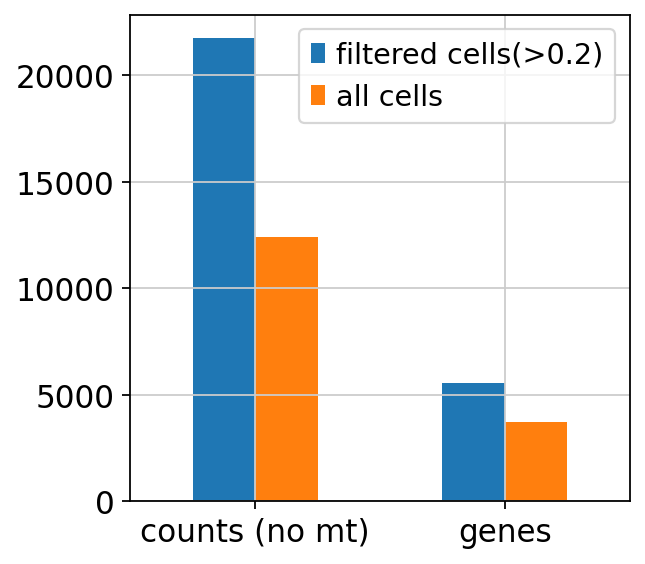

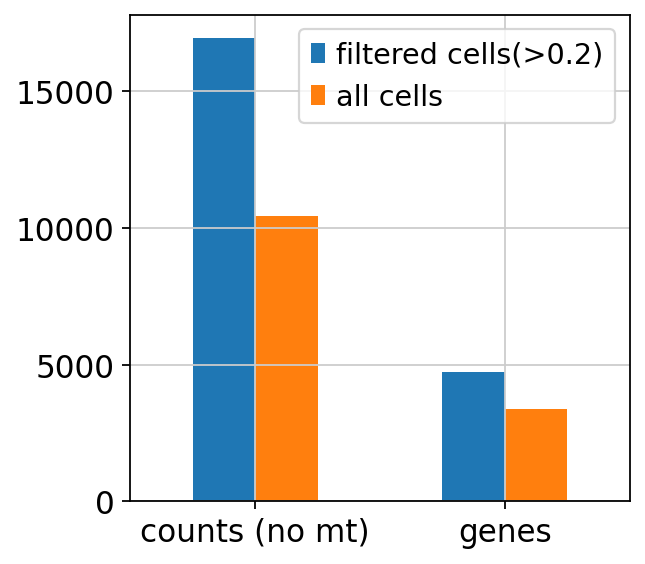

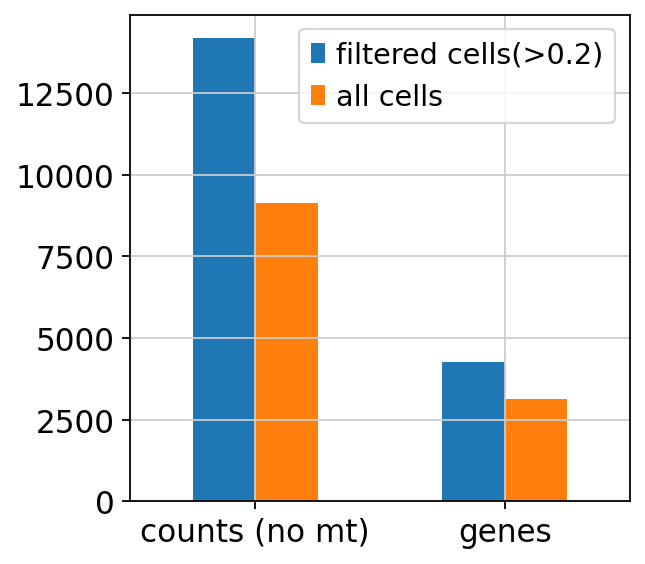

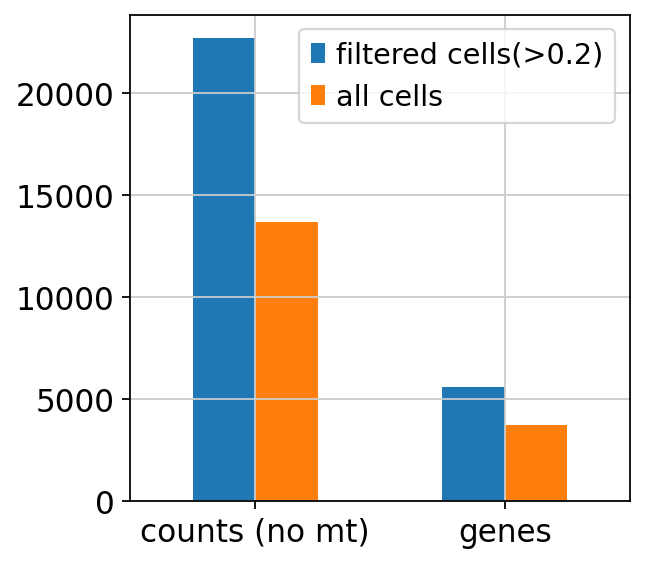

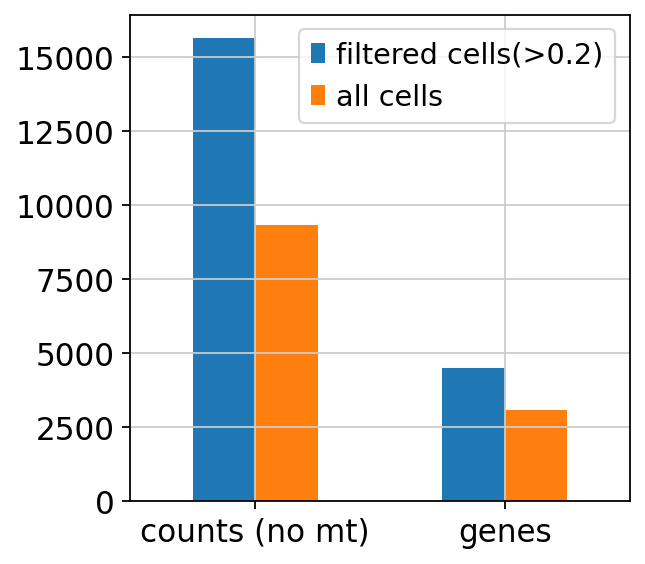

...

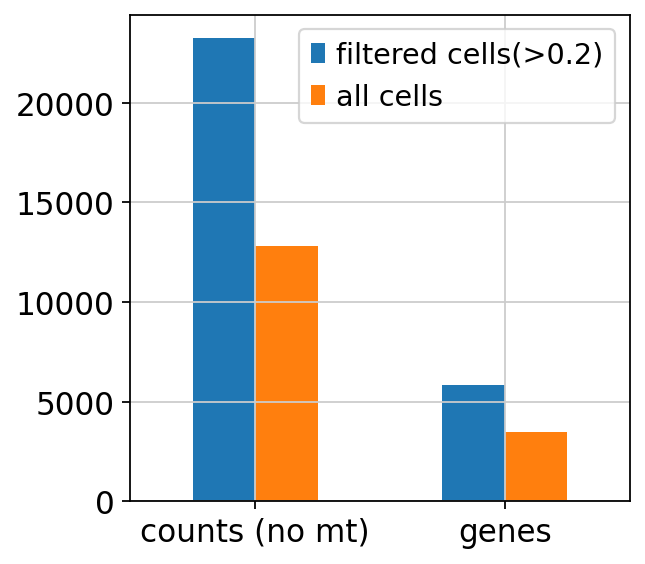

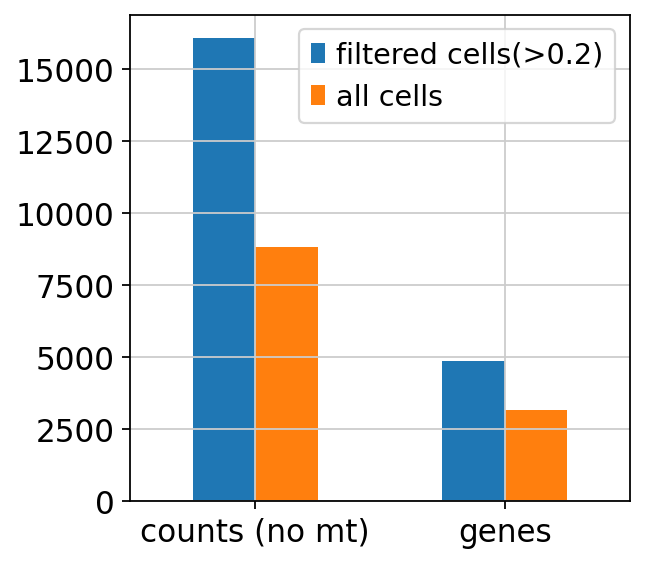

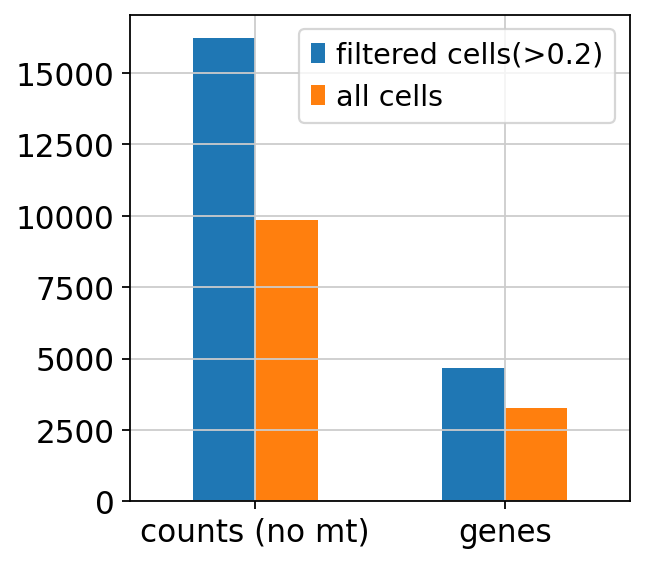

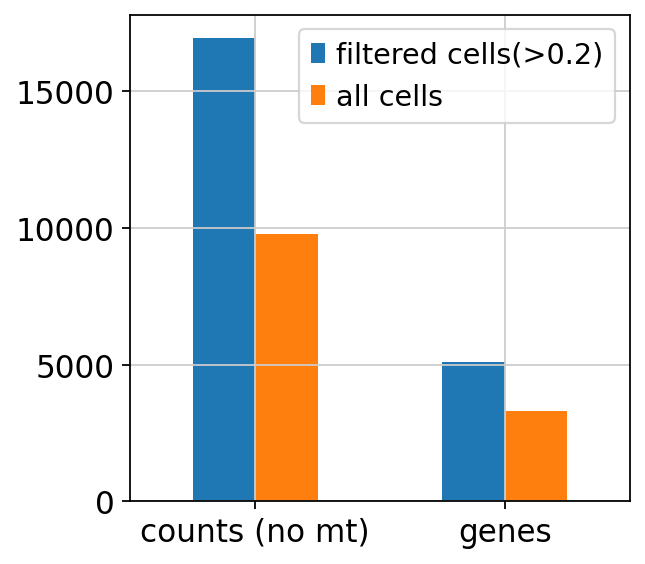

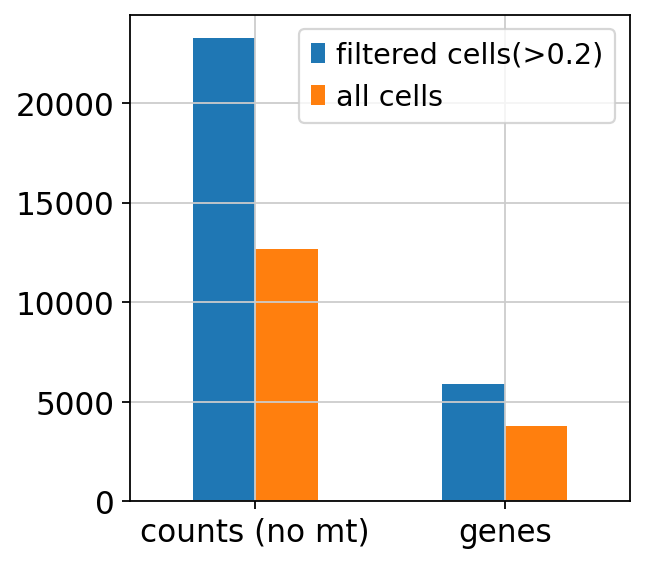

In [12]:
thr =[0.2 for i in range(numberobj)]
for i in range(numberobj):
    mean_counts_high = int(np.mean(locals()[object_names_preprocessed[i]].obs[locals()[object_names_preprocessed[i]].obs['doublet_score'] > thr[i]]['total_counts']))
    mean_genes_high = int(np.mean(locals()[object_names_preprocessed[i]].obs[locals()[object_names_preprocessed[i]].obs['doublet_score'] >thr[i]]['n_genes']))
    mean_counts = int(np.mean(locals()[object_names_preprocessed[i]].obs['total_counts']))
    mean_genes = int(np.mean(locals()[object_names_preprocessed[i]].obs['n_genes']))
    
    
    filtered_cells = [mean_counts_high,mean_genes_high]
    all_cells = [mean_counts,mean_genes]
    index = ['counts (no mt)', 'genes']
    
    df = pd.DataFrame({f'filtered cells(>{thr[i]})': filtered_cells, 'all cells': all_cells}, index=index)
    ax = df.plot.bar(rot=0)
    
    #print(locals()[object_names[i]].obs[locals()[object_names[i]].obs['doublet_score'] >0.25][['doublet_score','total_counts']])


The automatic thresholds

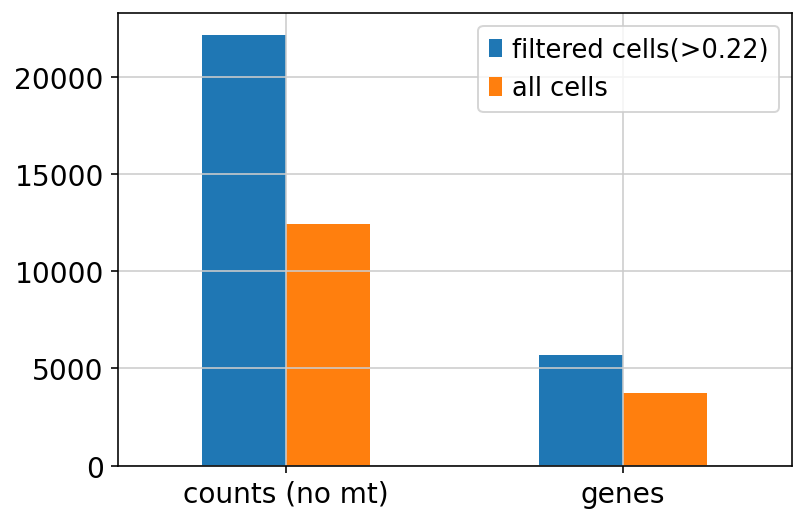

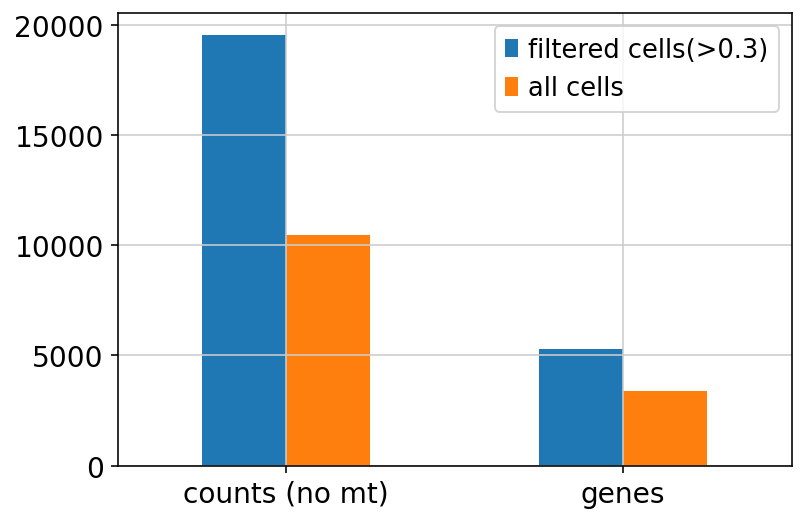

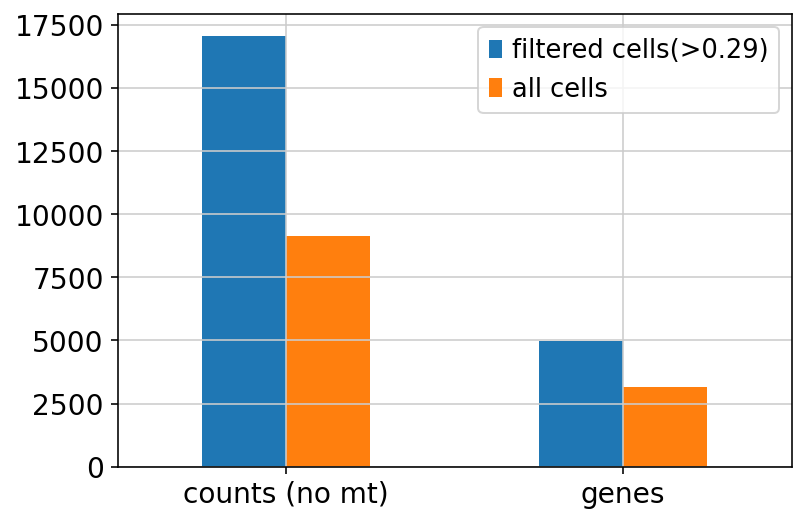

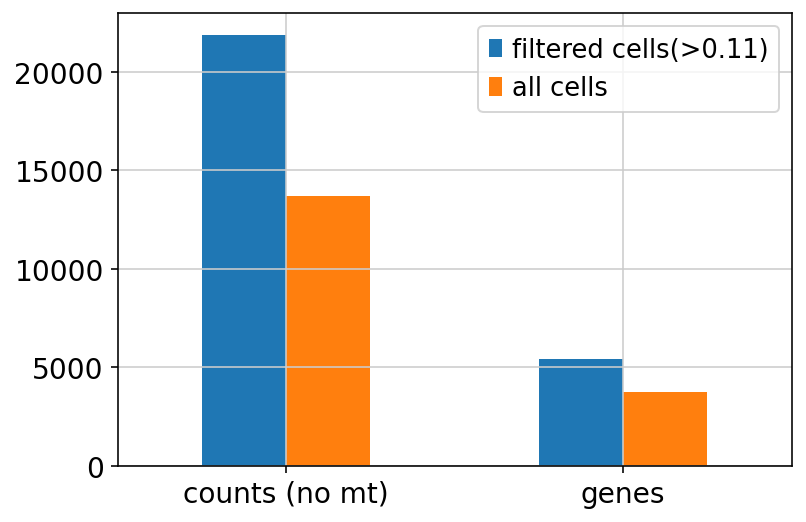

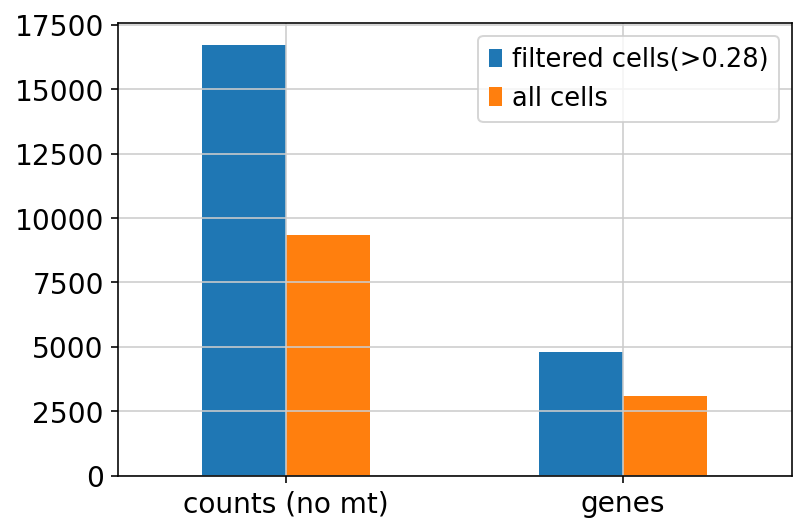

...

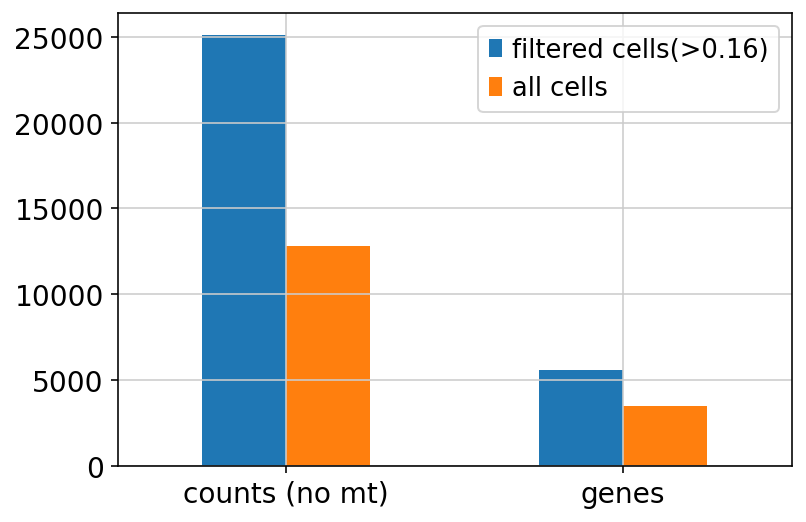

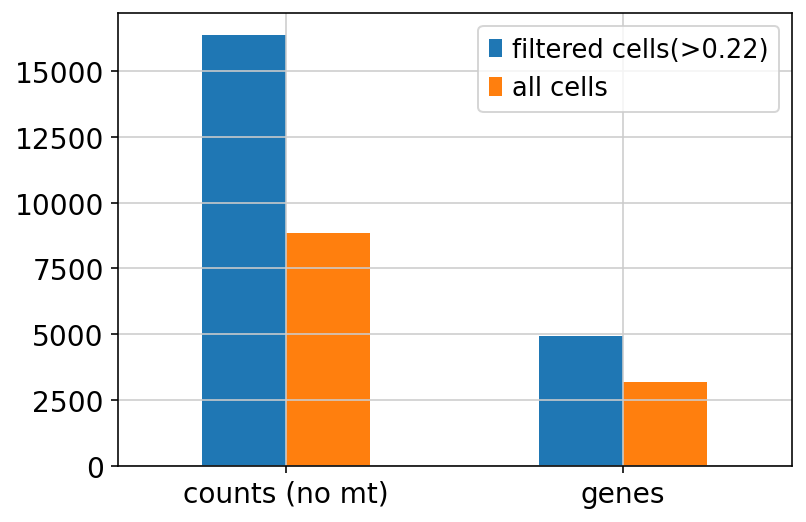

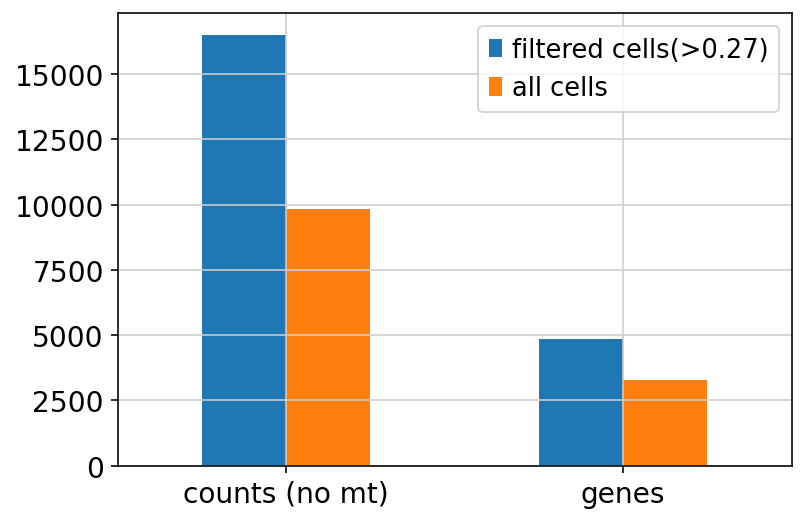

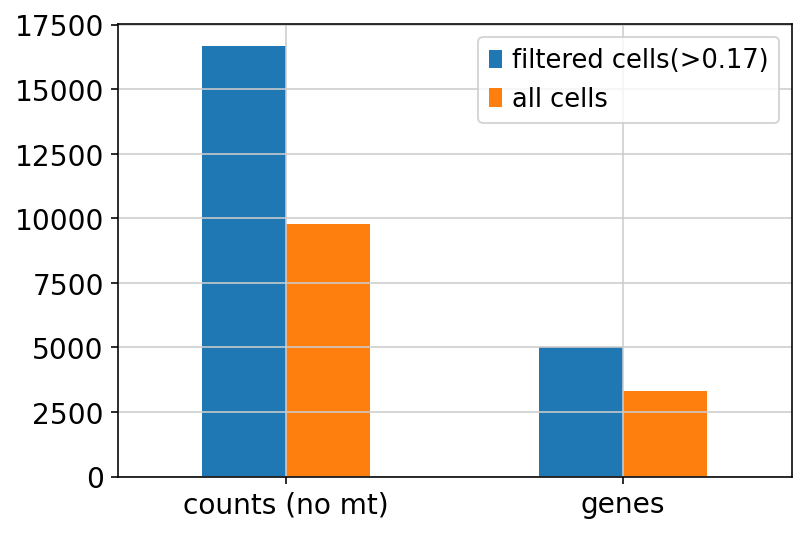

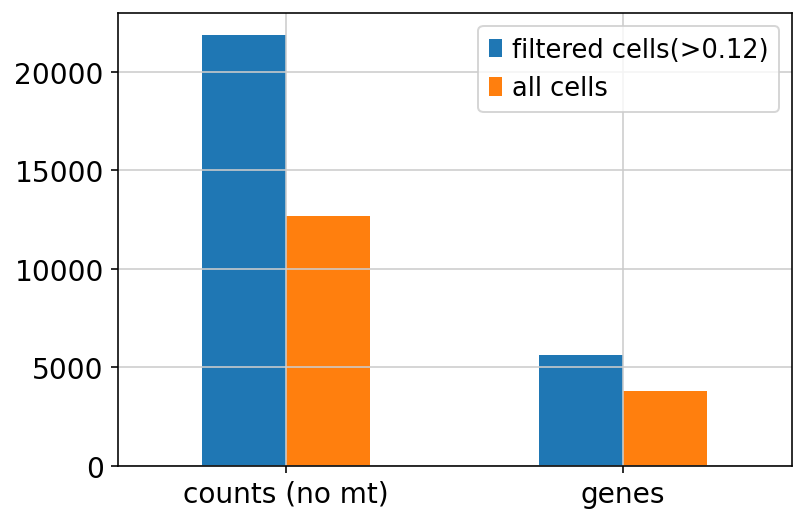

In [43]:
thr =[0.22,0.30,0.29,0.11,0.28,0.22,0.25,0.16,0.22,0.27,0.17,0.12]
for i in range(numberobj):
    mean_counts_high = int(np.mean(locals()[object_names_preprocessed[i]].obs[locals()[object_names_preprocessed[i]].obs['predicted_doublet'] == 'True']['total_counts']))
    mean_genes_high = int(np.mean(locals()[object_names_preprocessed[i]].obs[locals()[object_names_preprocessed[i]].obs['predicted_doublet'] == 'True']['n_genes']))
    mean_counts = int(np.mean(locals()[object_names_preprocessed[i]].obs['total_counts']))
    mean_genes = int(np.mean(locals()[object_names_preprocessed[i]].obs['n_genes']))
    
    
    filtered_cells = [mean_counts_high,mean_genes_high]
    all_cells = [mean_counts,mean_genes]
    index = ['counts (no mt)', 'genes']
    
    df = pd.DataFrame({f'filtered cells(>{thr[i]})': filtered_cells, 'all cells': all_cells}, index=index)
    ax = df.plot.bar(rot=0)
    
    #print(locals()[object_names[i]].obs[locals()[object_names[i]].obs['doublet_score'] >0.25][['doublet_score','total_counts']])


In [13]:
np.random.seed(41)
%matplotlib inline

normalize samples to compare

In [14]:

for i in range(numberobj):
    locals()['test_'+names[i]]=locals()[object_names_preprocessed[i]].copy()
    
    sc.pp.normalize_total(locals()['test_'+names[i]], key_added='total_counts_norm')
    locals()['test_'+names[i]].raw = locals()['test_'+names[i]].copy()
    sc.pp.log1p(locals()['test_'+names[i]])
    print('test_',names[i], ' has been normalized and logarithmized')
    
    sc.tl.pca(locals()['test_'+names[i]], svd_solver='arpack')
    
    

test_ g004  has been normalized and logarithmized
test_ g005  has been normalized and logarithmized
test_ g011  has been normalized and logarithmized
test_ g012  has been normalized and logarithmized
test_ g013  has been normalized and logarithmized
test_ g014  has been normalized and logarithmized
test_ g015  has been normalized and logarithmized
test_ g016  has been normalized and logarithmized
test_ g017  has been normalized and logarithmized
test_ g018  has been normalized and logarithmized
test_ g019  has been normalized and logarithmized
test_ g020  has been normalized and logarithmized


In [16]:
nn=15
for i in range(numberobj):
    print('test_',names[i], ': done')
    sc.pp.neighbors(locals()['test_'+names[i]], n_neighbors=nn, n_pcs=40)
    sc.tl.umap(locals()['test_'+names[i]])
    
    

test_ g004 : done
test_ g005 : done
test_ g011 : done
test_ g012 : done
test_ g013 : done
test_ g014 : done
test_ g015 : done
test_ g016 : done
test_ g017 : done
test_ g018 : done
test_ g019 : done
test_ g020 : done


g004


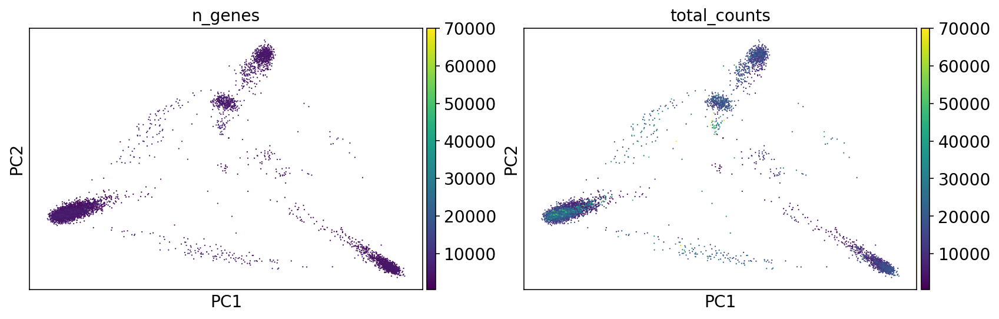

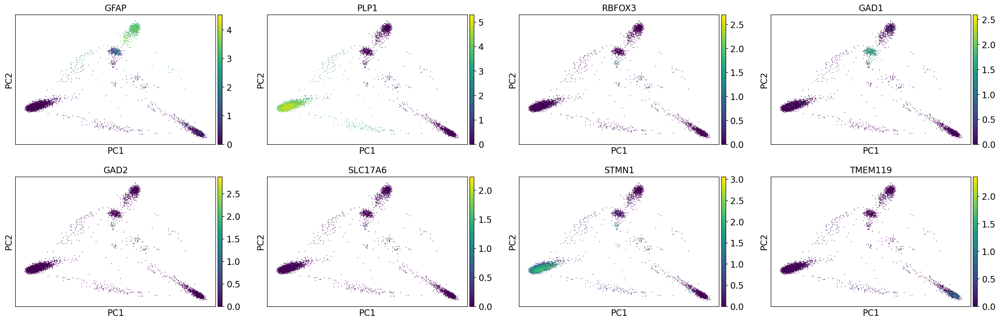

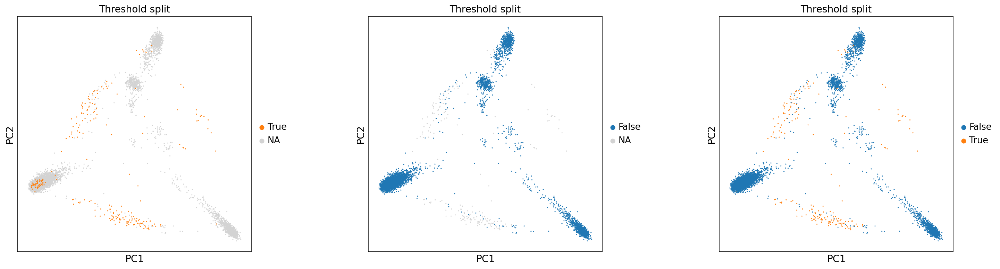

g005


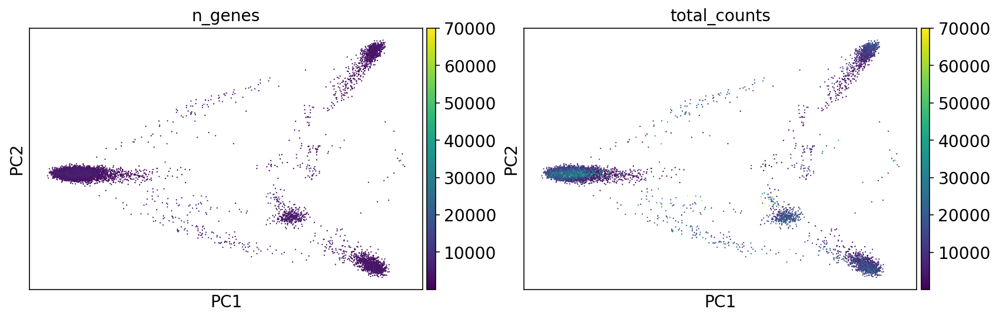

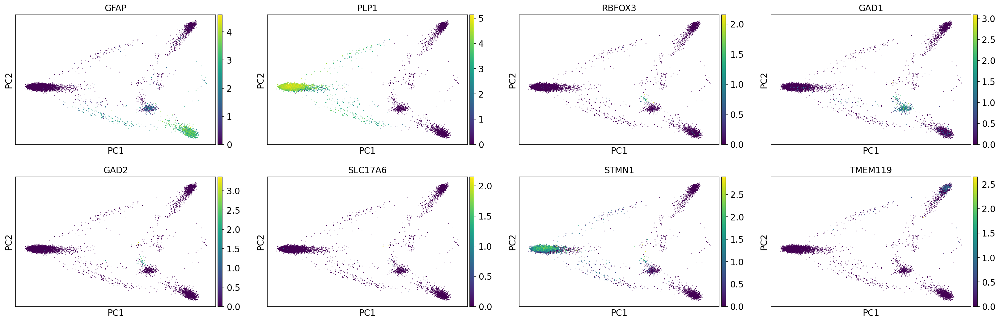

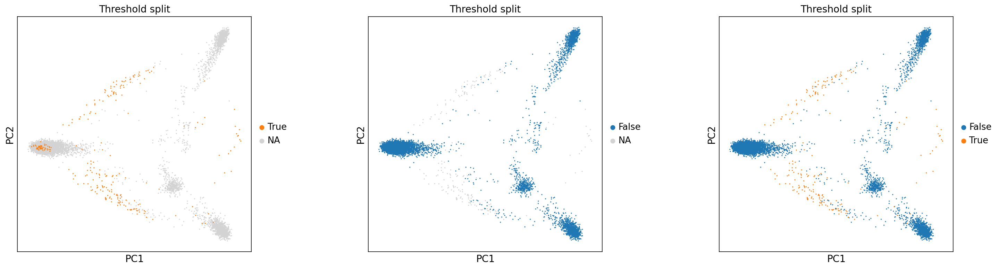

g011


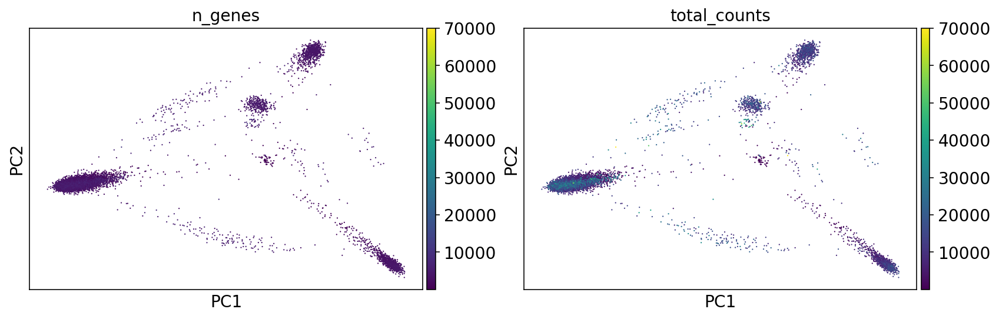

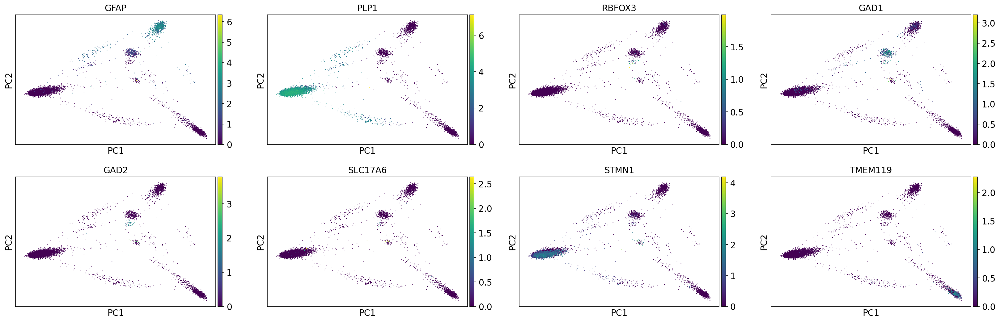

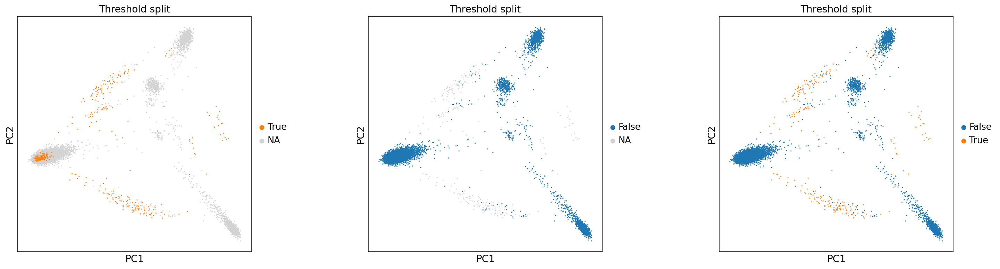

g012


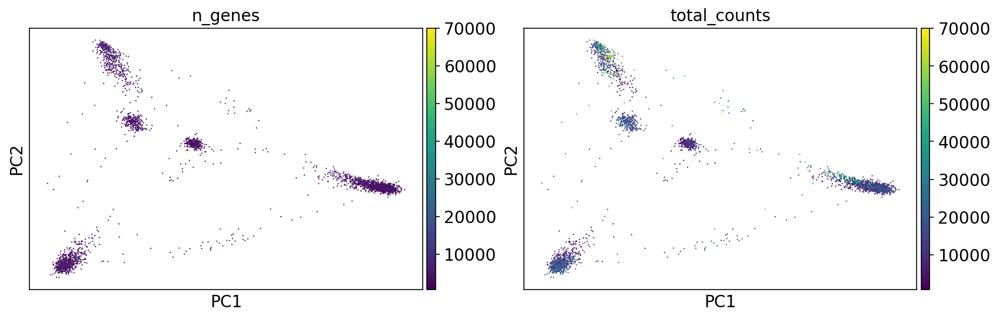

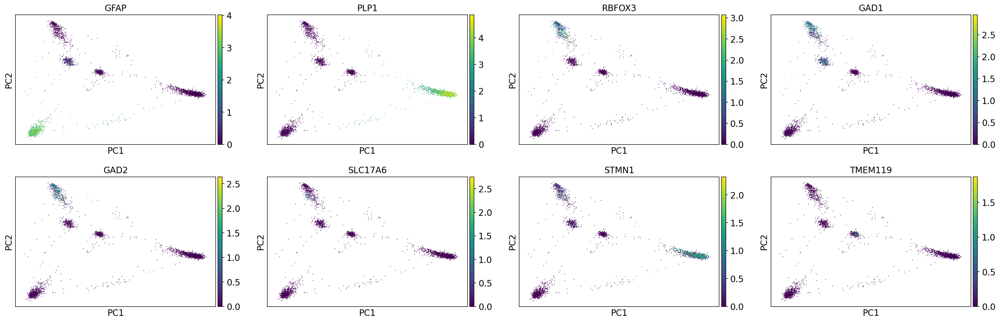

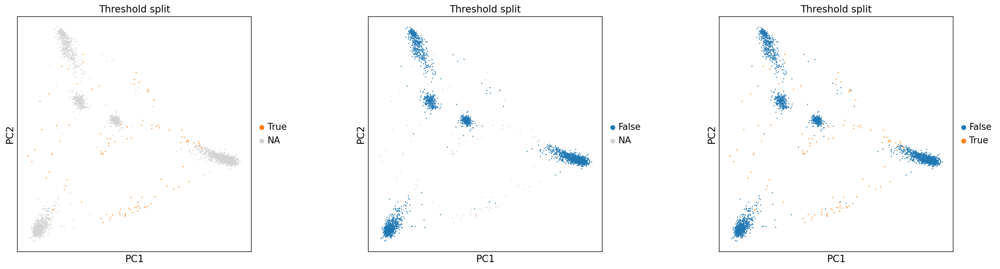

g013


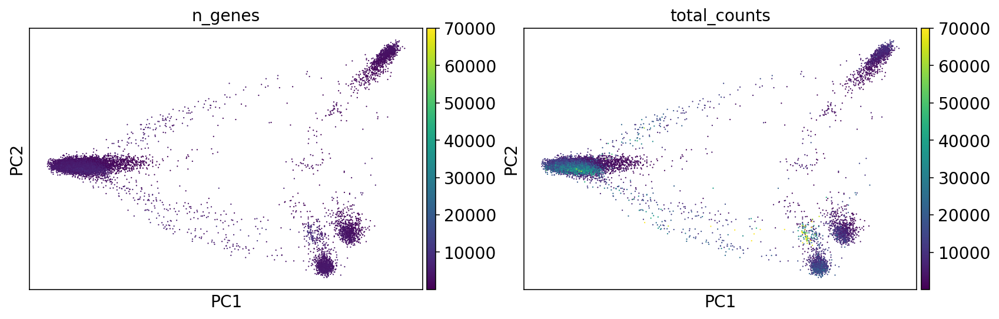

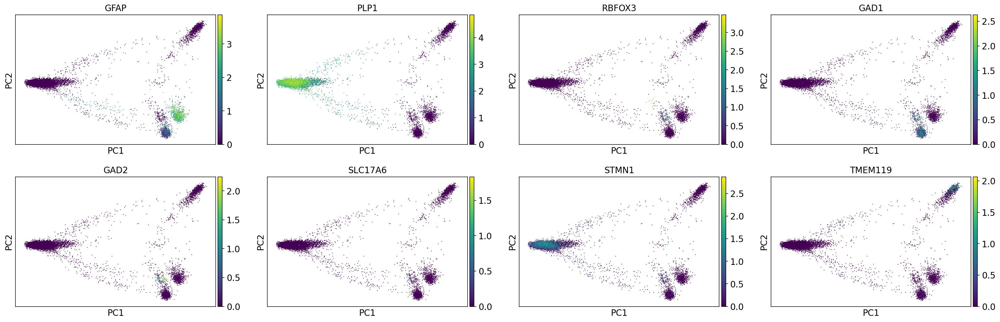

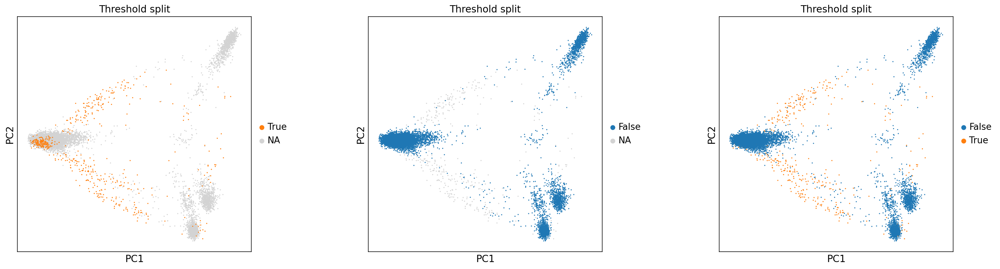

g014


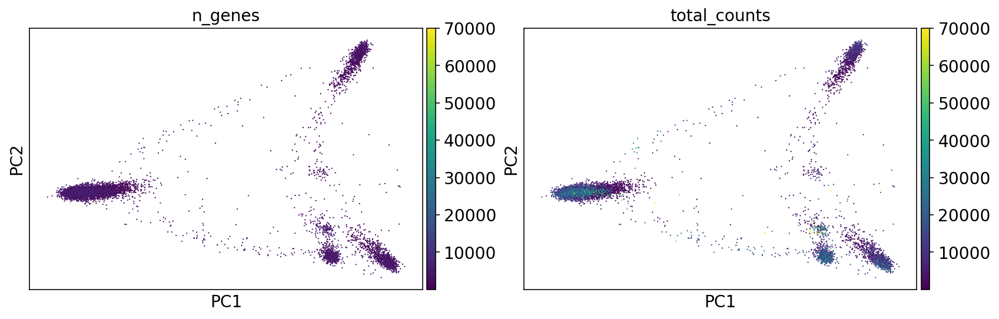

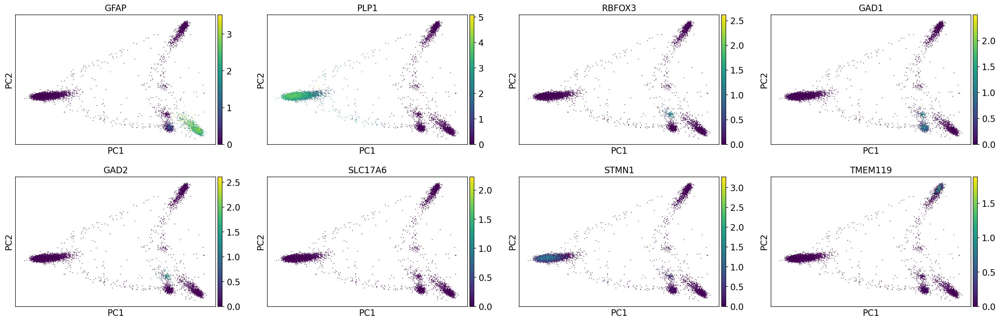

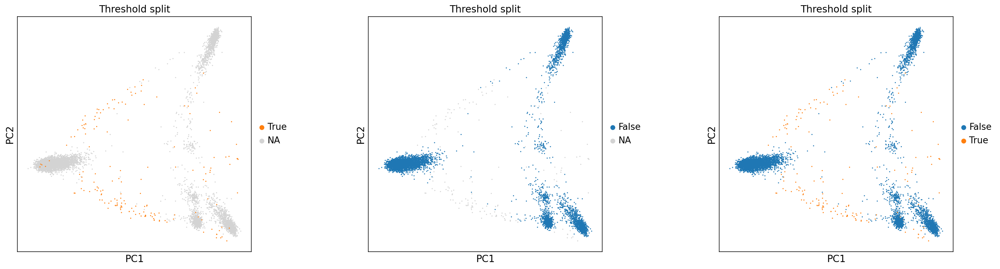

g015


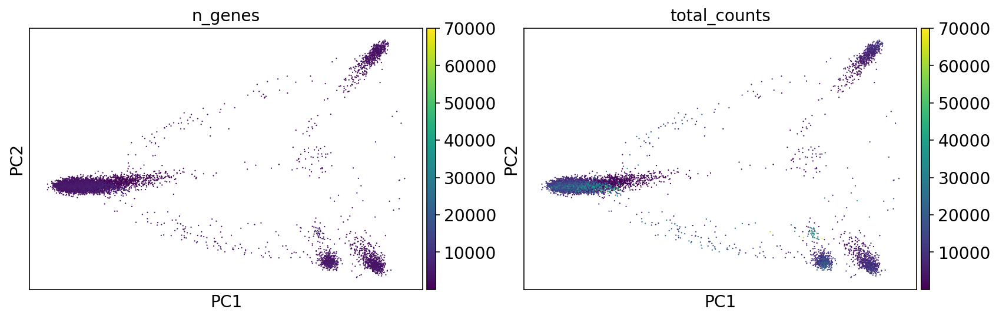

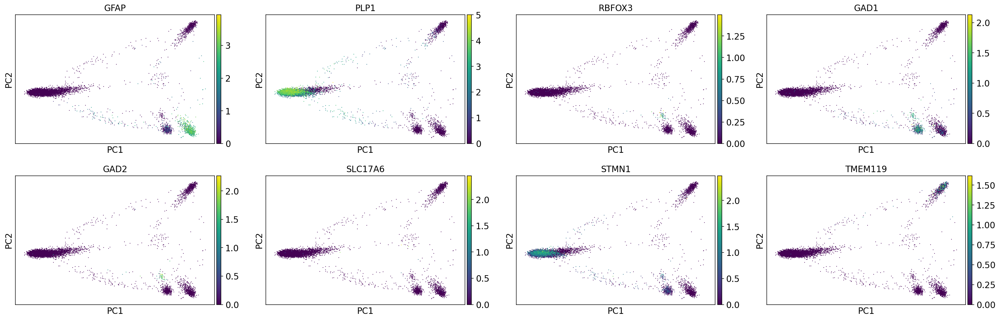

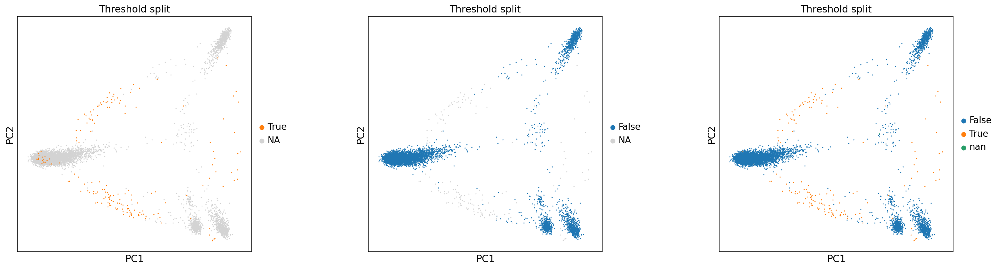

g016


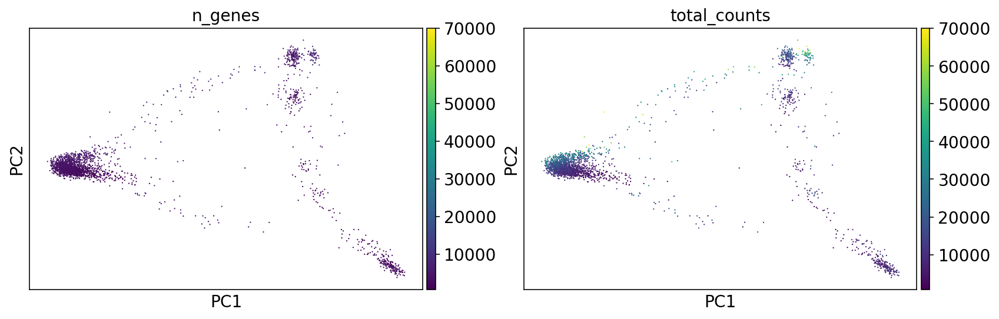

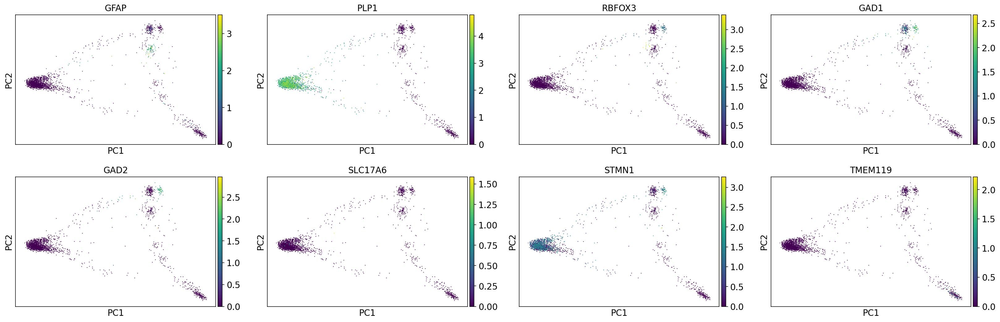

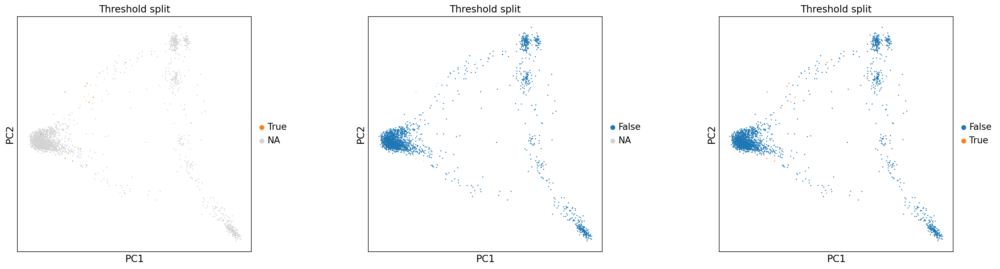

g017


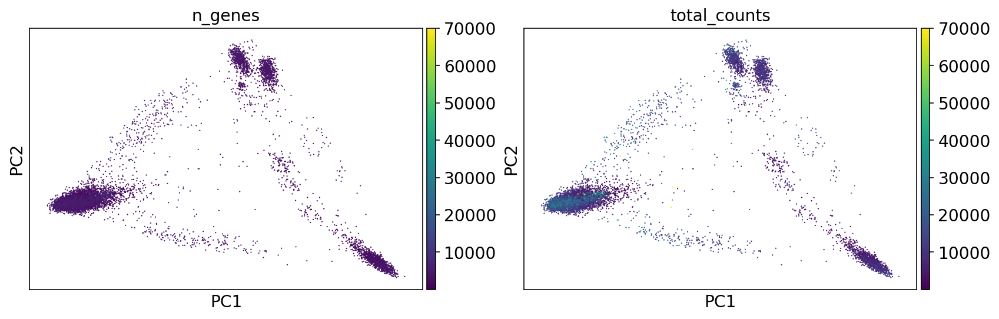

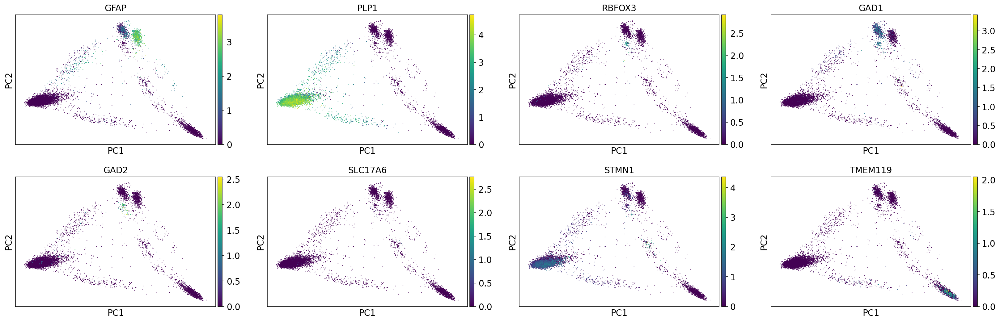

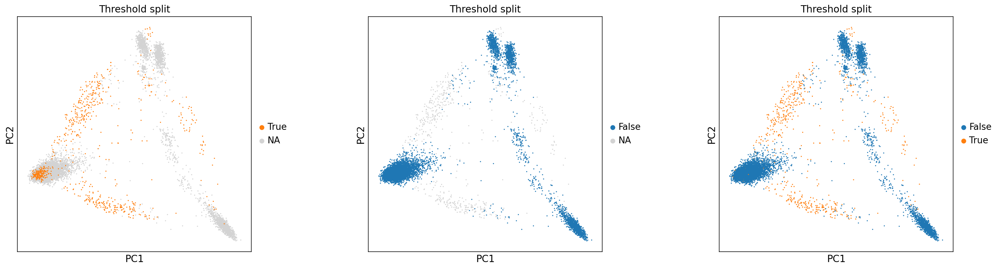

g018


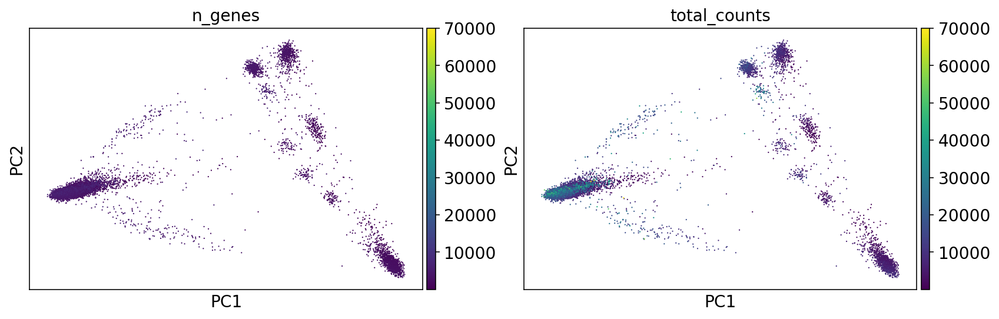

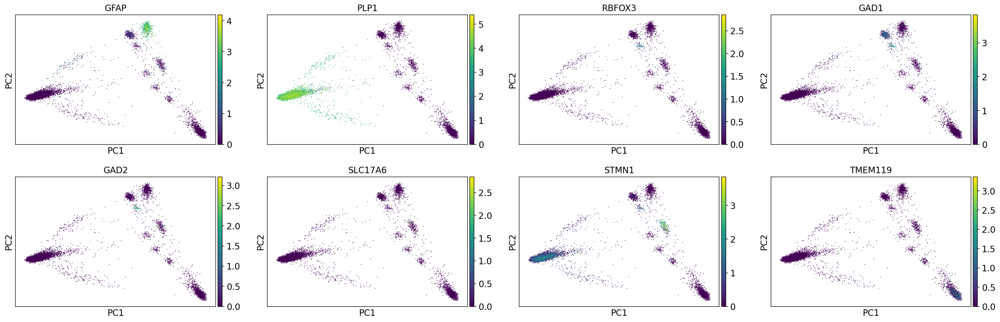

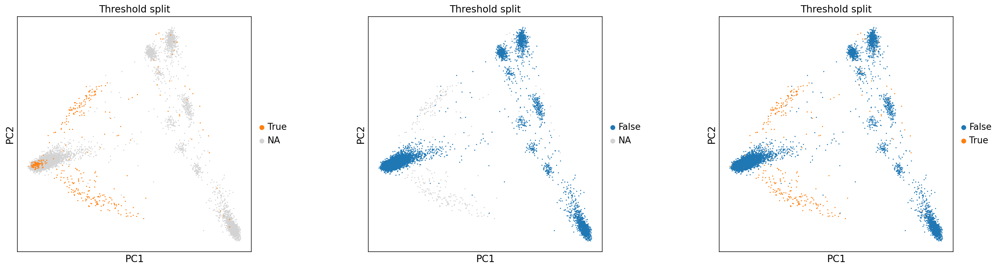

g019


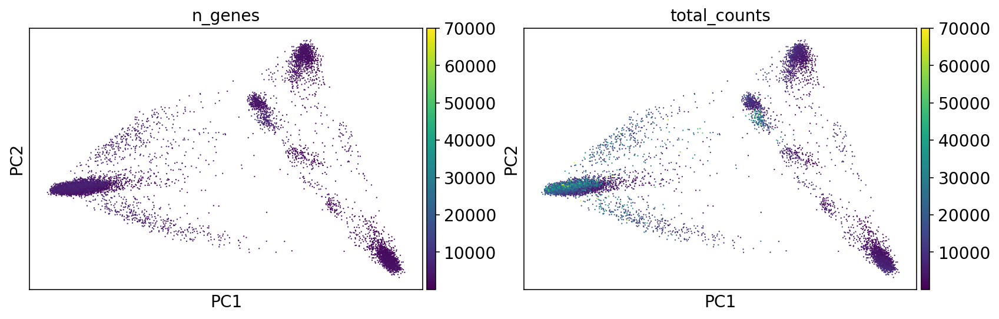

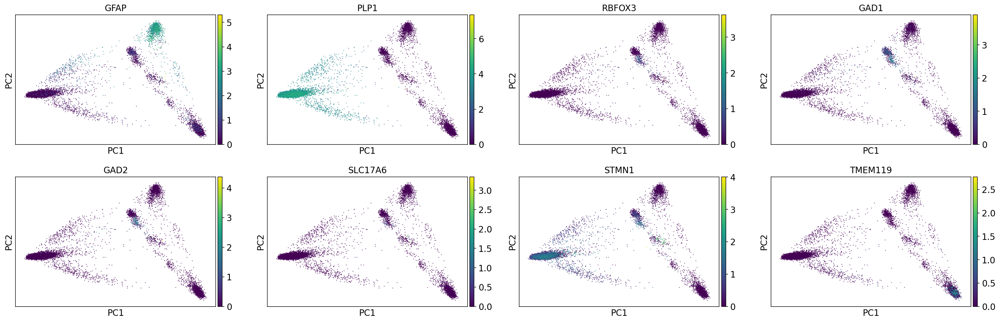

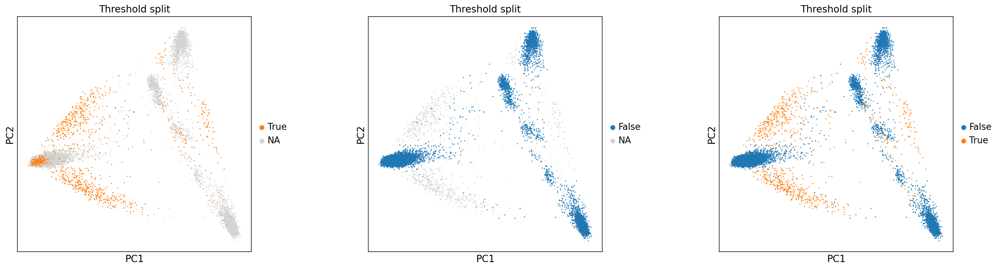

g020


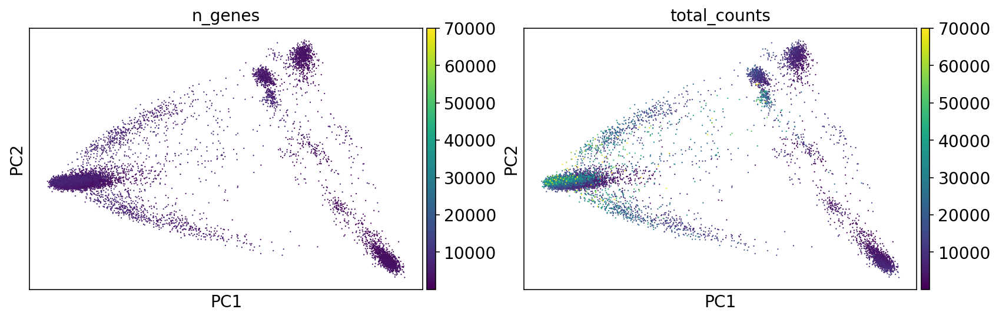

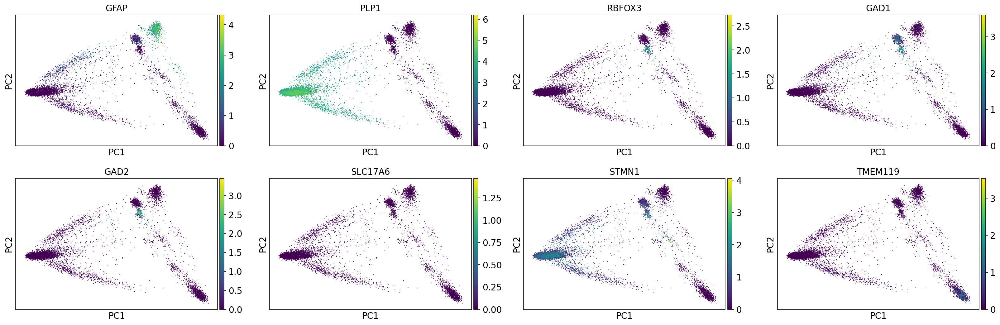

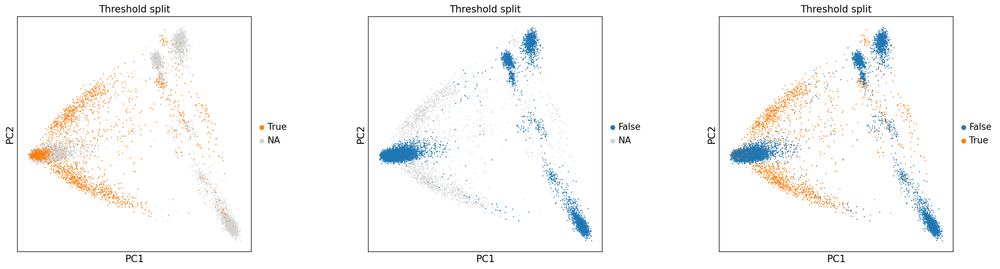

In [39]:
for i in range(numberobj):
    print(names[i])
    
    sc.pl.pca(locals()['test_'+names[i]], color=['n_genes', 'total_counts'],s=5,vmax=70000)
    sc.pl.pca(locals()['test_'+names[i]], color=['GFAP', 'PLP1', 'RBFOX3','GAD1','GAD2', 'SLC17A6','STMN1','TMEM119'], s=5,use_raw=False)
    
    feature= 'predicted_doublet'
    group1= 'True'
    group2= 'False'
    fig, axs = plt.subplots(1, 3, figsize =[24,6])
    #axs[-1, -1].axis('off')
    fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.5, hspace=0.5)
    sc.pl.pca(locals()['test_'+names[i]], color=feature, groups= group1, use_raw=False, s=10, ax= axs[0],show=False, title='Threshold split')
    sc.pl.pca(locals()['test_'+names[i]], color=feature, groups= group2, use_raw=False, s=10, ax= axs[1],show=False, title='Threshold split')
    sc.pl.pca(locals()['test_'+names[i]], color=feature, use_raw=False, s=10, ax= axs[2],show=False, title='Threshold split')
    plt.show()

g004


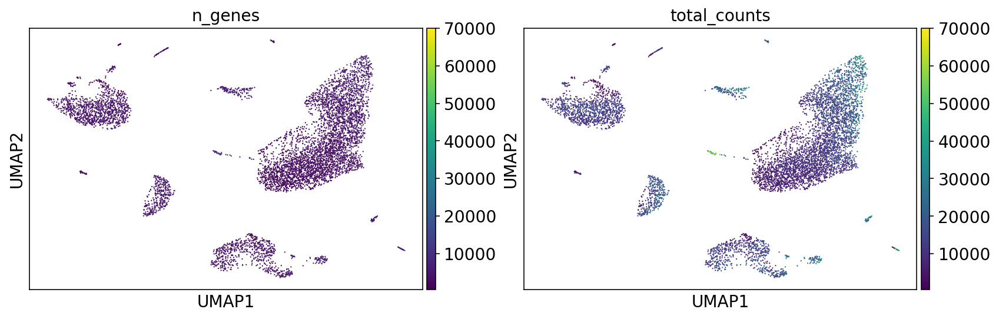

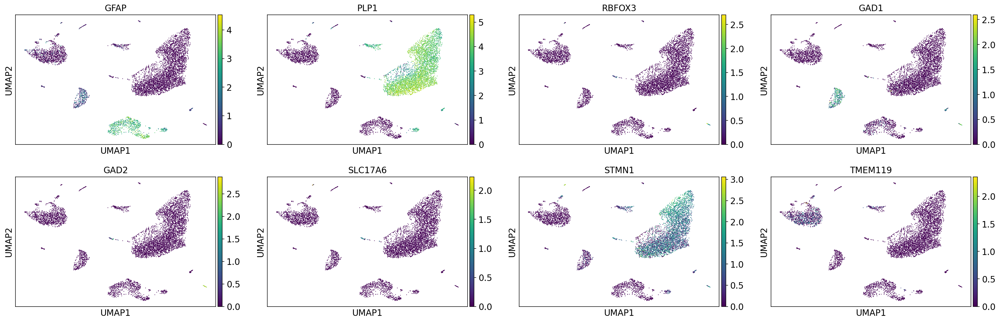

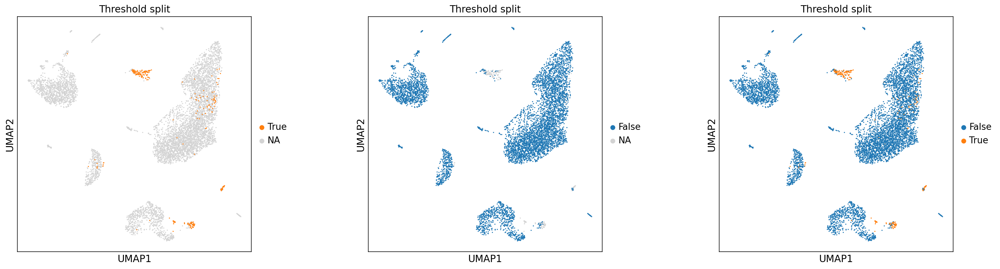

g005


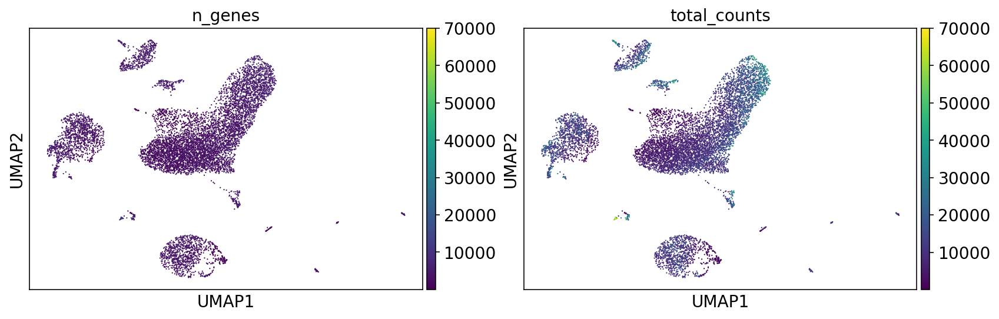

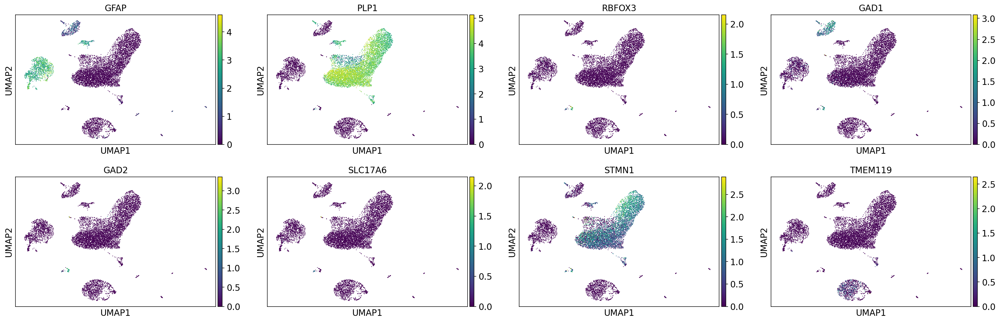

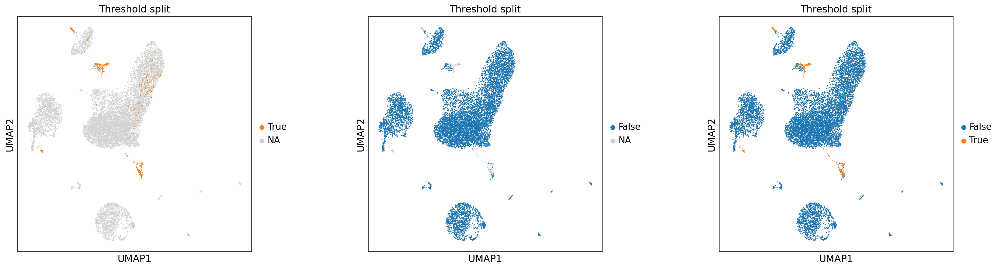

g011


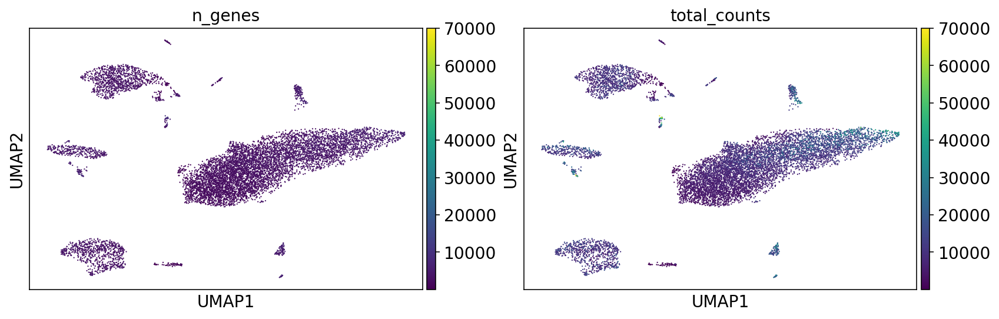

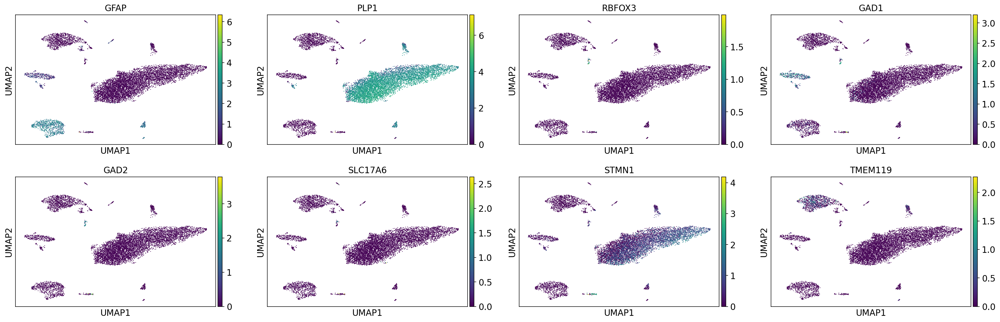

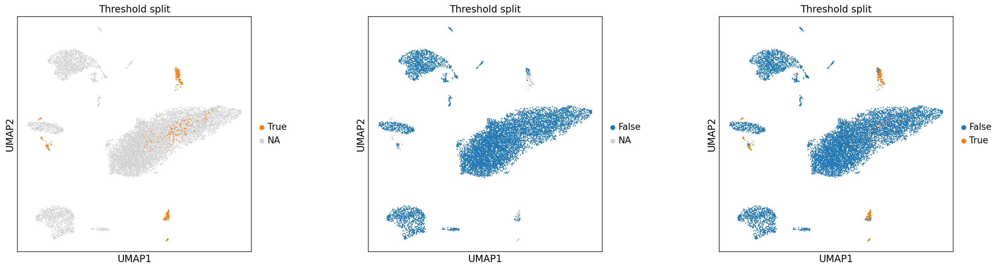

g012


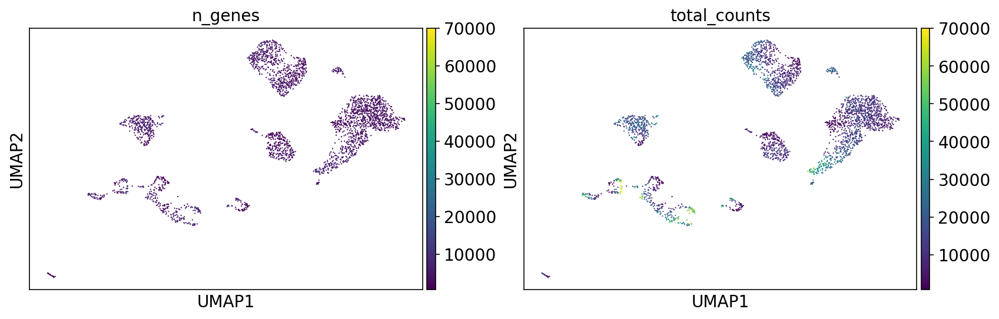

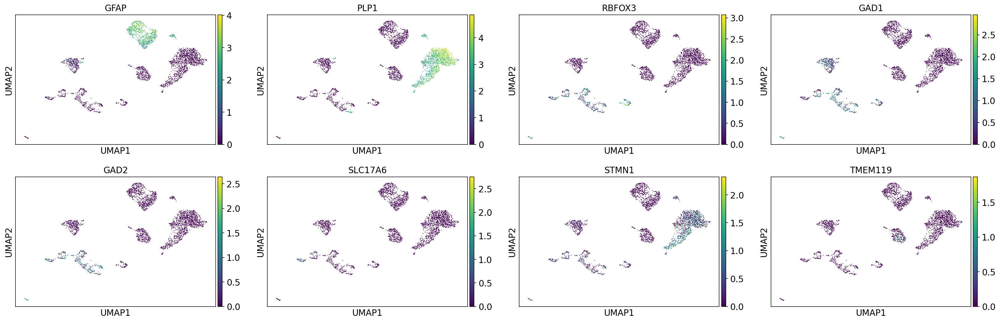

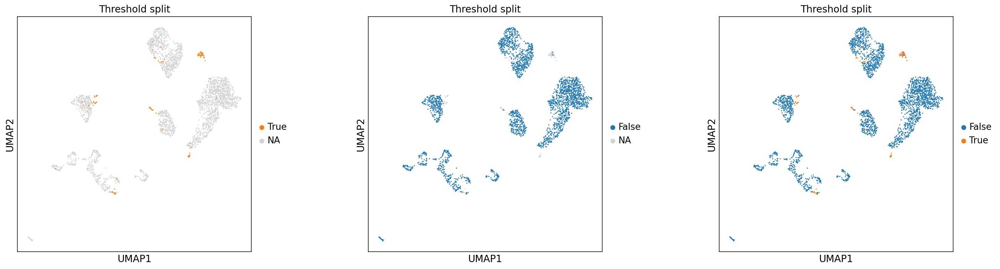

g013


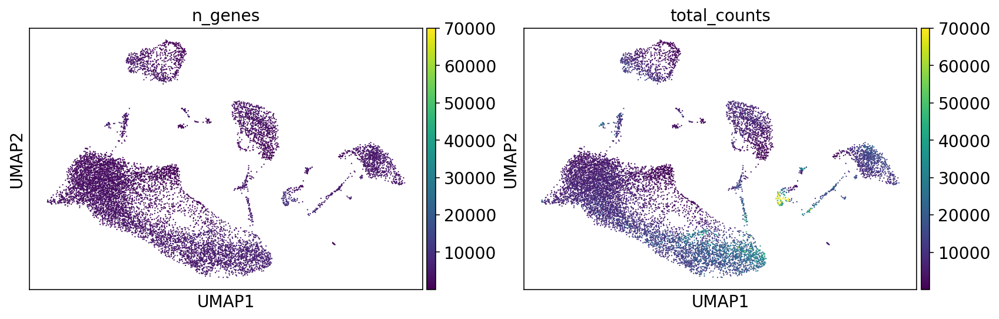

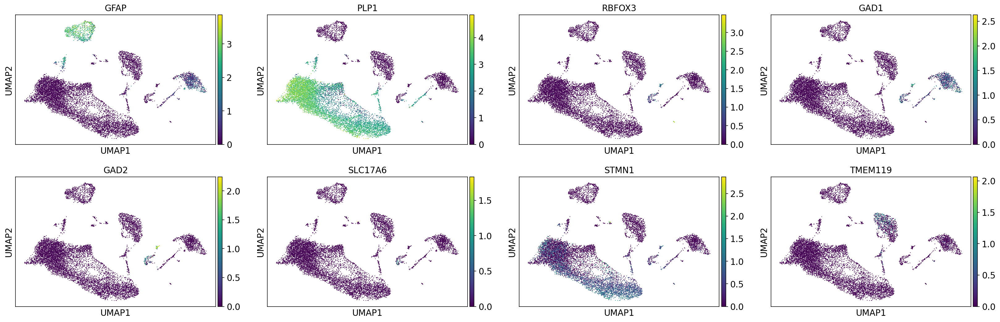

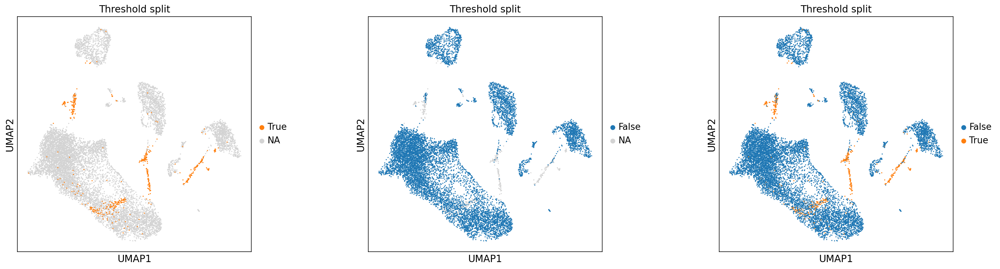

g014


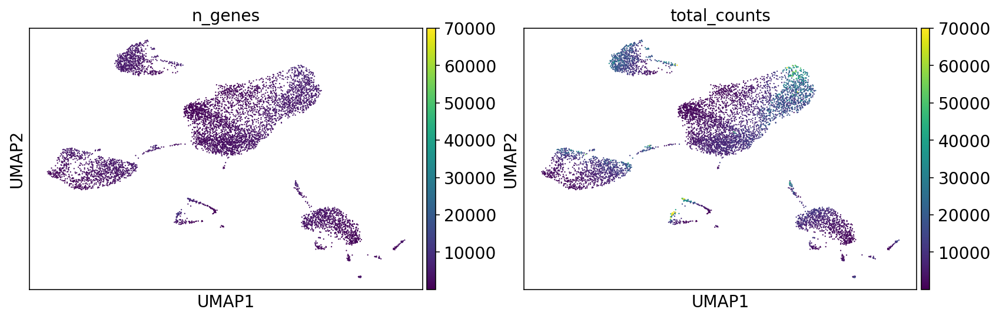

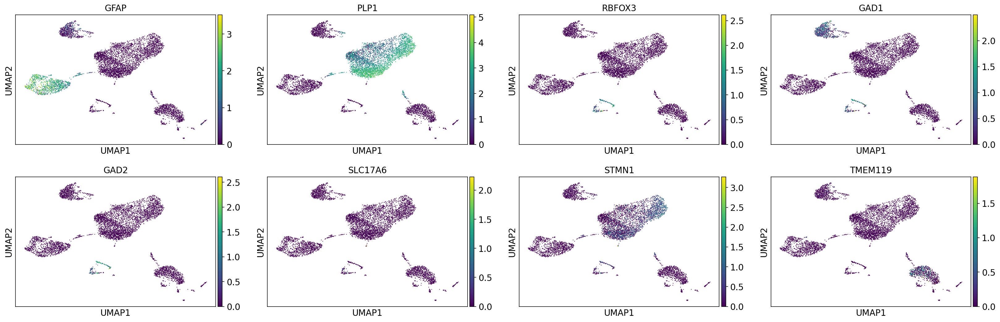

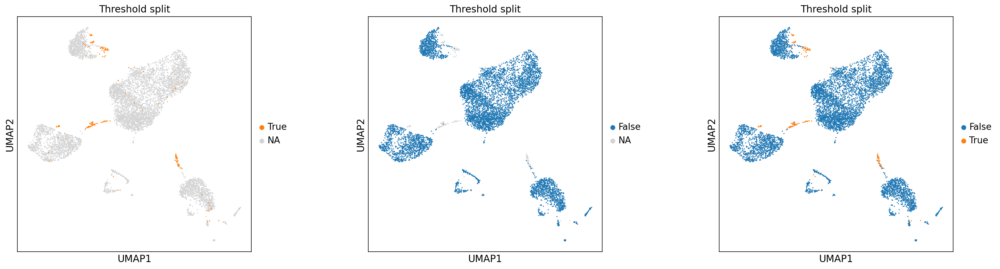

g015


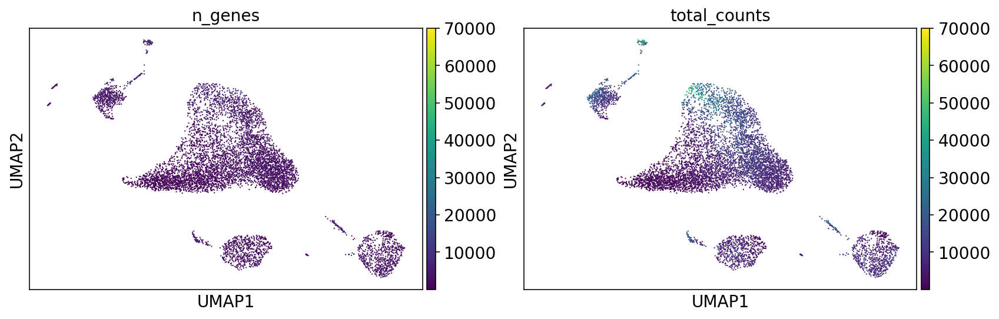

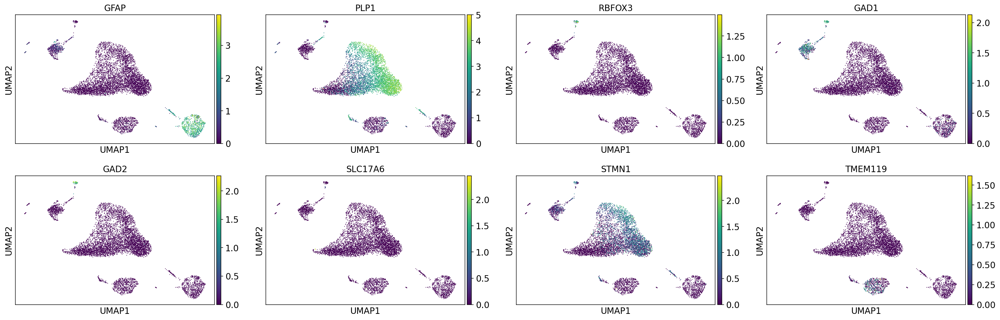

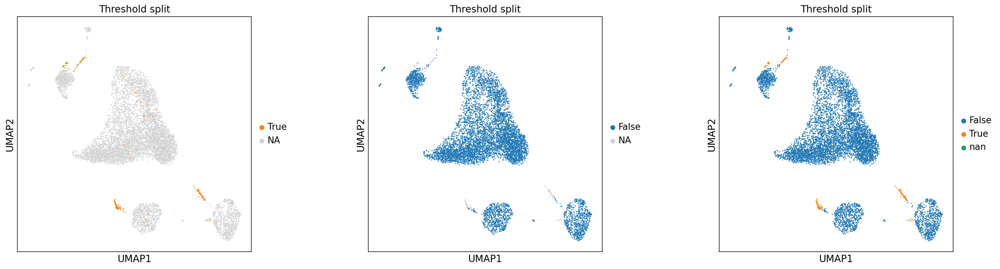

g016


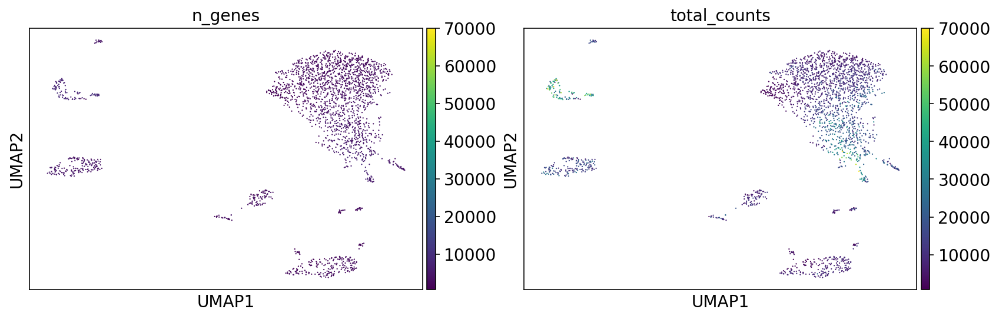

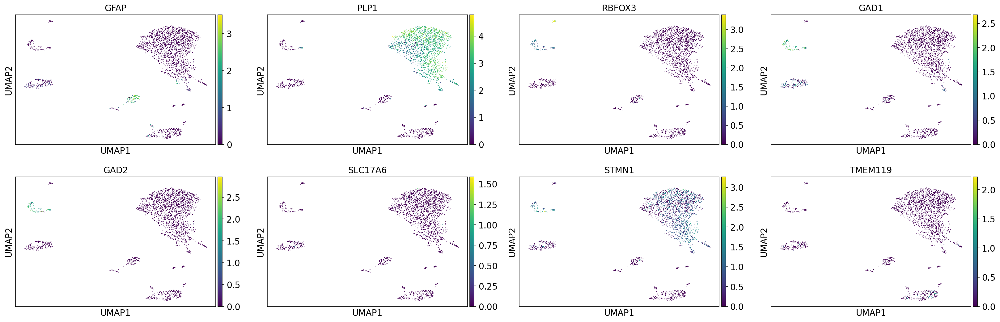

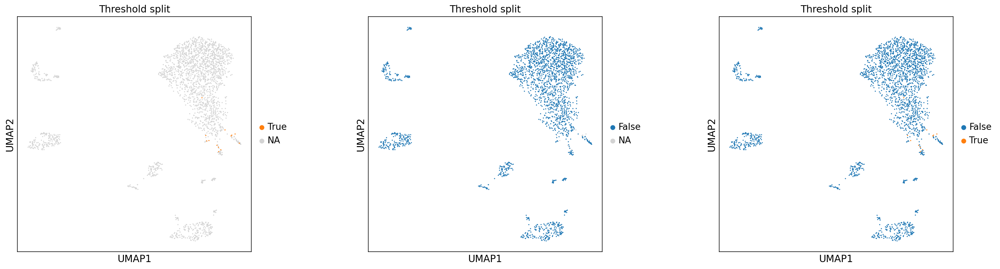

g017


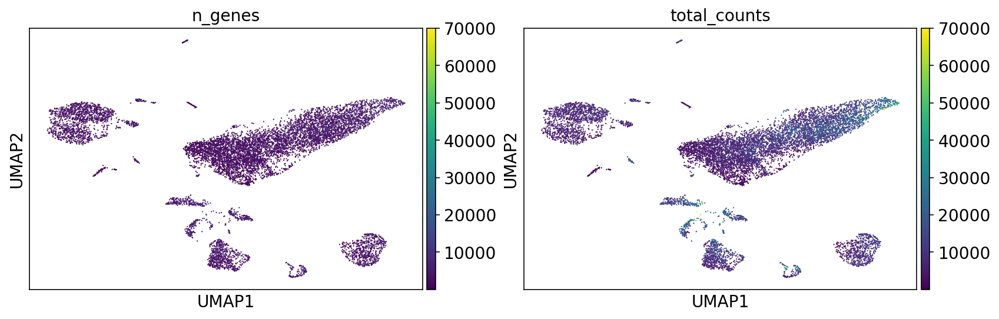

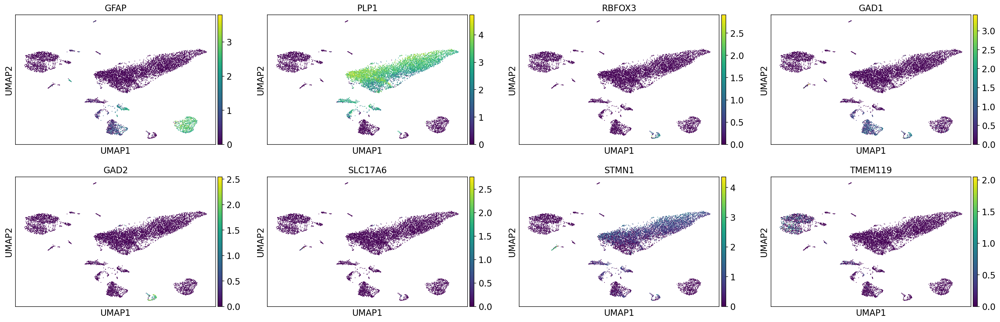

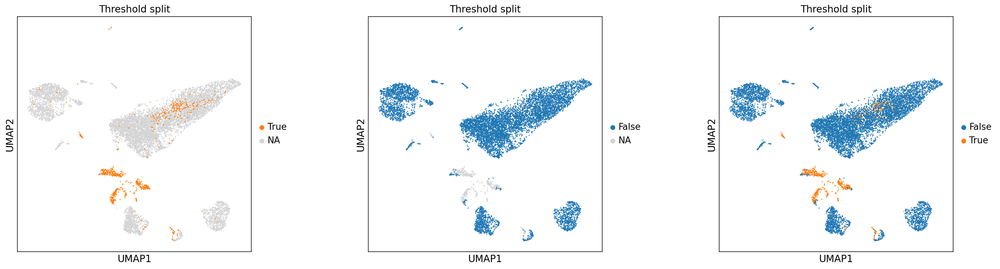

g018


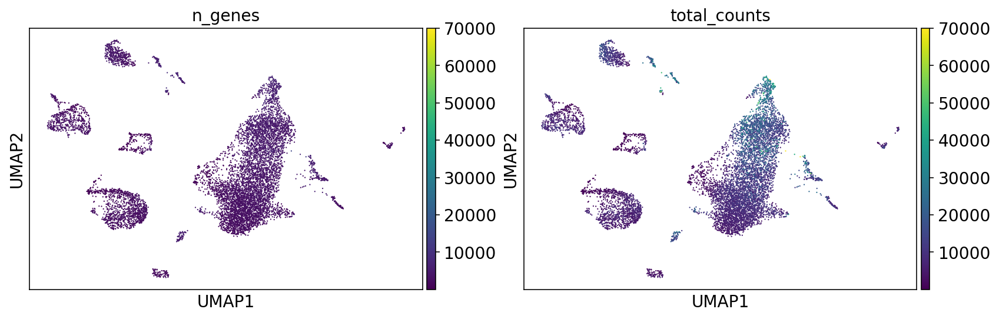

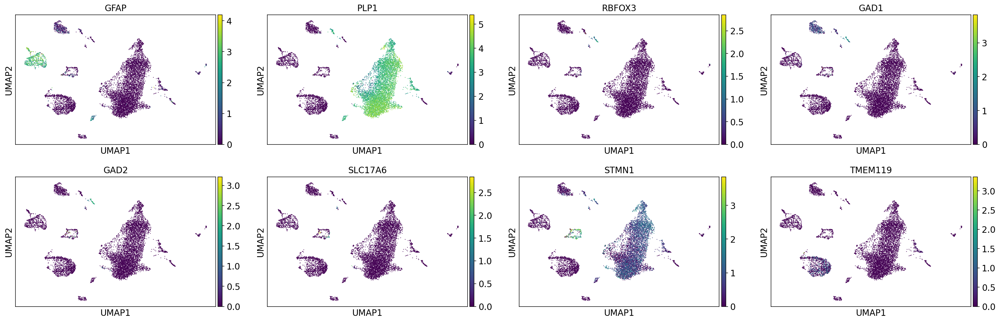

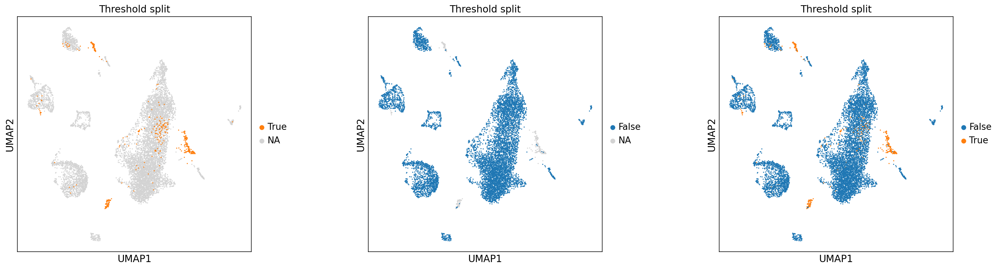

g019


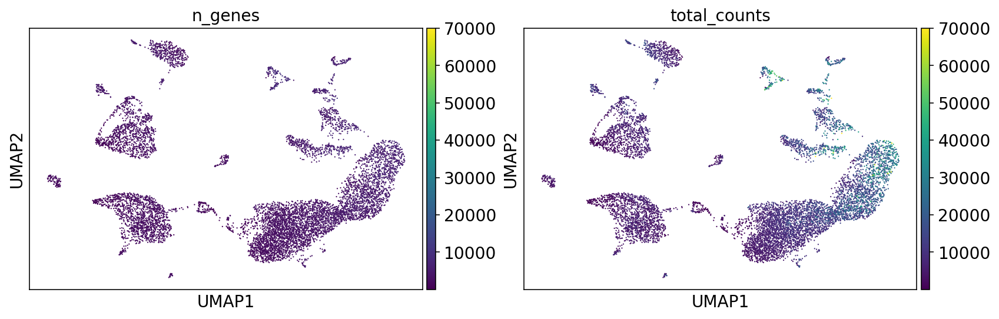

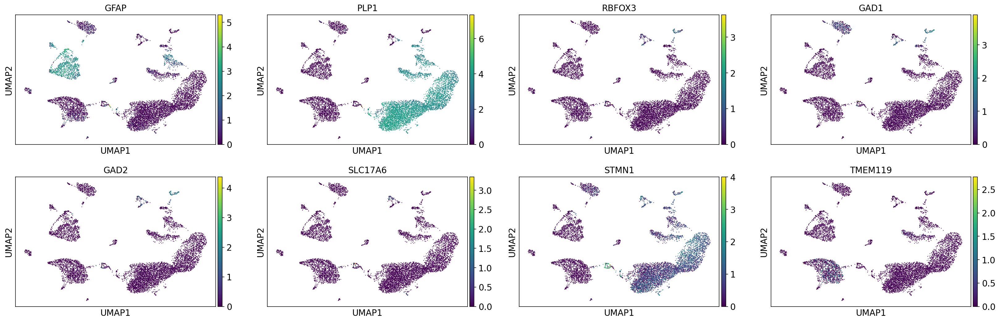

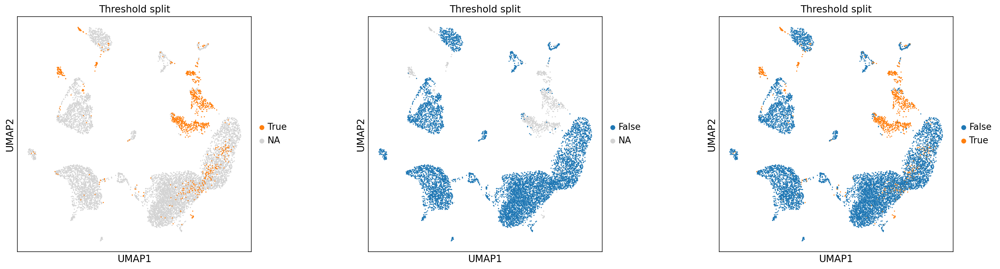

g020


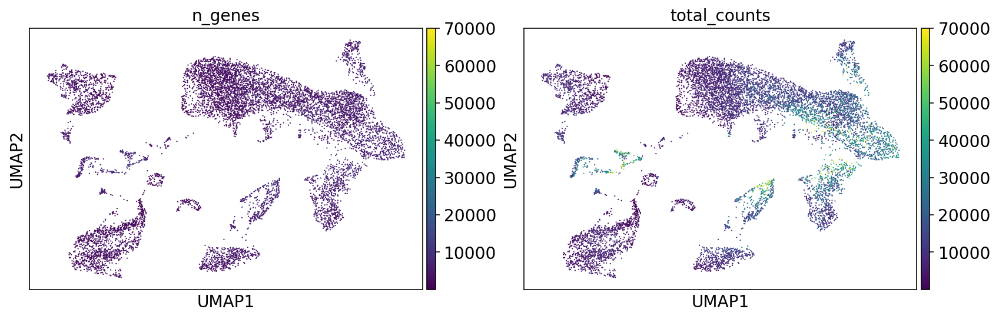

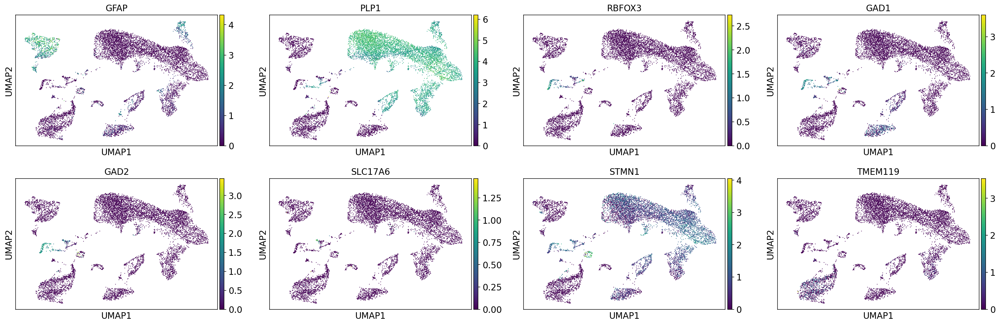

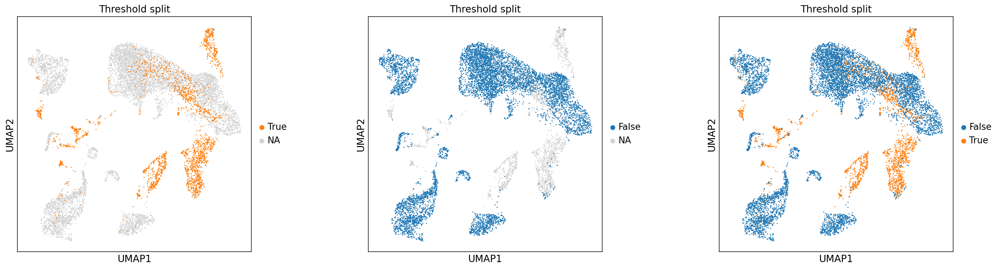

In [44]:

for i in range(numberobj):
    print(names[i])
    
    sc.pl.umap(locals()['test_'+names[i]], color=['n_genes', 'total_counts'],s=5,vmax=70000)
    sc.pl.umap(locals()['test_'+names[i]], color=['GFAP', 'PLP1', 'RBFOX3','GAD1','GAD2', 'SLC17A6','STMN1','TMEM119'], s=5,use_raw=False)
    
    feature= 'predicted_doublet'
    group1= 'True'
    group2= 'False'
    fig, axs = plt.subplots(1, 3, figsize =[24,6])
    #axs[-1, -1].axis('off')
    fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.5, hspace=0.5)
    sc.pl.umap(locals()['test_'+names[i]], color=feature, groups= group1, use_raw=False, s=10, ax= axs[0],show=False, title='Threshold split')
    sc.pl.umap(locals()['test_'+names[i]], color=feature, groups= group2, use_raw=False, s=10, ax= axs[1],show=False, title='Threshold split')
    sc.pl.umap(locals()['test_'+names[i]], color=feature, use_raw=False, s=10, ax= axs[2],show=False, title='Threshold split')
    plt.show()

In [48]:
locals()['test_'+names[0]]

AnnData object with n_obs × n_vars = 6750 × 60619
    obs: 'species', 'atlas', 'sample', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'total_counts_mito', 'total_counts_norm'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'scrublet', 'log1p', 'pca', 'neighbors', 'umap', 'predicted_doublet_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

g004


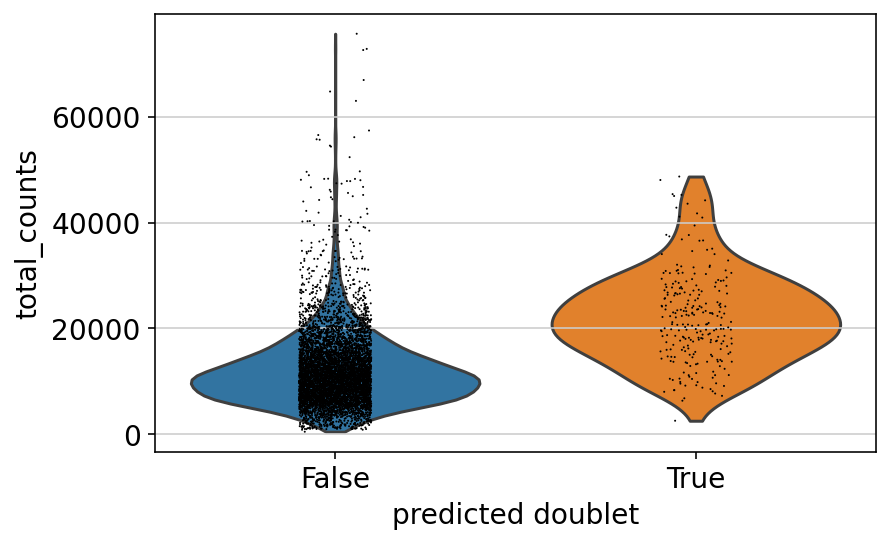

g005


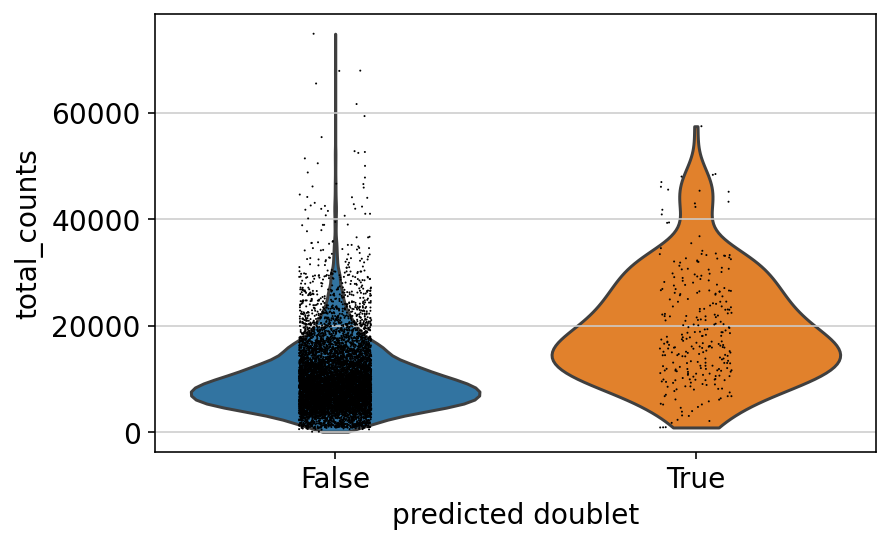

g011


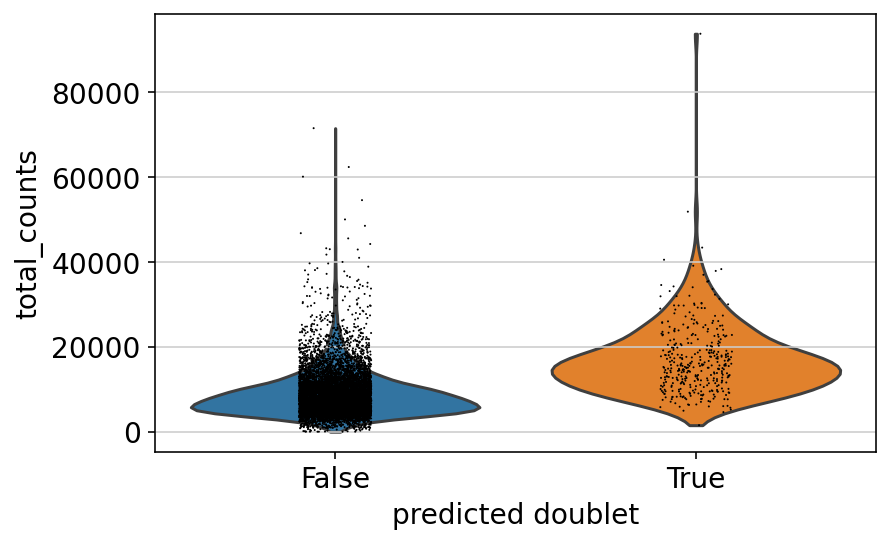

g012


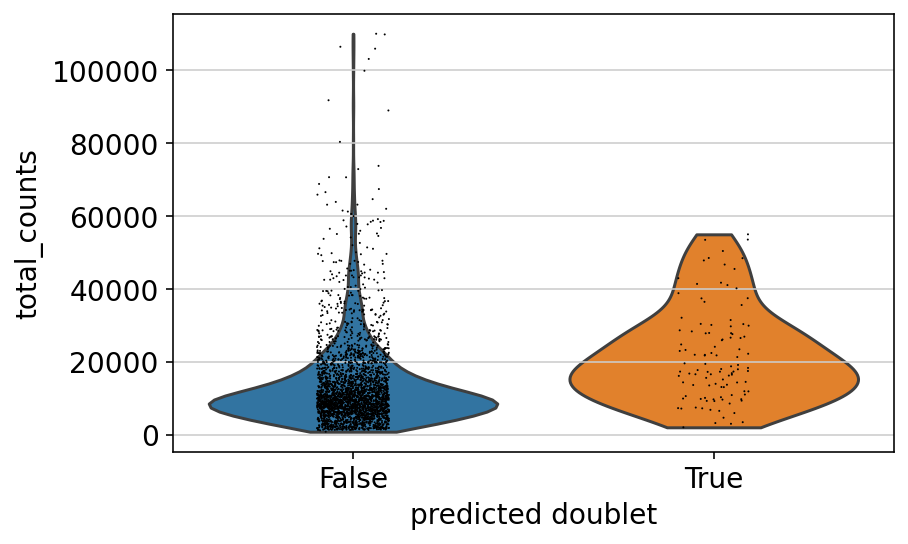

g013


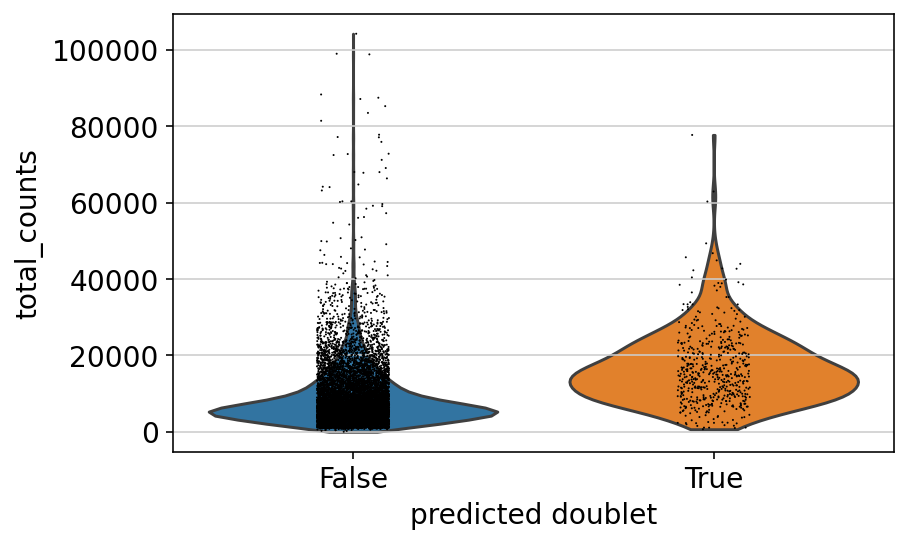

g014


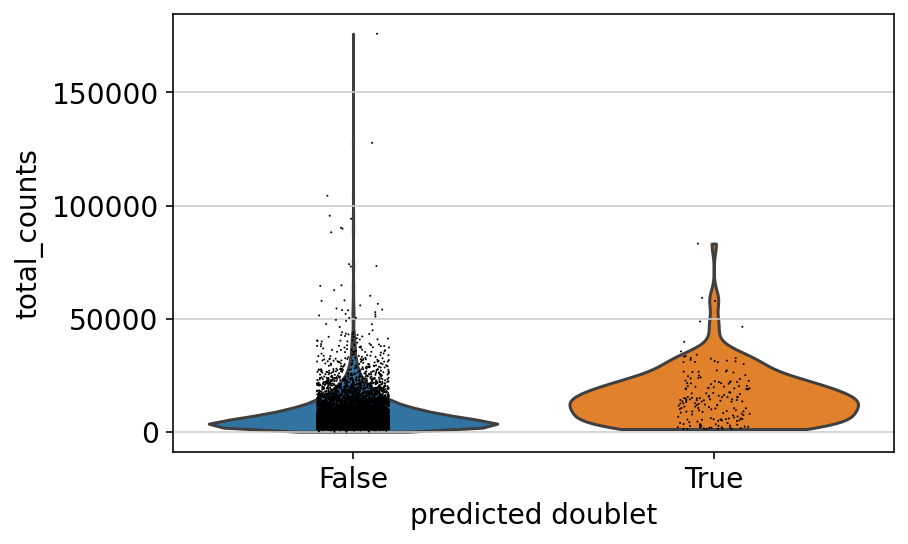

g015


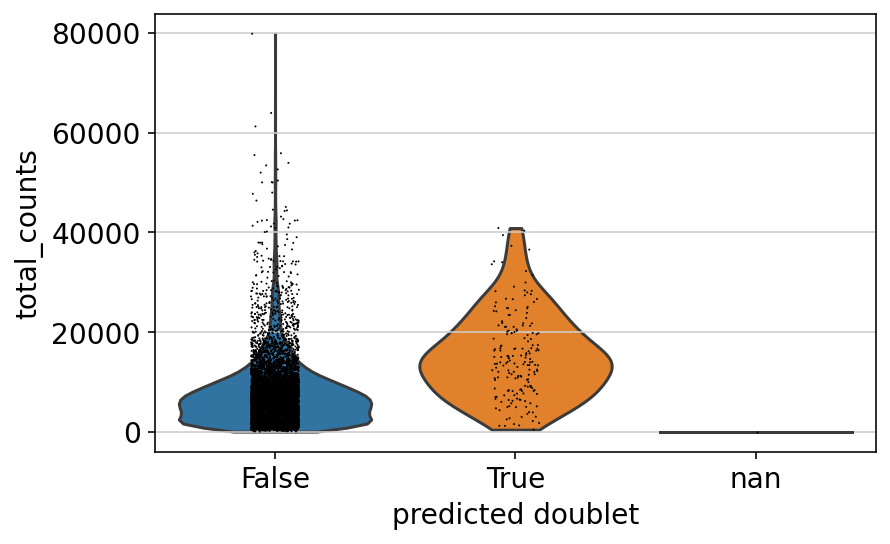

g016


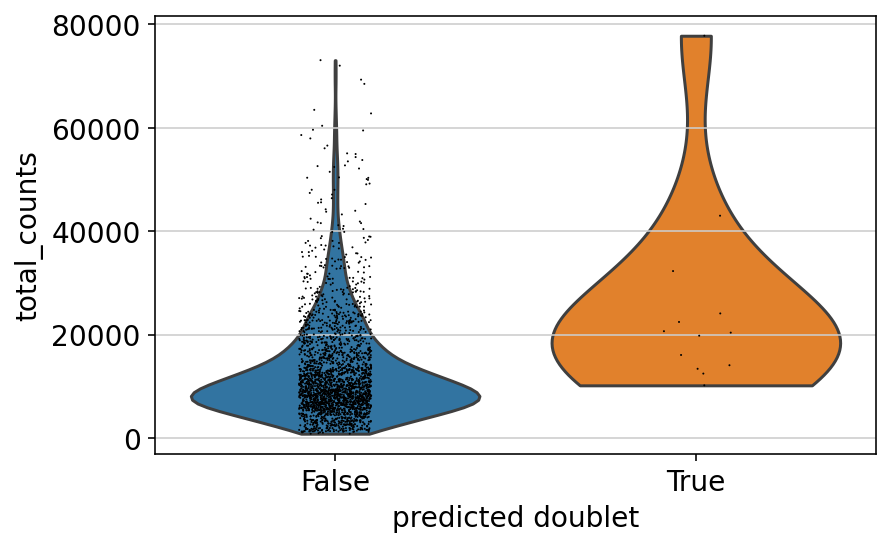

g017


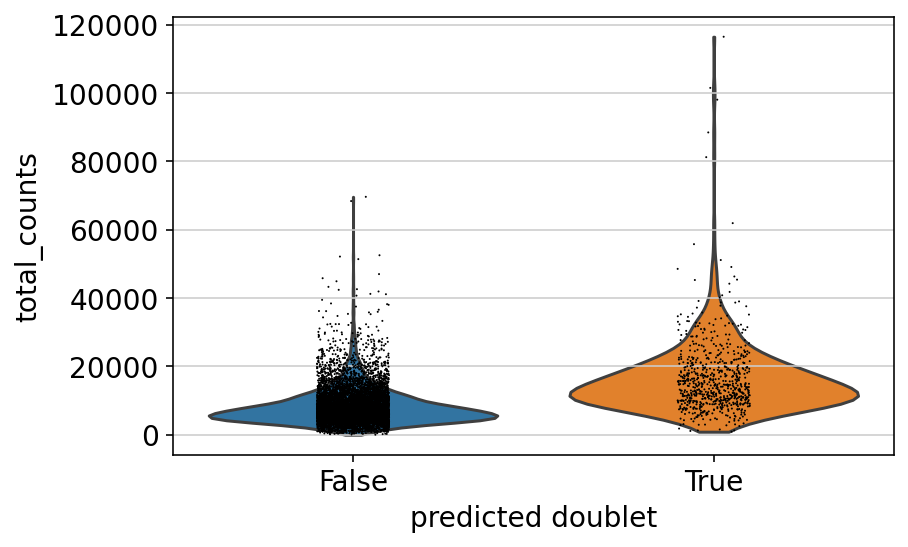

g018


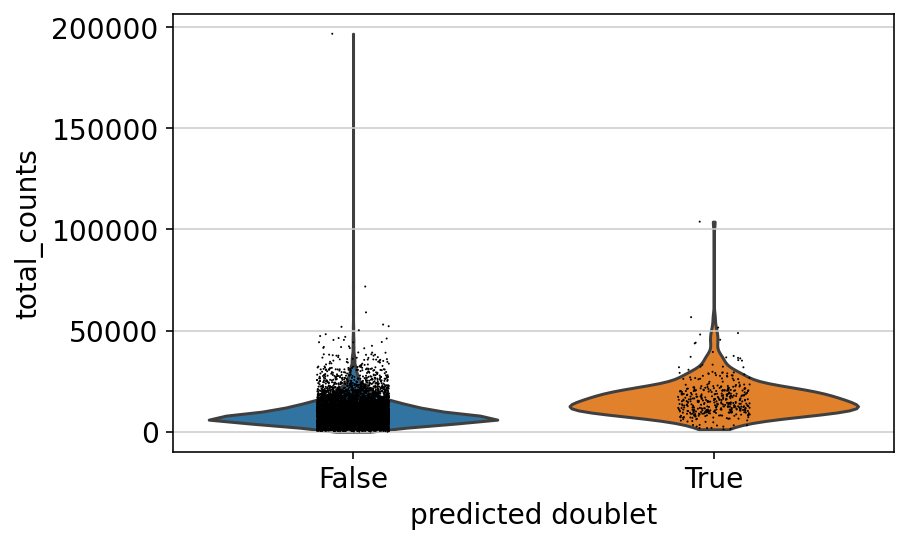

g019


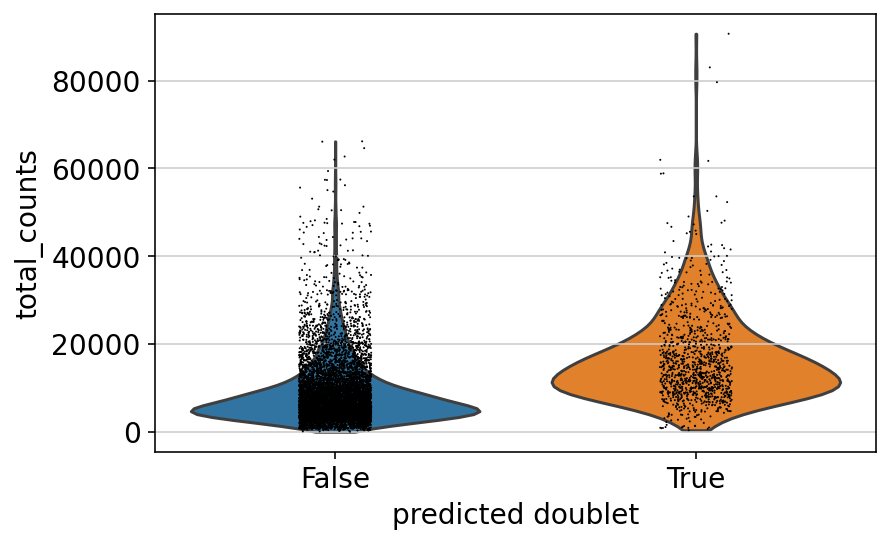

g020


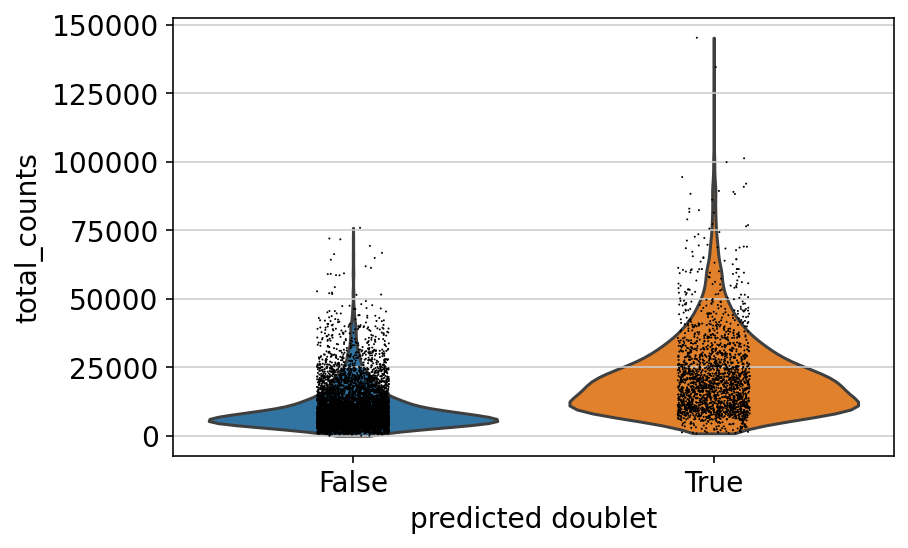

In [49]:
for i in range(numberobj):
    print(names[i])
    sc.pl.violin(locals()['test_'+names[i]], keys='total_counts', groupby='predicted_doublet')

In [46]:
subset = locals()['test_'+names[i]][locals()['test_'+names[i]].obs['predicted_doublet']=='True']
print(subset.obs)

                        species   atlas sample  doublet_score  \
CCACACTTCCTCTCGA-1  Homo sapien  altena   g020       0.215201   
TGACTCCAGGGTATAT-1  Homo sapien  altena   g020       0.226371   
CCAATTTGTTCAGCTA-1  Homo sapien  altena   g020       0.226371   
AAATGGACATCTTTCA-1  Homo sapien  altena   g020       0.215201   
TATCCTACATGGAAGC-1  Homo sapien  altena   g020       0.195452   
...                         ...     ...    ...            ...   
TGAGGAGCATGGAAGC-1  Homo sapien  altena   g020       0.215201   
GTCCCATGTGTGTGGA-1  Homo sapien  altena   g020       0.215201   
ACGATCACATTGAGCT-1  Homo sapien  altena   g020       0.134629   
TCACGGGCAAGCGAAC-1  Homo sapien  altena   g020       0.134629   
GCGTGCAAGTAAACAC-1  Homo sapien  altena   g020       0.129756   

                   predicted_doublet  n_genes_by_counts  \
CCACACTTCCTCTCGA-1              True              13897   
TGACTCCAGGGTATAT-1              True              11984   
CCAATTTGTTCAGCTA-1              True      

<div class="alert alert-warning">
Doublet score thresholds vary from sample to sample. Most suspicious are samples 5, 11, 13, 15, 18. Setting a lower manual threshold of 0.2 for these samples reduces the #counts compared to the original automatic threshold and also dont annotate cells that cluster with predicted doublets as doublets, indicating that the automatic threshold might not encapture most doublets. I am using total count and # genes as an intial proxy for doublets (even though this is not the only indicator/ an accurate one, but doublets tend to have higher counts than normal cells).
For now automatic thresholds are kept, but might need to do more filtering later... Keep this in mind

### Filtering - Doublets
Data points between clusters and in the middle of clusters with high count values are more likely to be doublets, but we can't be sure.

In [13]:
#max_doub_score = 0.2 

for i in range(numberobj):
    locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]][locals()[object_names_preprocessed[i]].obs['predicted_doublet'] == 'False']
    print(object_names_preprocessed[i],': filtered!')

adata_g004_preprocessed : filtered!
adata_g005_preprocessed : filtered!
adata_g011_preprocessed : filtered!
adata_g012_preprocessed : filtered!
adata_g013_preprocessed : filtered!
adata_g014_preprocessed : filtered!
adata_g015_preprocessed : filtered!
adata_g016_preprocessed : filtered!
adata_g017_preprocessed : filtered!
adata_g018_preprocessed : filtered!
adata_g019_preprocessed : filtered!
adata_g020_preprocessed : filtered!


Recalculate values, especially total_counts and without ribo/mito pct change, because there is no mito genes anymore

In [14]:
for i in range(numberobj):
    sc.pp.calculate_qc_metrics(locals()[object_names_preprocessed[i]], expr_type='counts', var_type='genes', qc_vars=(), percent_top= (), layer= None, use_raw= False, inplace=True, log1p=True)
    print(object_names_preprocessed[i],': updated!')

/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_g004_preprocessed : updated!


/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_g005_preprocessed : updated!


/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_g011_preprocessed : updated!


/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_g012_preprocessed : updated!


/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_g013_preprocessed : updated!


/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_g014_preprocessed : updated!


/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_g015_preprocessed : updated!


/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_g016_preprocessed : updated!


/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_g017_preprocessed : updated!


/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_g018_preprocessed : updated!


/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_g019_preprocessed : updated!


/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_g020_preprocessed : updated!


## Preprocess - Mitochondrial and Ribosomal counts

In [15]:
for i in range(numberobj):
    print(locals()[object_names_preprocessed[i]])

AnnData object with n_obs × n_vars = 6501 × 60619
    obs: 'species', 'atlas', 'sample', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'total_counts_mito'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'scrublet'
AnnData object with n_obs × n_vars = 8448 × 60619
    obs: 'species', 'atlas', 'sample', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'total_counts_mito'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', '

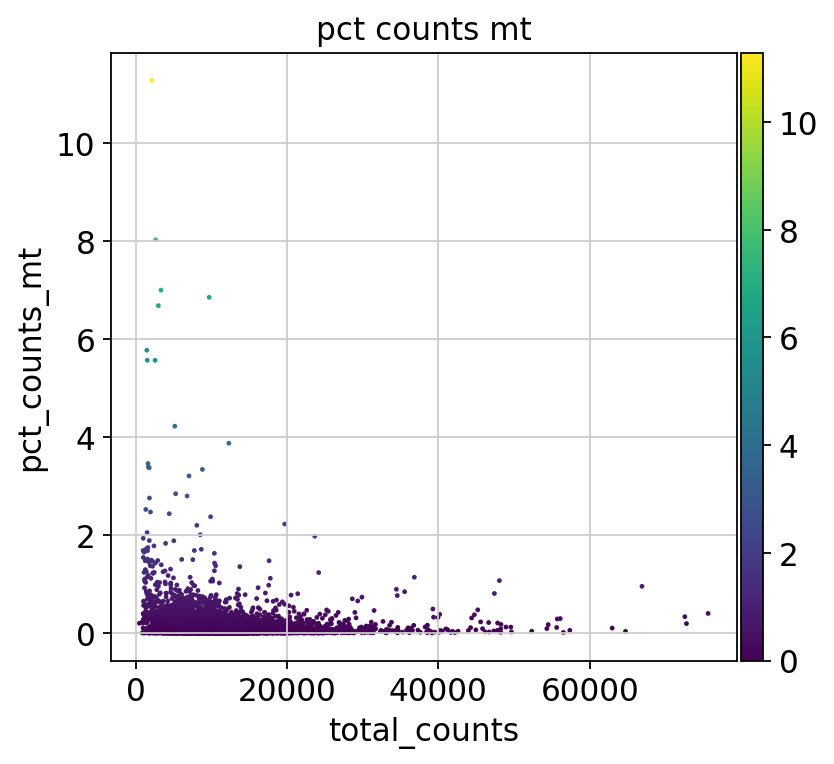

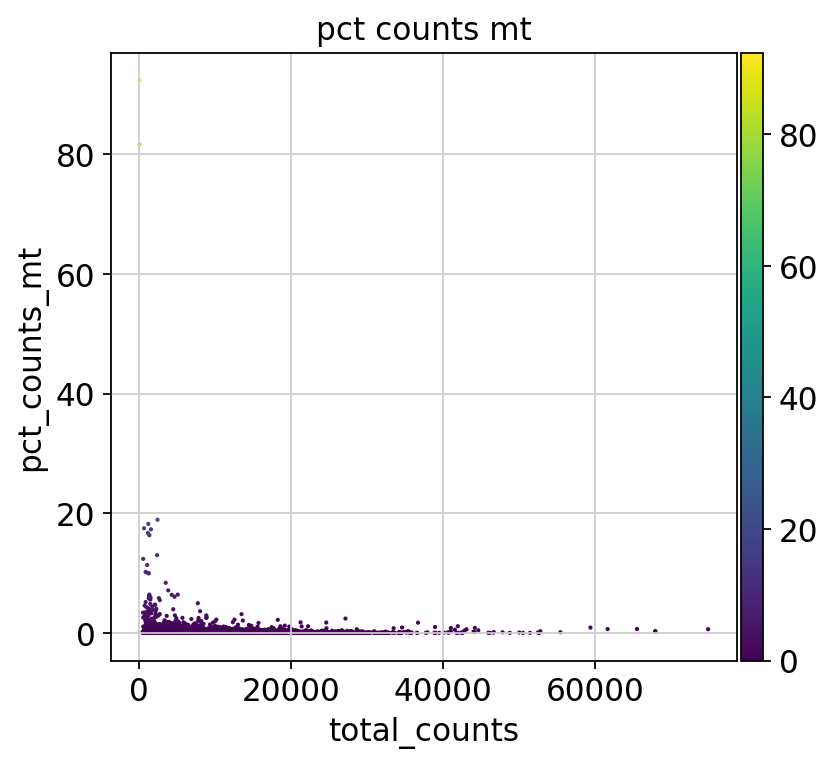

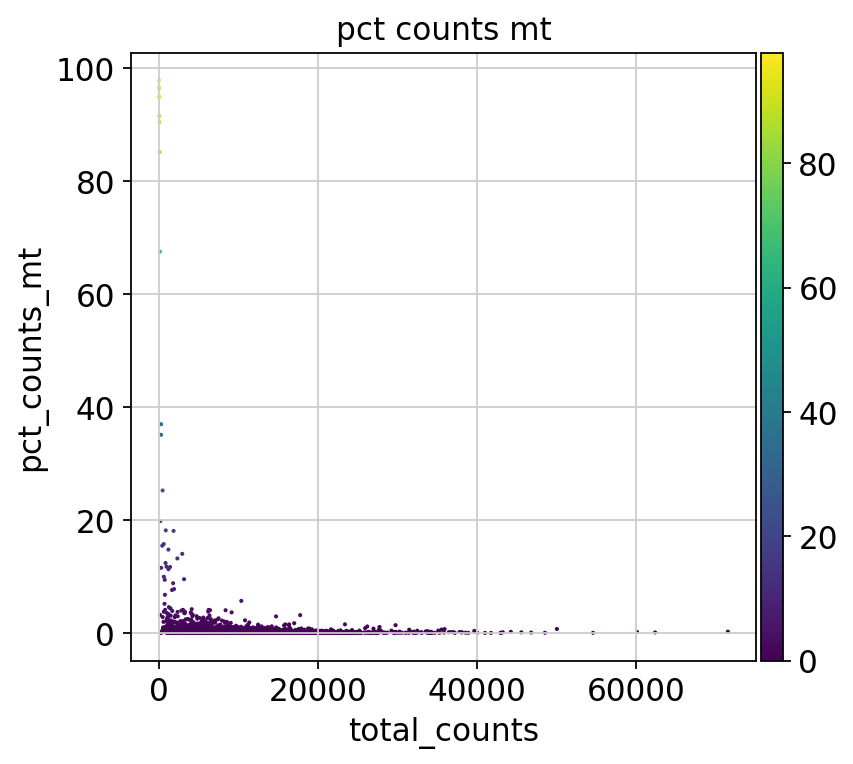

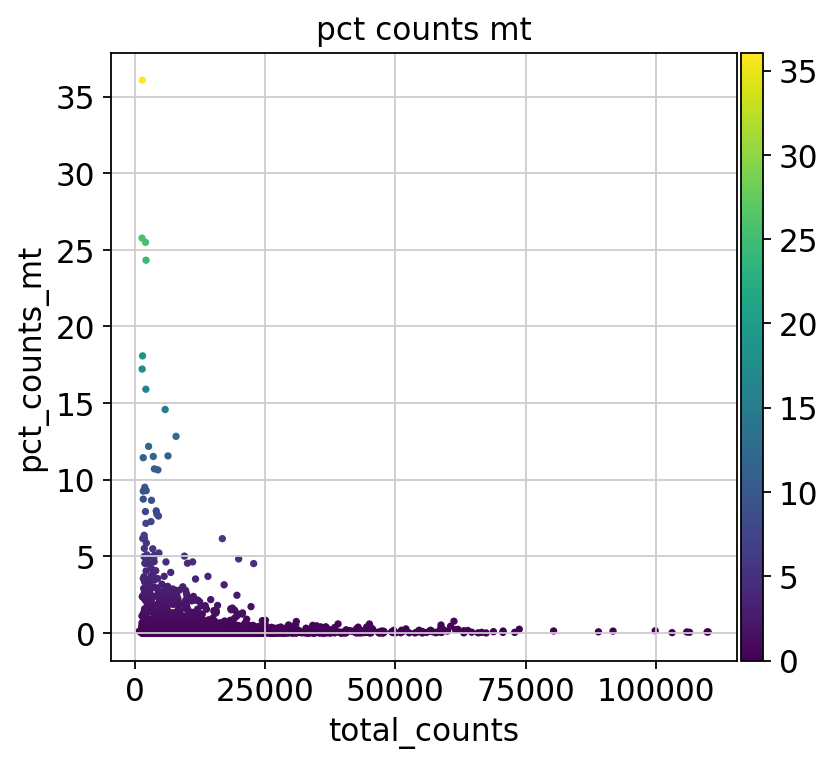

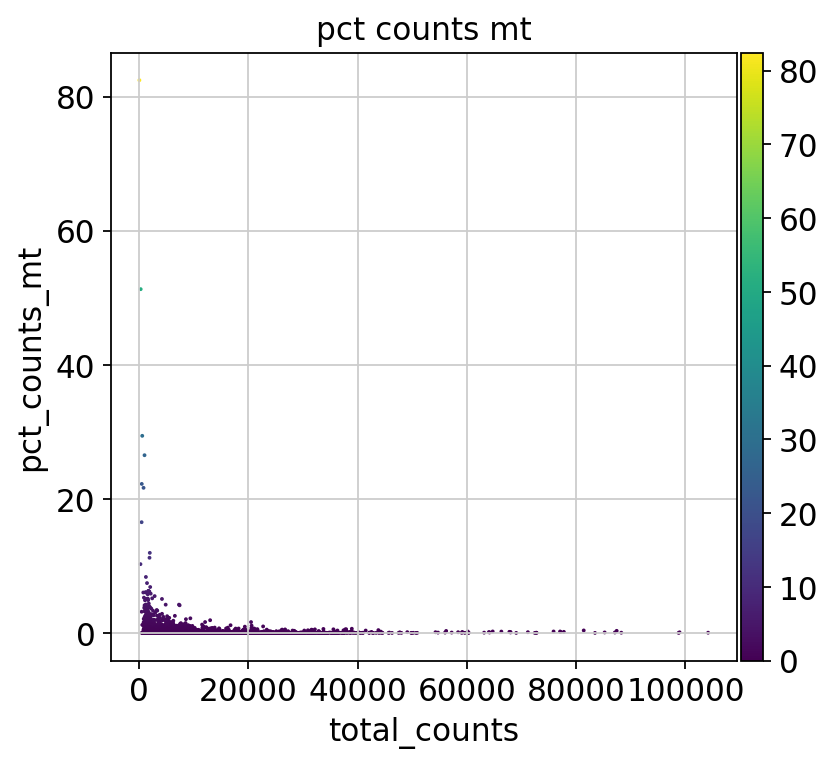

...

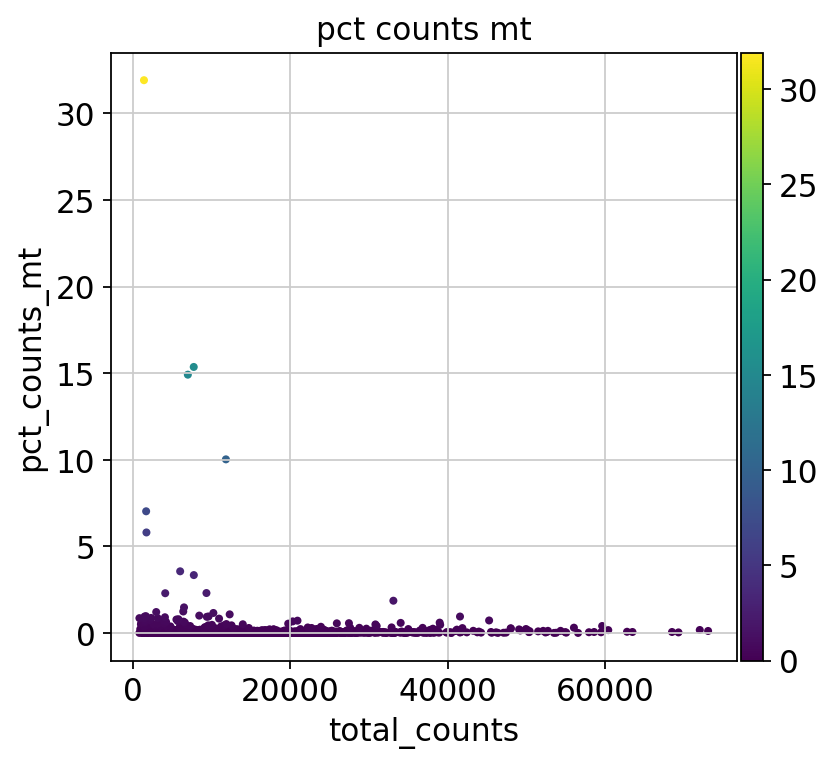

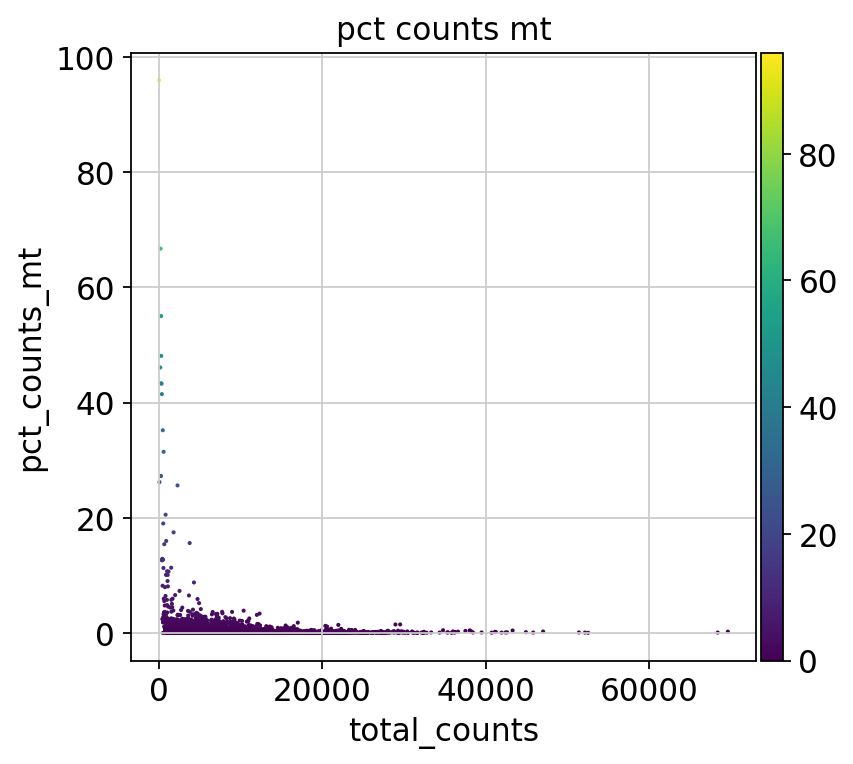

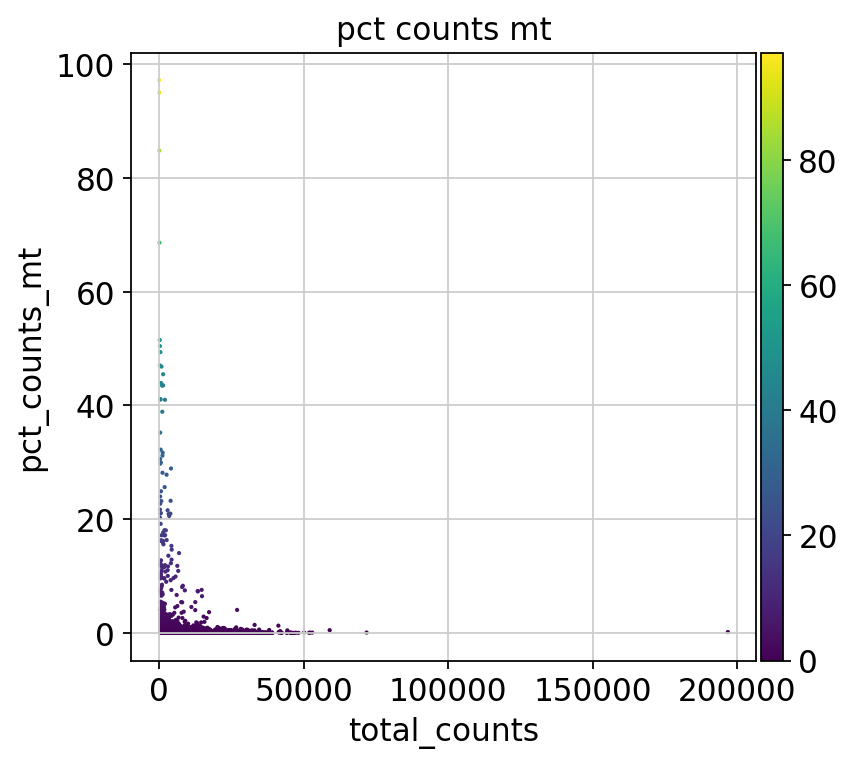

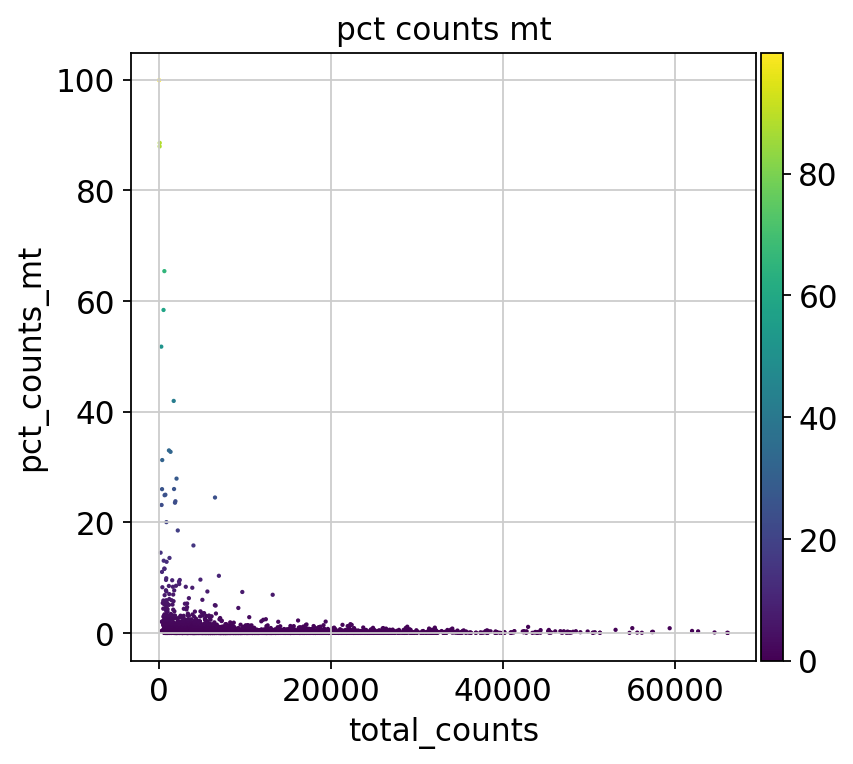

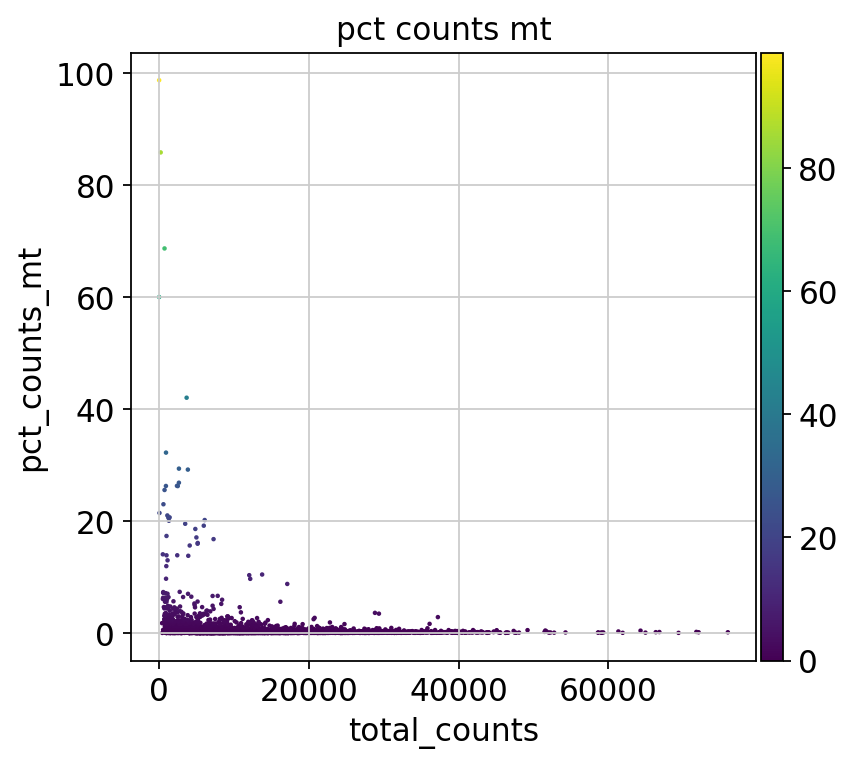

In [64]:
sc.set_figure_params(figsize=[5,5])
for i in range(numberobj):
    sc.pl.scatter(locals()[object_names_preprocessed[i]], x='total_counts', y='pct_counts_mt',color = 'pct_counts_mt',show=False)

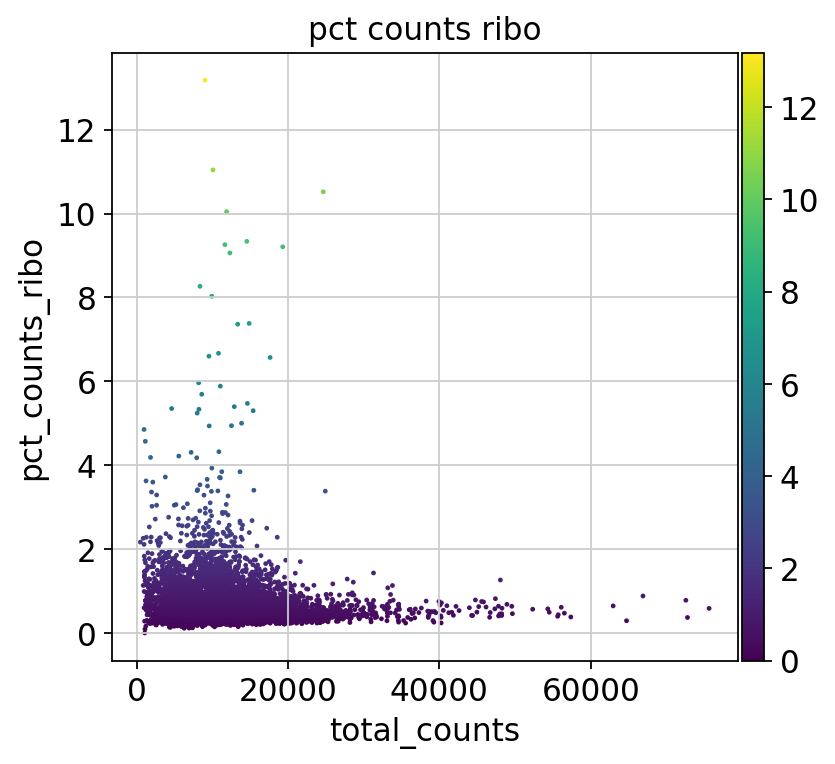

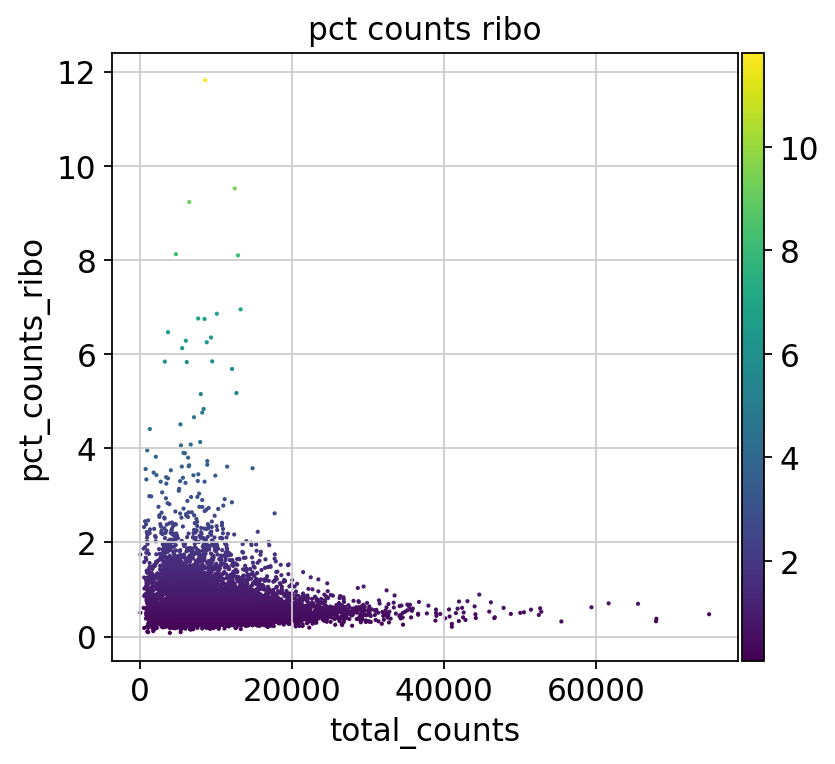

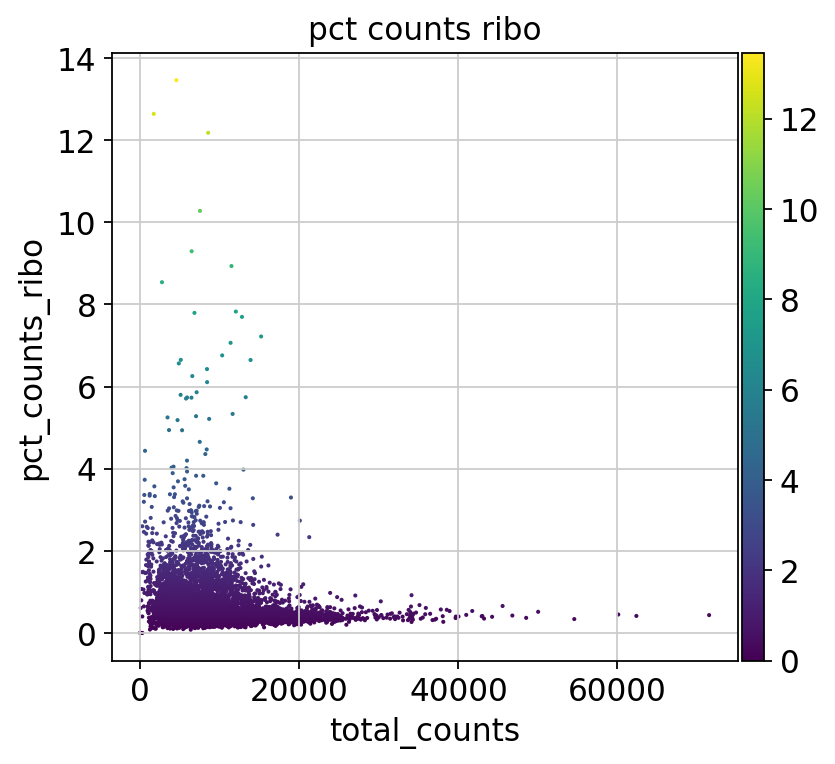

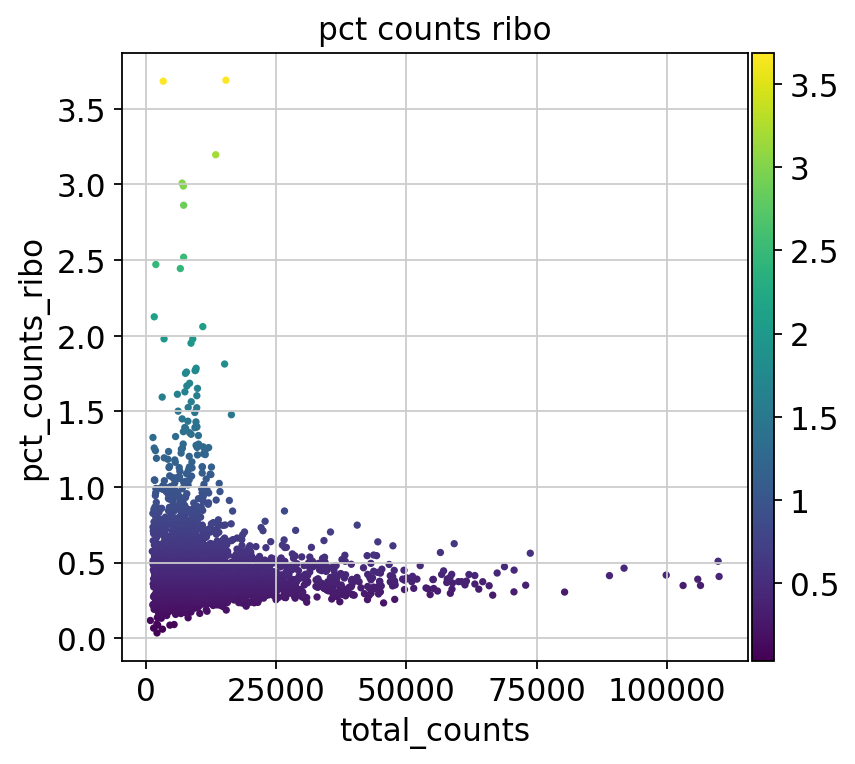

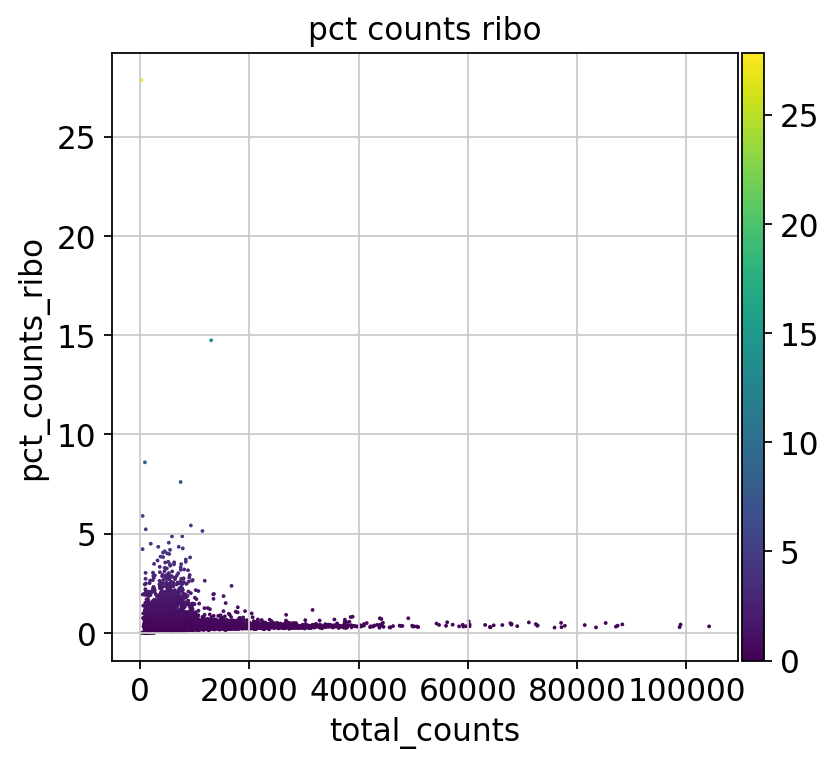

...

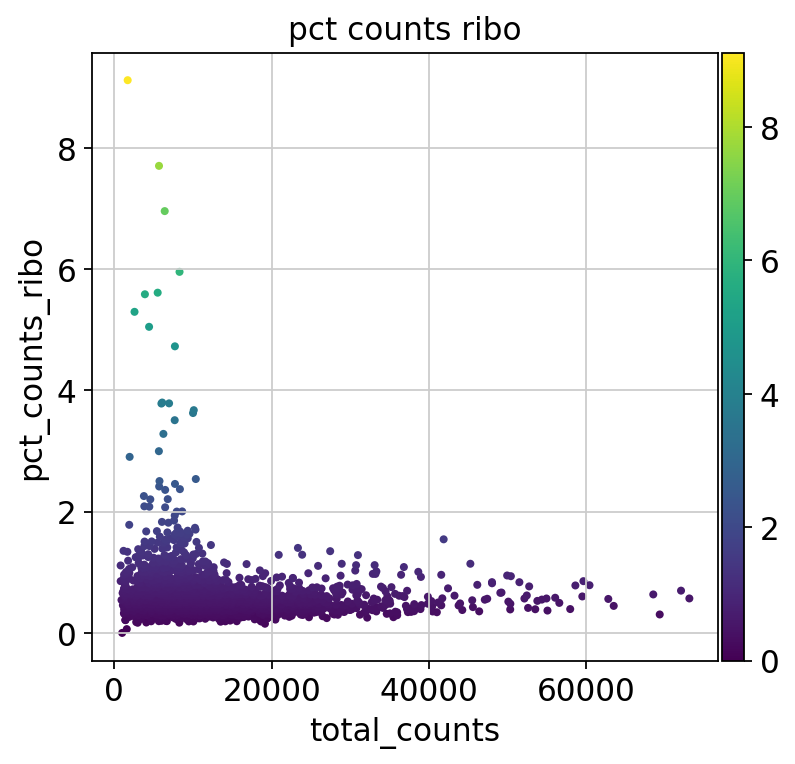

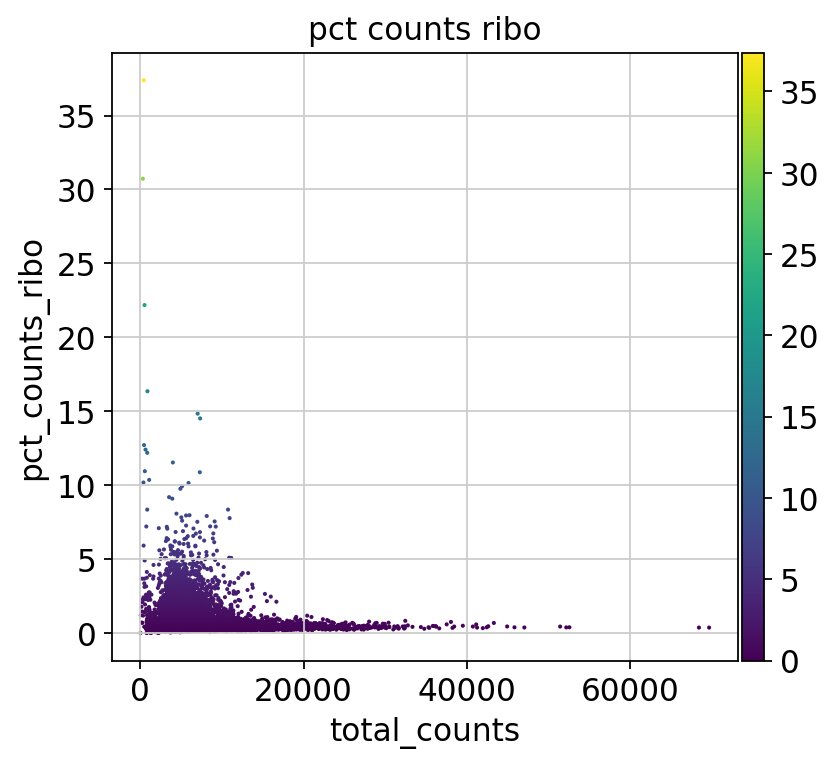

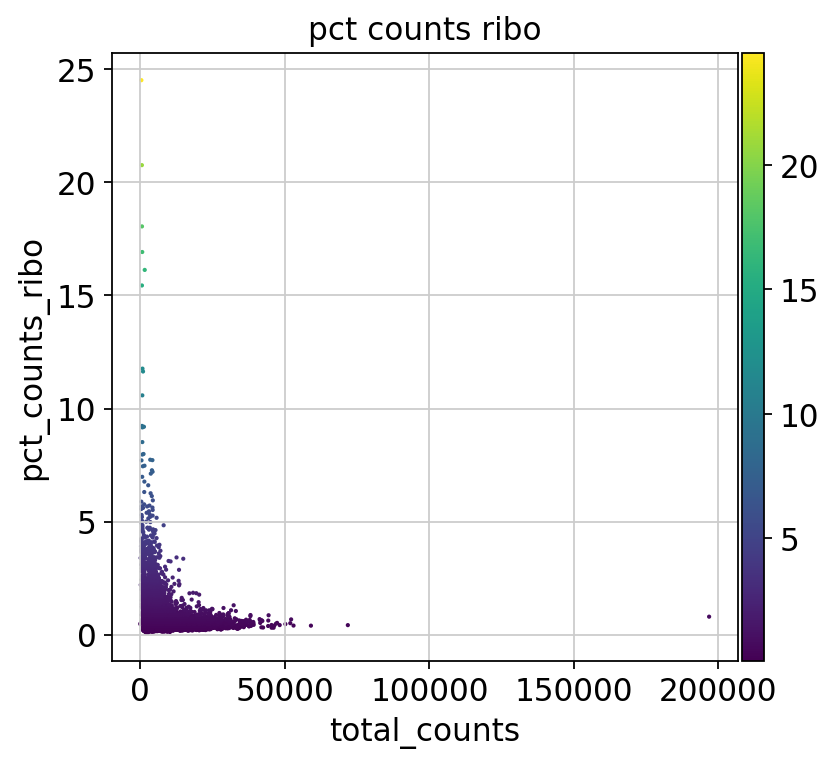

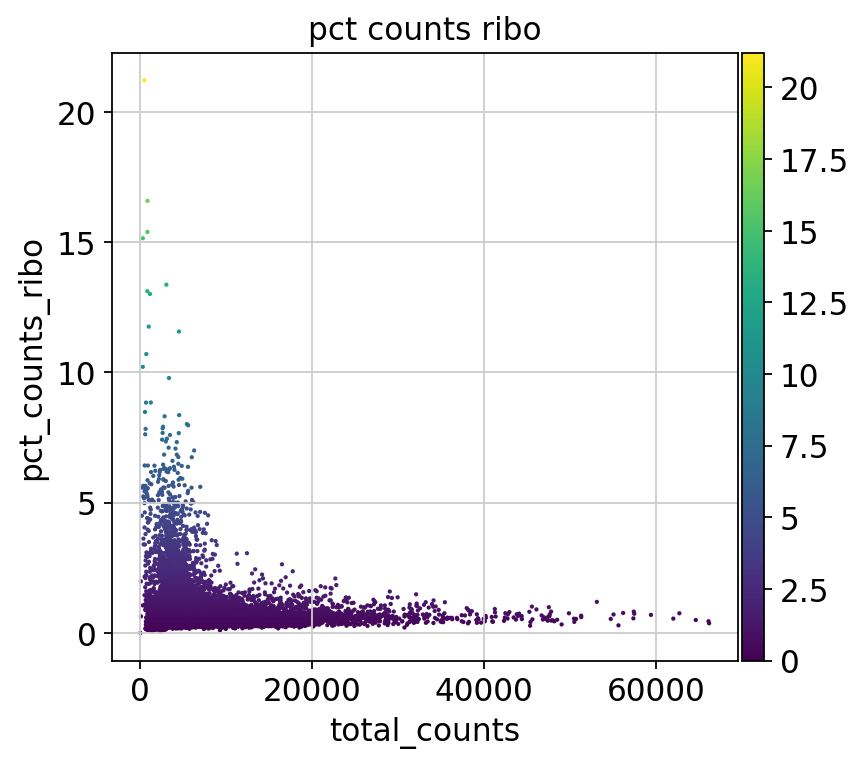

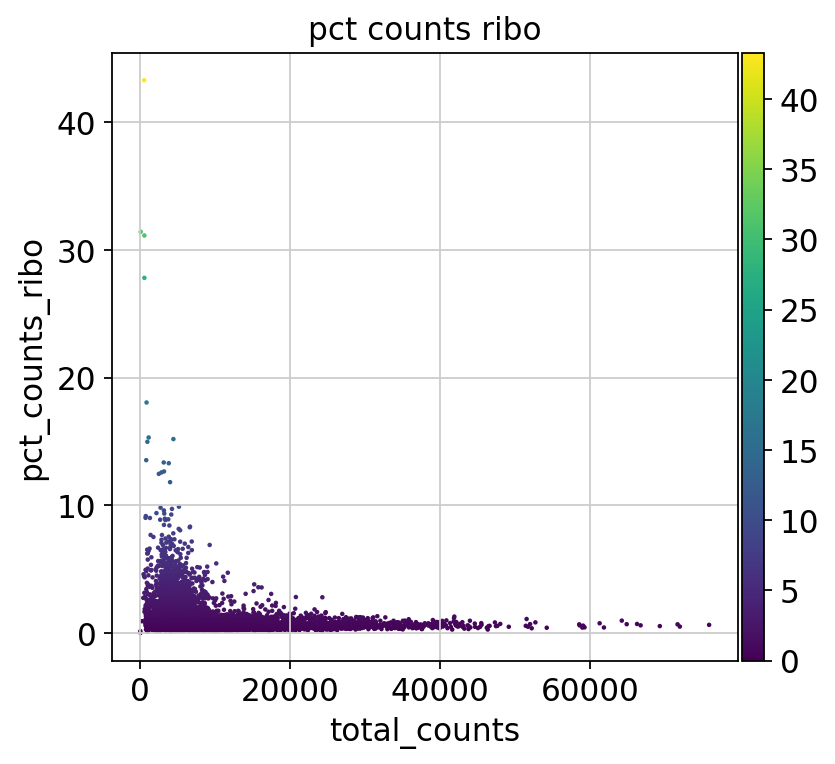

In [65]:
sc.set_figure_params(figsize=[5,5])
for i in range(numberobj):
    sc.pl.scatter(locals()[object_names_preprocessed[i]], x='total_counts', y='pct_counts_ribo',color = 'pct_counts_ribo',show=False)

### Filtering - Mitochondrial% and Ribosomal%
Try 10% first just like many other papers, see later if they form clusters...

In [16]:
max_pct_mt = 10.0 #%, only filters 3 cell or smth
max_pct_ribo = 10.0 #%
for i in range(numberobj):
    locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]][locals()[object_names_preprocessed[i]].obs['pct_counts_mt'] < max_pct_mt]
    locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]][locals()[object_names_preprocessed[i]].obs['pct_counts_ribo'] < max_pct_ribo]

## Preprocess - UMIs and gene counts
Here, I want to use some different techniques to plot the data. This is not always necessary, however, you may want to have a close look at your data when you recieve something new. Seaborn package lets us make publication quality and diver plots, while a custom code from the Theis lab, built on Bokeh library, enables interactive plots 

In [15]:
for i in range(numberobj):
    print(locals()[object_names_preprocessed[i]] )

View of AnnData object with n_obs × n_vars = 6496 × 60619
    obs: 'species', 'atlas', 'sample', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'total_counts_mito'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'scrublet'
View of AnnData object with n_obs × n_vars = 8434 × 60619
    obs: 'species', 'atlas', 'sample', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'total_counts_mito'
    var: 'gene_ids', 'feature_types', '

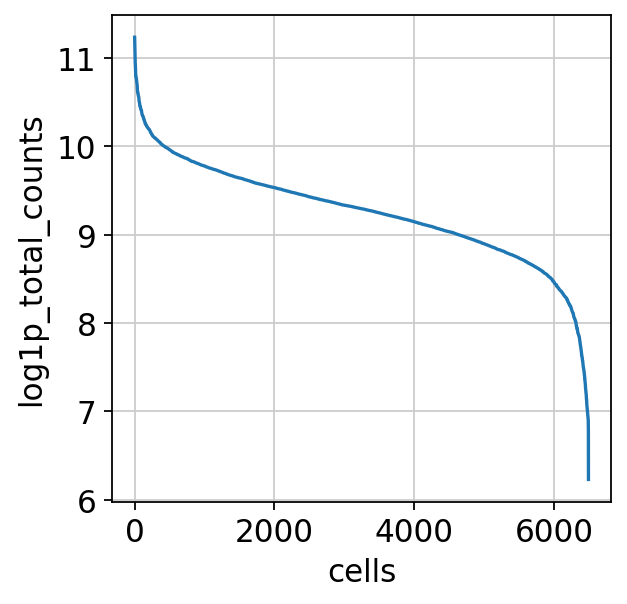

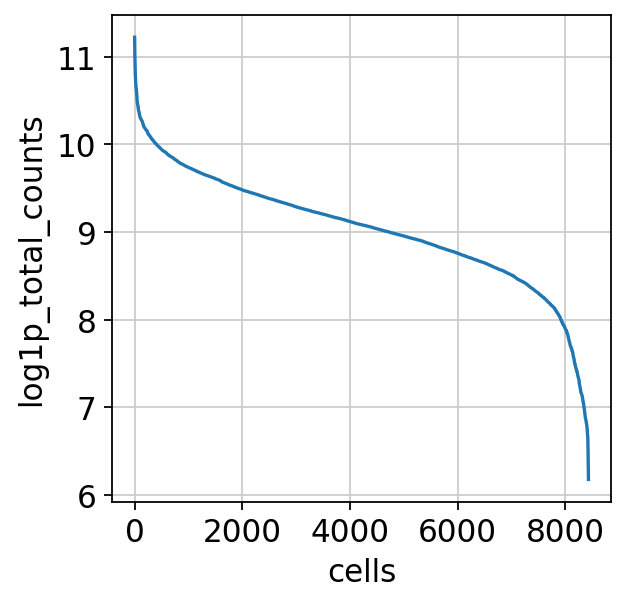

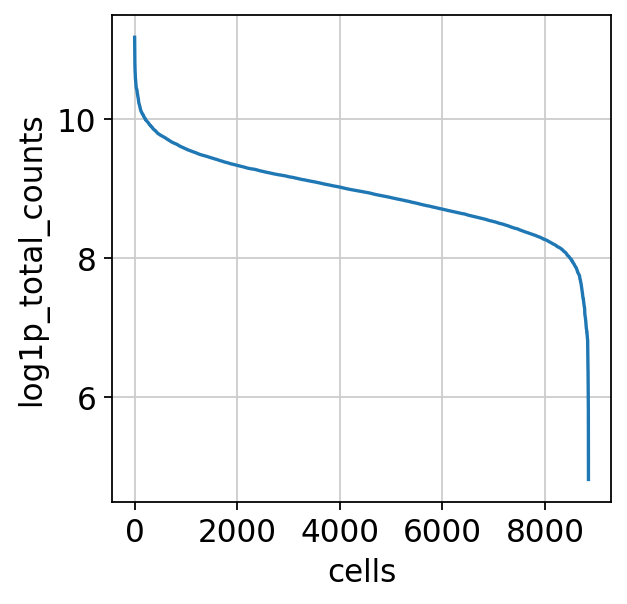

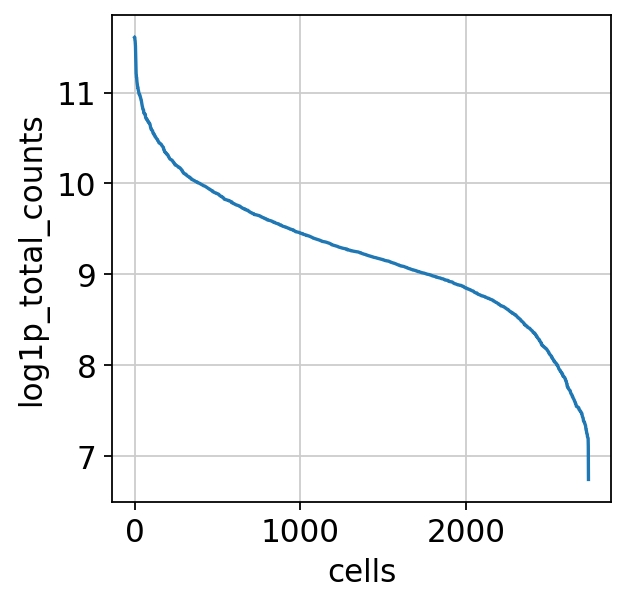

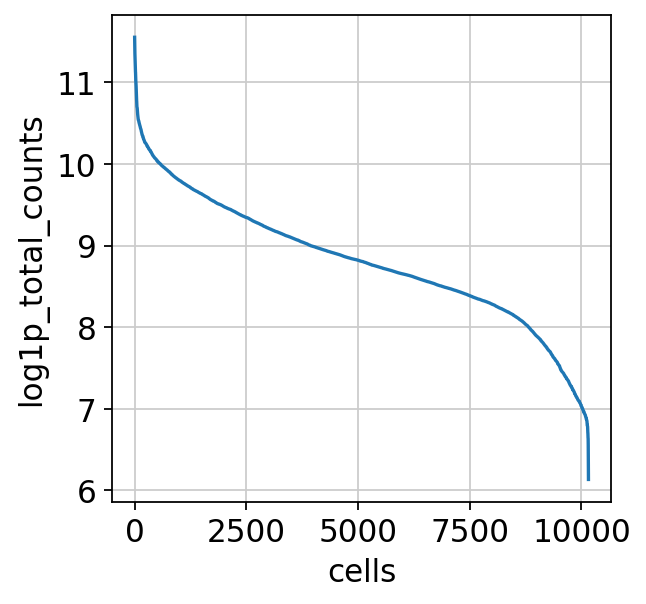

...

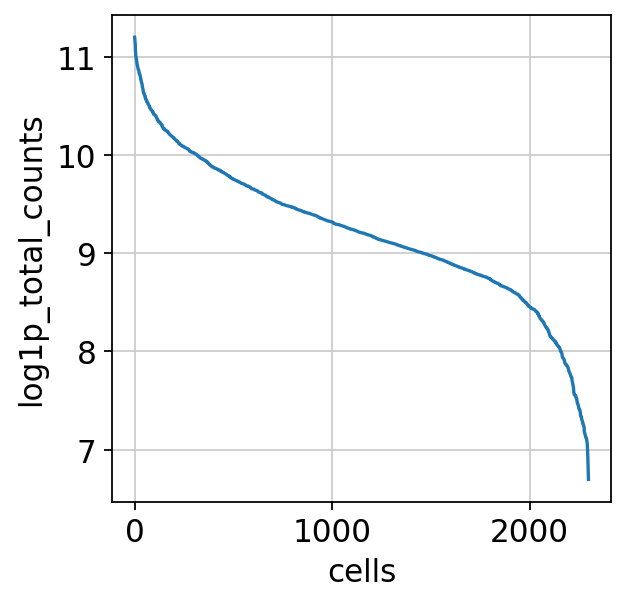

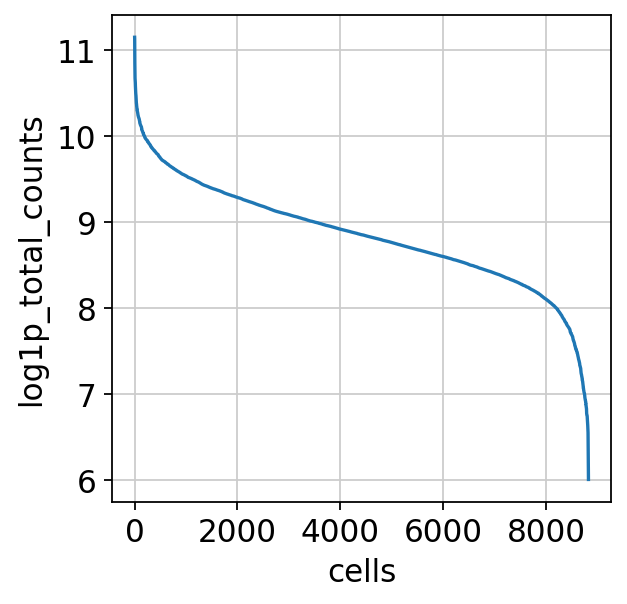

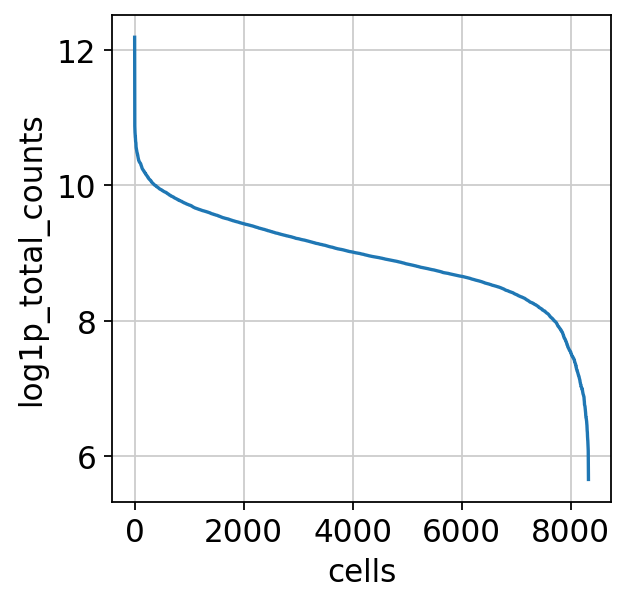

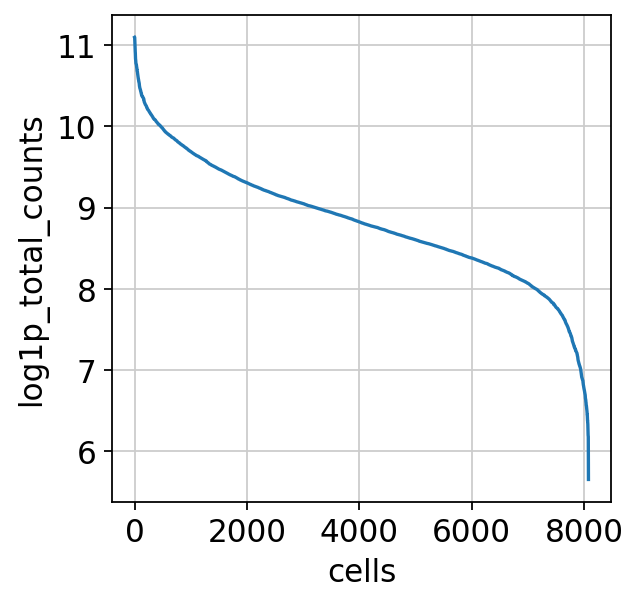

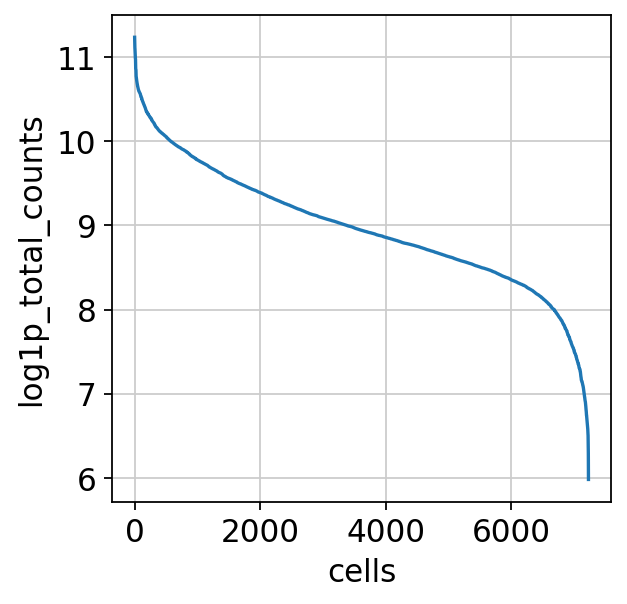

In [29]:
for i in range(numberobj):
    plt.figure()
    total_counts = locals()[object_names_preprocessed[i]].obs['log1p_total_counts'].sort_values(ascending = False)
    index = range(len(total_counts))
    plot = sns.lineplot( x = index, y=total_counts )
    plot.set(xlabel='cells')
    plt.show()

### Seaborn hex plots
These plots allow us to see the distribution of the number of genes and reads, as well as where they are most concentrated (dark colors)

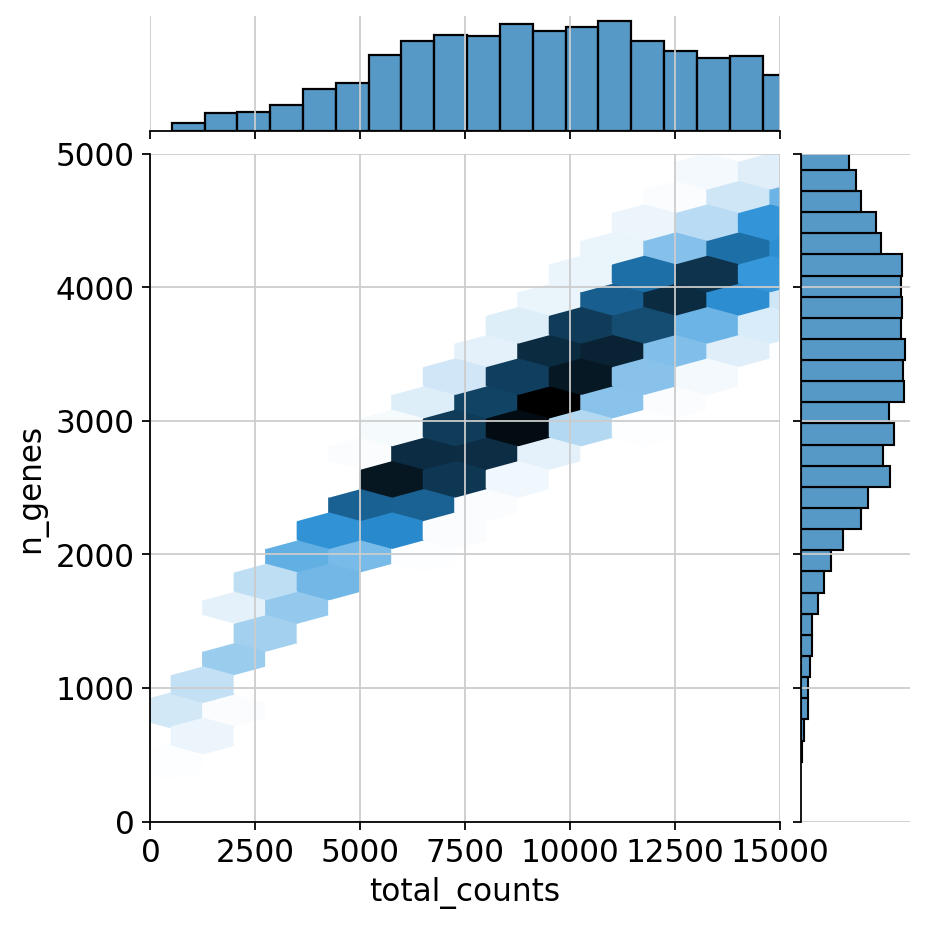

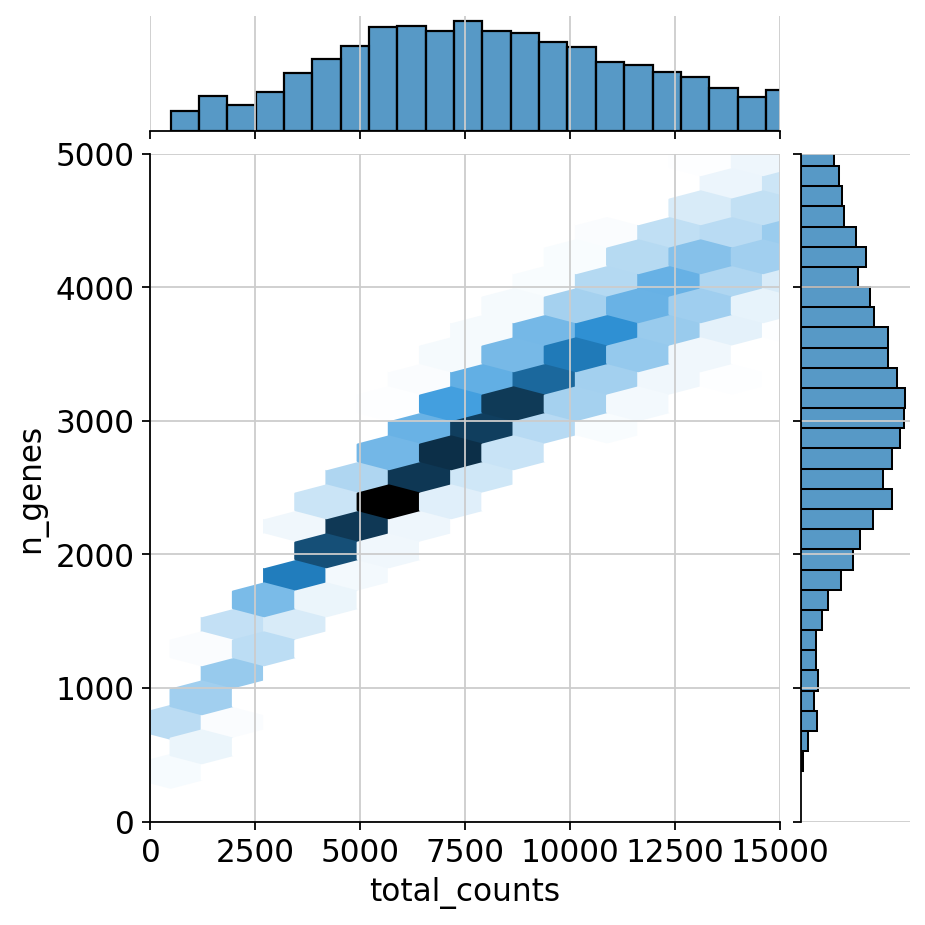

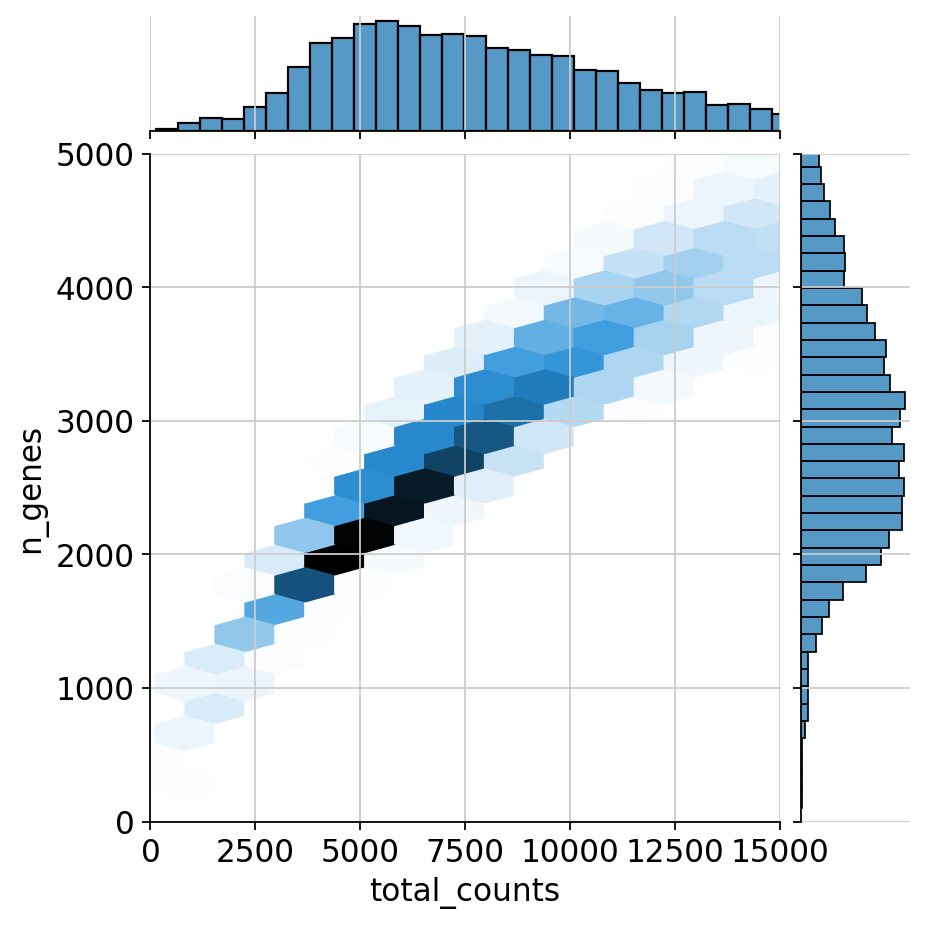

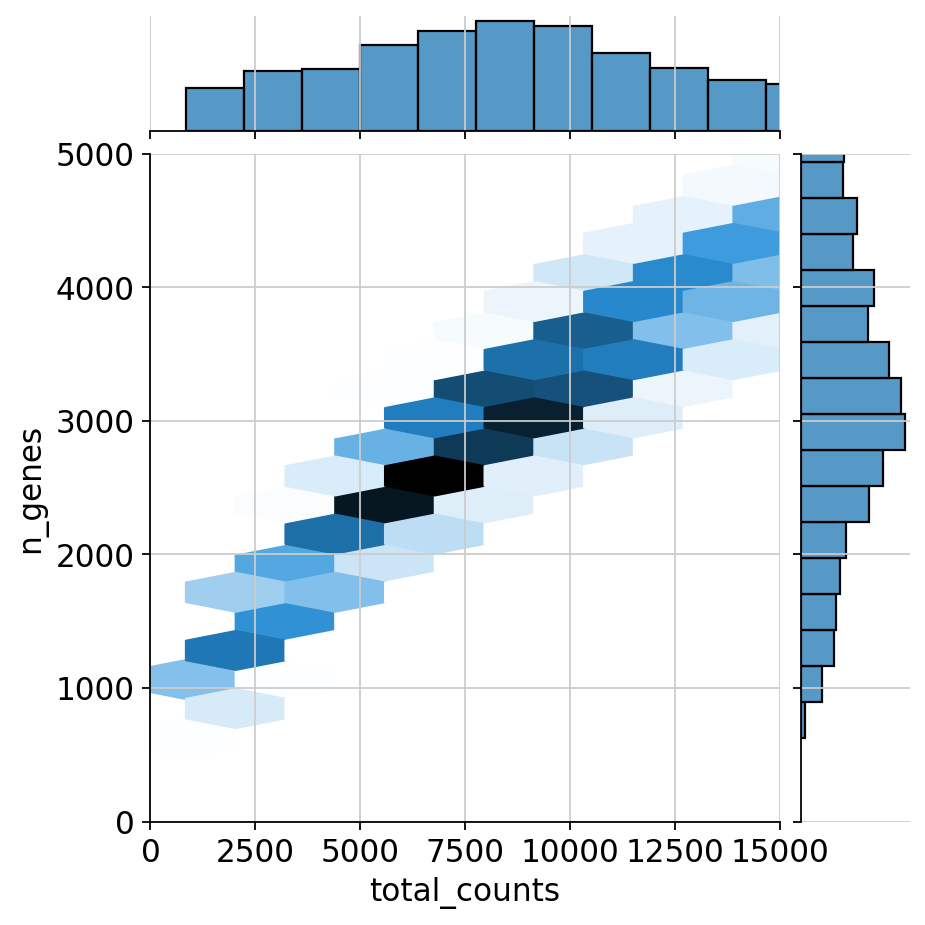

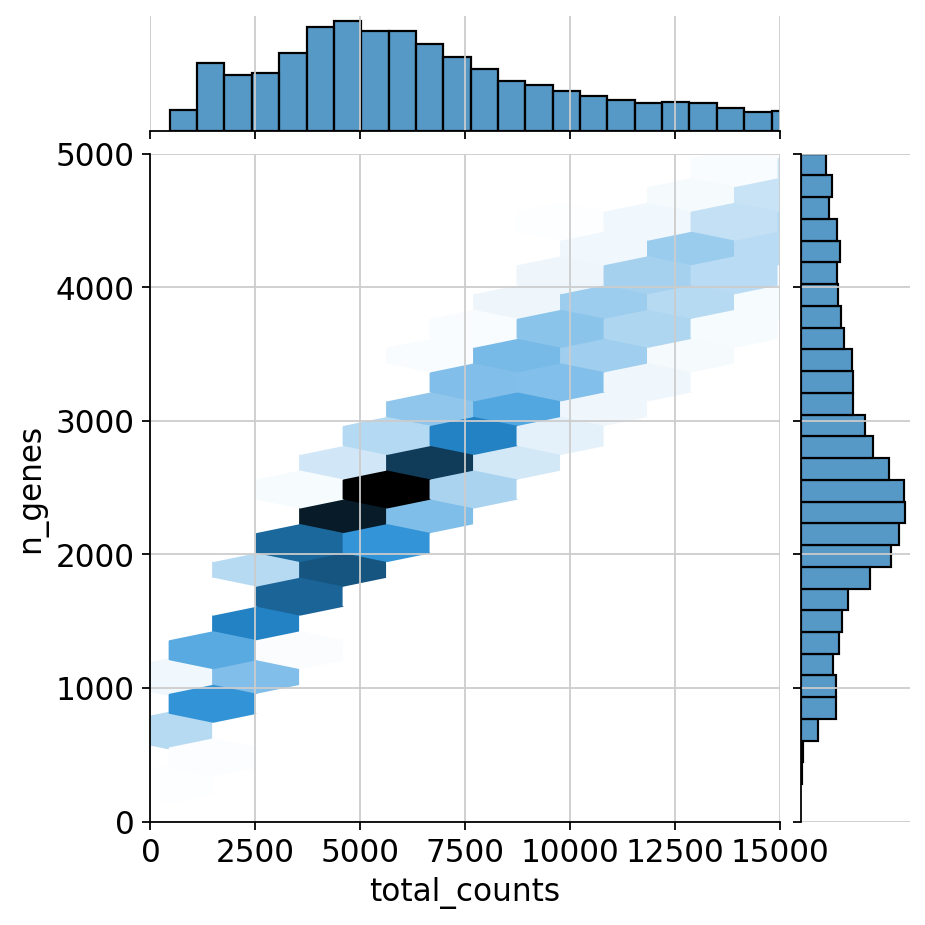

...

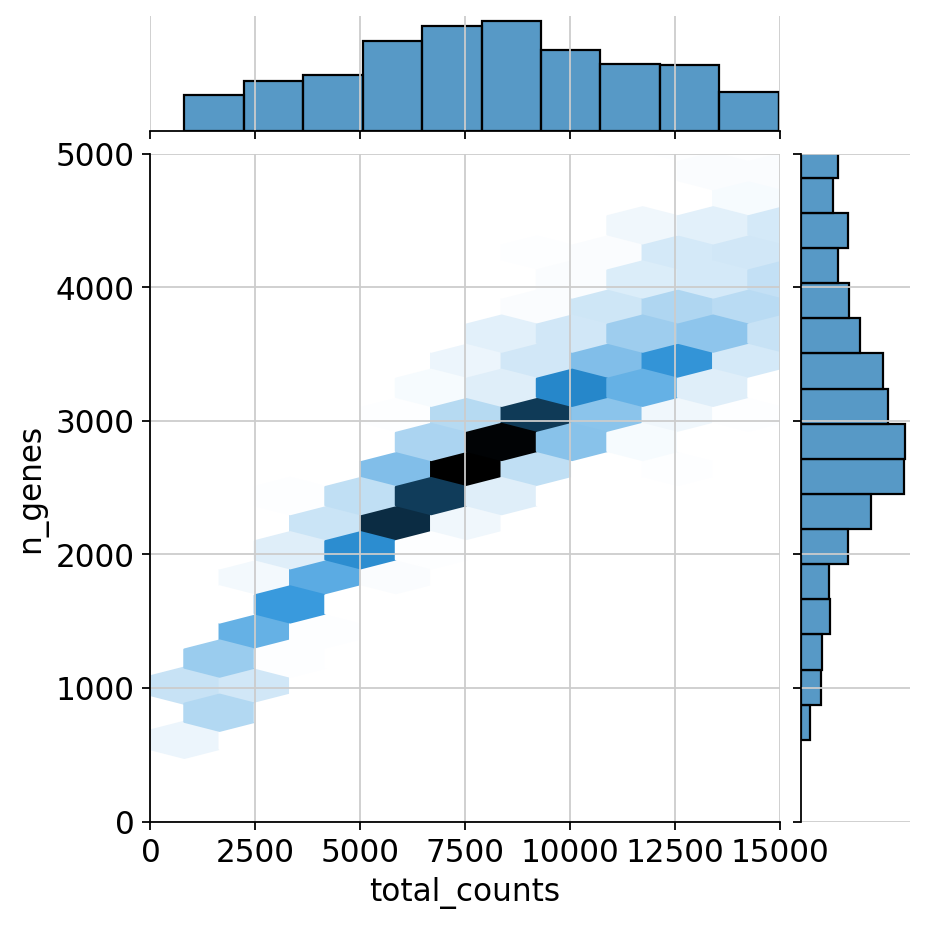

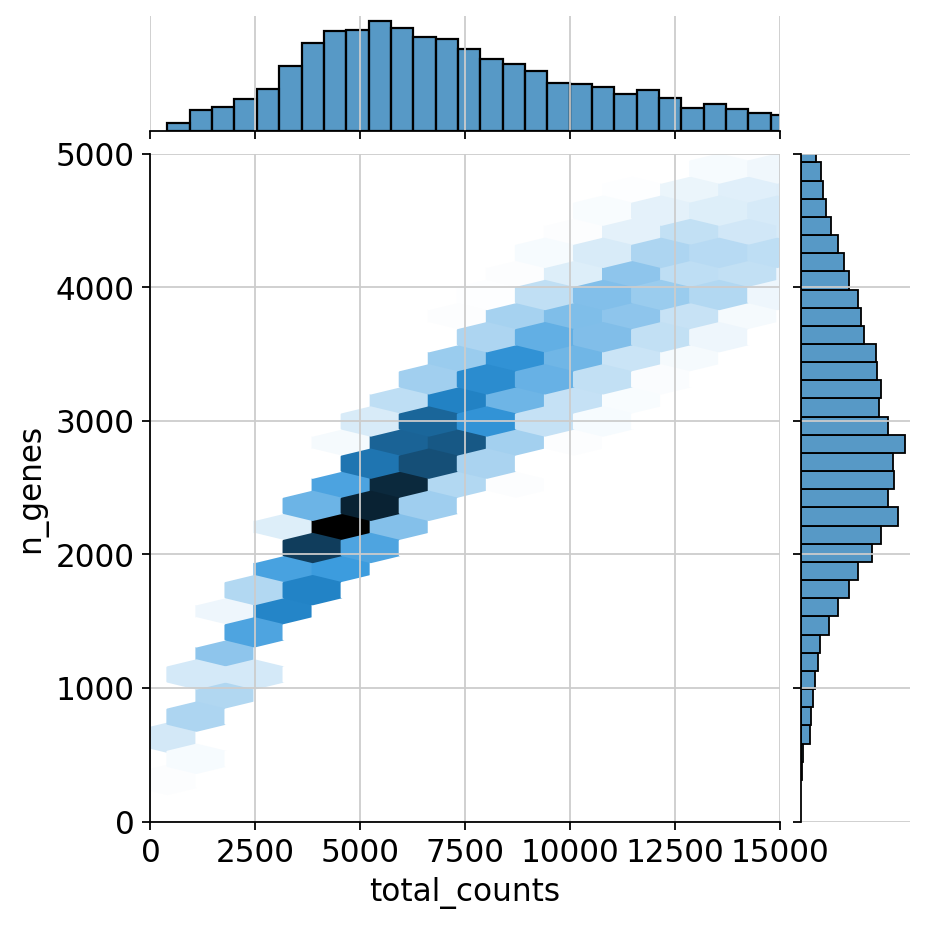

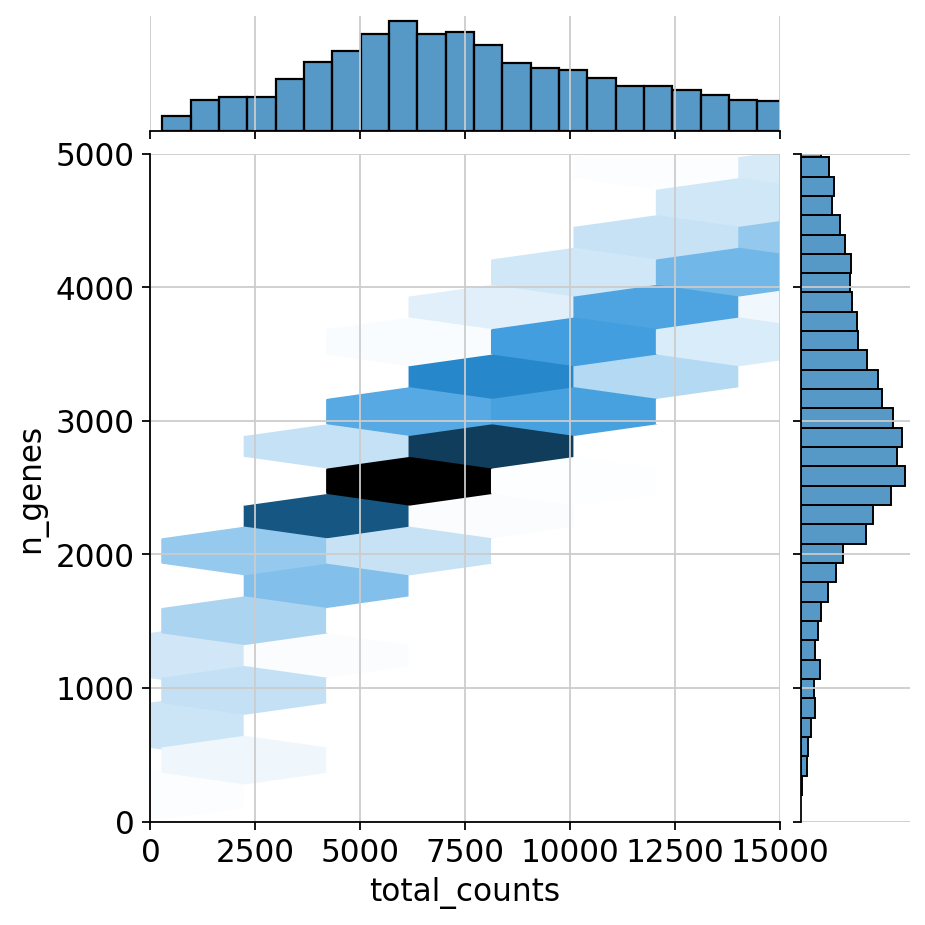

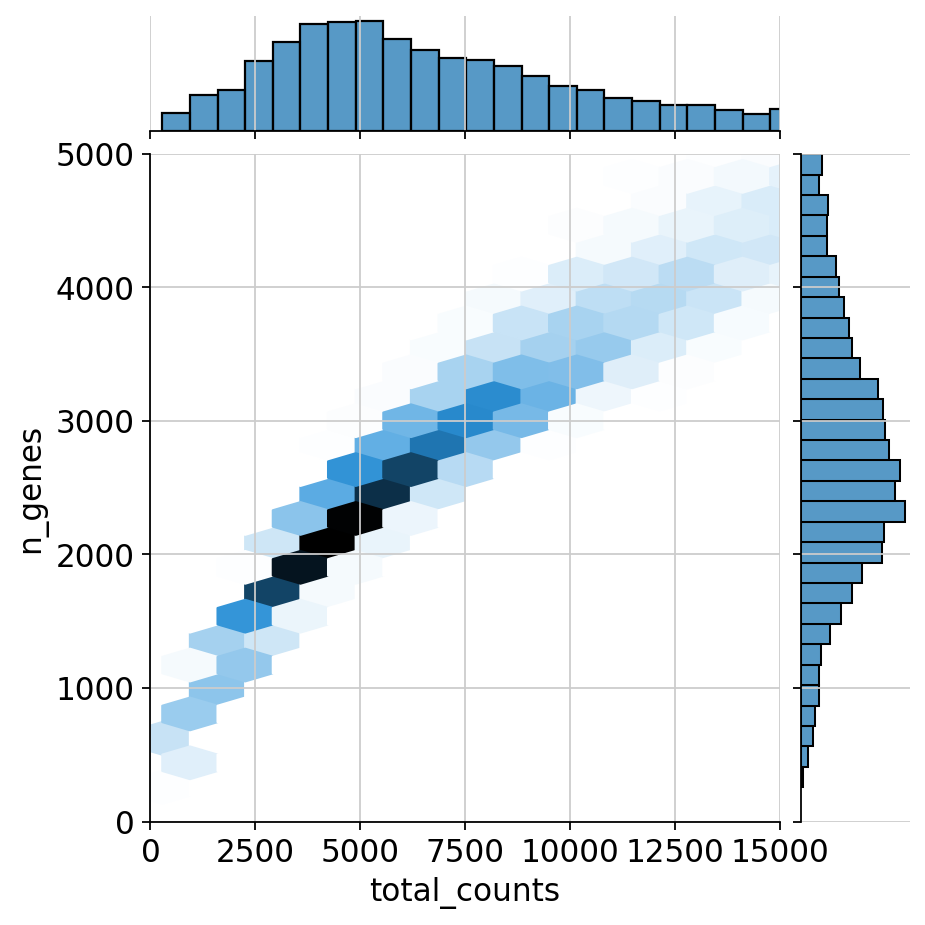

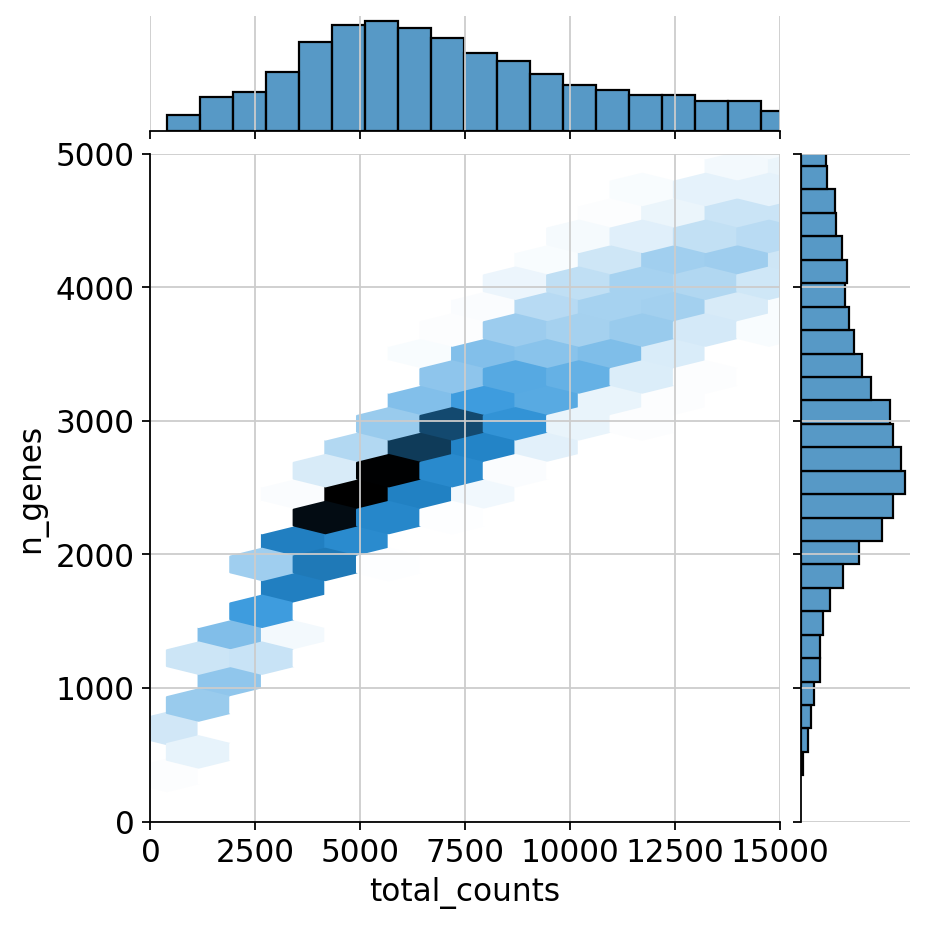

In [17]:
for i in range(numberobj):
    sns.jointplot( x= "total_counts", y= "n_genes", data=locals()[object_names_preprocessed[i]].obs, kind="hex",xlim=[0,15000], ylim=[0,5000])
#kind : { "scatter" | "reg" | "resid" | "kde" | "hex" }

### combined histogram plots
We can compare all libraries to each other using a seaborn histplot

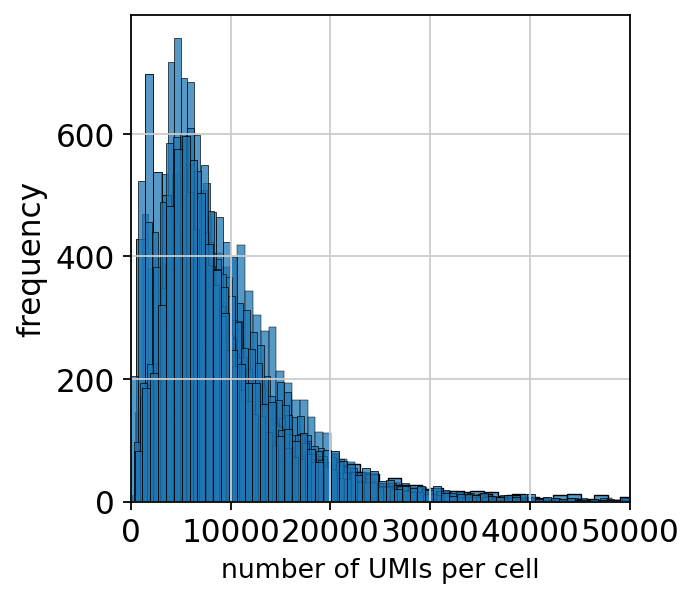

In [25]:

for i in range(numberobj):
    plot = sns.histplot(data=locals()[object_names_preprocessed[i]].obs,x= 'total_counts')
    plot.set_xlabel("number of UMIs per cell", fontsize = 12)
    plot.set_ylabel("frequency", fontsize = 14)
    plot.set_xlim(0,50000)

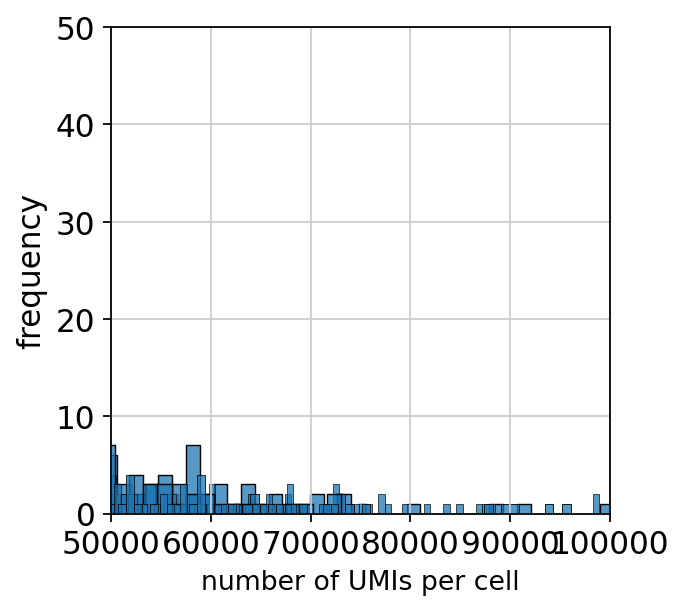

In [27]:

for i in range(numberobj):
    plot2 = sns.histplot(data=locals()[object_names_preprocessed[i]].obs,x= 'total_counts')
    plot2.set_xlabel("number of UMIs per cell", fontsize = 12)
    plot2.set_ylabel("frequency", fontsize = 14)
    plot2.set_xlim(50000,100000)
    plot2.set_ylim(0,50)

It seems ~70k might be good to start,but almost no atlas has a maximum UMI filter.

### Filtering - UMI and Gene 
Cells with unusual **low/high UMI** counts should be removed. Low counts could be droplets with only ambient RNA while high counts could be doublets. Here we won't filter out cells with high counts as they might represent a celltype. <br>
Similarly cells with unusual **low/high unique gene** counts should be removed. Low gene counts could be droplets with only ambient RNA while high gene counts could be multiplets. <br>
Nonetheless, these thresholds are sample specific and determining them is an iterative process. <br> 

Atlases generally don't have a max gene/UMI threshold as doublets are mostly filtered through methods such as scrublet.

<br>
NOTE: Cell Ranger Count function autmatically filtered out cells with less than 500 UMI counts (might not be the best for heterogenous data). <br>
For more information see: https://www.10xgenomics.com/resources/analysis-guides/common-considerations-for-quality-control-filters-for-single-cell-rna-seq-data 

In [17]:
min_counts = 500 #default
#max_counts = 50000
min_genes = 500
#max_genes = 10000
min_cells = 3



for i in range(numberobj):
    locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]][locals()[object_names_preprocessed[i]].obs['total_counts']>=min_counts]
    #locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]][locals()[object_names_preprocessed[i]].obs['total_counts'] < max_counts[i] ]
    locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]][locals()[object_names_preprocessed[i]].obs['n_genes'] >= min_genes]
    #locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]][locals()[object_names_preprocessed[i]].obs['n_genes'] < max_genes]
    
    sc.pp.filter_genes(locals()[object_names_preprocessed[i]], min_cells=min_cells)

/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number
/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number
/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number
/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number
/hpc/hers_basak/bin/

### Recalculate metrics

In [18]:
for i in range(numberobj):
    sc.pp.calculate_qc_metrics(locals()[object_names_preprocessed[i]], expr_type='counts', var_type='genes', qc_vars=(), percent_top= (), layer= None, use_raw= False, inplace=True, log1p=True)
    print(locals()[object_names_preprocessed[i]])
    print(locals()[object_names_preprocessed[i]].obs['total_counts'])

AnnData object with n_obs × n_vars = 6495 × 33515
    obs: 'species', 'atlas', 'sample', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'total_counts_mito'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'scrublet'
AATCACGCAACTGTGT-1    75615
ACTTATCTCGATACGT-1    72739
CTACATTGTTAAACCC-1    72526
TTAGGGTTCTTGCGCT-1    66882
AAGCCATGTATCGTTG-1    64712
                      ...  
AATGGCTGTAGTGGCA-1      993
TAGTGCAAGGCCACCT-1     1008
TCGTGGGTCCGAGATT-1     1000
ATGGGTTTCATGCGGC-1      886
ACCGTTCGTGCTCTCT-1      881
Name: total_counts, Length: 6495, dtype: uint64
AnnData object with n_obs × n_vars = 8425 × 33164
    obs: '

AnnData object with n_obs × n_vars = 8294 × 33777
    obs: 'species', 'atlas', 'sample', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'total_counts_mito'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'scrublet'
GCCAGTGGTTGTGTTG-1    196789
TCCGAAACAGCTTCCT-1     71791
AACCAACTCTCCATAT-1     58968
GCAGCTGCACAGCCAC-1     52995
CAGCAATCAACACAGG-1     52166
                       ...  
TTTCACAAGTGCAAAT-1       683
AGGCTGCCATCGTGCG-1       699
ACCAACAGTAGTCGGA-1       685
GGGCTACAGAAGAACG-1       657
ATTACTCAGCCTCAGC-1       636
Name: total_counts, Length: 8294, dtype: uint64
AnnData object with n_obs × n_vars = 8055 × 34169

In [36]:
object_names_filtered =list()

for i in range(numberobj):
    object_names_filtered.append("adata"+"_"+names[i])
    locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]].copy()

In [38]:
for i in range(numberobj):
    locals()[object_names_preprocessed[i]].write(os.path.join('data/filtered_altena_base_'+object_names_filtered[i][6:]+'.h5ad'))

In [40]:
!ls data

filtered_altena_base_g004.h5ad	filtered_altena_base_g015.h5ad
filtered_altena_base_g005.h5ad	filtered_altena_base_g016.h5ad
filtered_altena_base_g011.h5ad	filtered_altena_base_g017.h5ad
filtered_altena_base_g012.h5ad	filtered_altena_base_g018.h5ad
filtered_altena_base_g013.h5ad	filtered_altena_base_g019.h5ad
filtered_altena_base_g014.h5ad	filtered_altena_base_g020.h5ad
